In [1]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:95% !important; }</style>"))

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import glob
import pandas as pd
import numpy as np
from sglm.helpers import filehelpers as fh, dfhelpers as dfh
from pathlib import Path
from collections import defaultdict
from tqdm.notebook import tqdm, trange
import scipy.stats
import matplotlib.pyplot as plt
from sglm.helpers import filehelpers as fh, dfhelpers as dfh


In [4]:
# base_alignment_lst = [
#     'SIr', 'SInr',
#     'SIAA', 'SIAa',
#     'SIAB', 'SIAb',
#     'SIaA', 'SIaa',
#     'SIaB', 'SIab',
# ]

base_alignment_lst = [
    'CI', 'CO',
    'SI', 'SIr',
    'SIAA', 'SIAa',
    'SIAB', 'SIAb',
    'SIaA', 'SIaa',
    'SIaB', 'SIab',
    'SO', 'sl',
    'spnnrOff', 'gDA', 'rDA', 'gACH'
]

In [5]:
def update_max_min(mx_val, mn_val, new_val_mx, new_val_mn):
    mx_chg = new_val_mx > mx_val
    mn_chg = new_val_mn < mn_val
    
    ret_mx = new_val_mx if mx_chg else mx_val
    ret_mn = new_val_mn if mn_chg else mn_val
    return ret_mx, ret_mn, mx_chg, mn_chg

In [17]:
base_keys = list({
                'gACH':(0,0),
                'rDA':(0,0),
                'gDA':(0,0),
                'photometryCenterInIndex':(0,0),
                'photometryCenterOutIndex':(0,0),
                'photometrySideInIndex':(0,0),
                'photometrySideInIndexr':(0,0),
                'photometrySideOutIndex':(0,0),
                'sl': (0,0),
                'spnnrOff': (0,0),
                'photometryCenterInIndex':(0,0),
                'photometryCenterOutIndex':(0,0),
                'photometrySideInIndexAA':(0,0),
                'photometrySideInIndexAa':(0,0),
                'photometrySideInIndexaA':(0,0),
                'photometrySideInIndexaa':(0,0),
                'photometrySideInIndexAB':(0,0),
                'photometrySideInIndexAb':(0,0),
                'photometrySideInIndexaB':(0,0),
                'photometrySideInIndexab':(0,0),
                'photometrySideOutIndex':(0,0),
                'sl': (0,0),
                'spnnrOff': (0,0),
                }.keys())
# base_keys

used_run_majors = ['base_simple', 'base_words', '_to_']


fig_folder ('Figure_1_2', 'f1*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_1_2\all\f1*-ft\coefs\*_best_coeffs.h5


CI  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_base_simple_run_num__0  0.070237   
                                                   /gACH_0_0_base_simple_run_num__1  0.085401   
                                                   /gACH_0_0_base_simple_run_num__2  0.056553   
                                                   /gACH_0_0_base_simple_run_num__3  0.082124   
                                                   /gACH_0_0_base_simple_run_num__4  0.079038   
                                                   /gACH_0_0_base_simple_run_num__5  0.080646   
                                                   /gACH_0_0_base_simple_run_num__6  0.076277   
                                                   /gACH_0_0_base_simple_run_num__7  0.076432   
                                                   /gACH_0_0_base_simple_run_num__8  0.073473   
                                                   /gACH_0_0_base_simple_run_num__9  0.054382   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_base_simple_run_num__0 -0.021232   
                                                   /gACH_0_0_base_simple_run_num__1 -0.015505   
                                                   /gACH_0_0_base_simple_run_num__2 -0.025118   
                                                   /gACH_0_0_base_simple_run_num__3 -0.020229   
                                                   /gACH_0_0_base_simple_run_num__4 -0.023554   
                                                   /gACH_0_0_base_simple_run_num__5 -0.011555   
                                                   /gACH_0_0_base_simple_run_num__6 -0.016942   
                                                   /gACH_0_0_base_simple_run_num__7 -0.023220   
                                                   /gACH_0_0_base_simple_run_num__8 -0.012374   
                                                   /gACH_0_0_base_simple_run_num__9 -0.043215   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_base_simple_run_num__0 -0.003565   
                                                   /gACH_0_0_base_simple_run_num__1 -0.009228   
                                                   /gACH_0_0_base_simple_run_num__2  0.002266   
                                                   /gACH_0_0_base_simple_run_num__3 -0.003694   
                                                   /gACH_0_0_base_simple_run_num__4 -0.005419   
                                                   /gACH_0_0_base_simple_run_num__5  0.003055   
                                                   /gACH_0_0_base_simple_run_num__6 -0.005618   
                                                   /gACH_0_0_base_simple_run_num__7 -0.009661   
                                                   /gACH_0_0_base_simple_run_num__8 -0.000259   
                                                   /gACH_0_0_base_simple_run_num__9 -0.021584   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh\

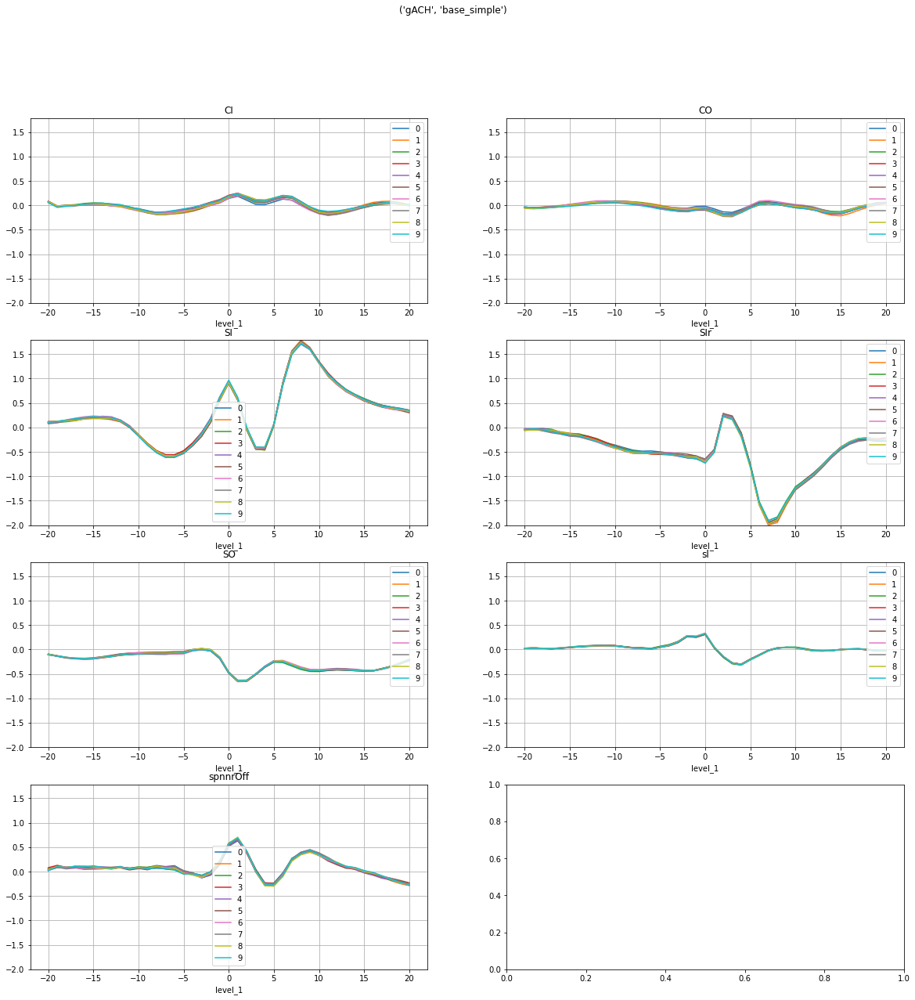

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_8_base_words_run_num__0  0.068658   
                                                   /gACH_0_8_base_words_run_num__1  0.084994   
                                                   /gACH_0_8_base_words_run_num__2  0.056623   
                                                   /gACH_0_8_base_words_run_num__3  0.081858   
                                                   /gACH_0_8_base_words_run_num__4  0.078335   
                                                   /gACH_0_8_base_words_run_num__5  0.079255   
                                                   /gACH_0_8_base_words_run_num__6  0.075856   
                                                   /gACH_0_8_base_words_run_num__7  0.074783   
                                                   /gACH_0_8_base_words_run_num__8  0.073716   
                                                   /gACH_0_8_base_words_run_num__9  0.054182   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_8_base_words_run_num__0 -0.018536   
                                                   /gACH_0_8_base_words_run_num__1 -0.012330   
                                                   /gACH_0_8_base_words_run_num__2 -0.019078   
                                                   /gACH_0_8_base_words_run_num__3 -0.017147   
                                                   /gACH_0_8_base_words_run_num__4 -0.020696   
                                                   /gACH_0_8_base_words_run_num__5 -0.009467   
                                                   /gACH_0_8_base_words_run_num__6 -0.012655   
                                                   /gACH_0_8_base_words_run_num__7 -0.022294   
                                                   /gACH_0_8_base_words_run_num__8 -0.009414   
                                                   /gACH_0_8_base_words_run_num__9 -0.039598   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_8_base_words_run_num__0  0.000416   
                                                   /gACH_0_8_base_words_run_num__1 -0.004869   
                                                   /gACH_0_8_base_words_run_num__2  0.011329   
                                                   /gACH_0_8_base_words_run_num__3 -0.000126   
                                                   /gACH_0_8_base_words_run_num__4 -0.001718   
                                                   /gACH_0_8_base_words_run_num__5  0.005359   
                                                   /gACH_0_8_base_words_run_num__6  0.000501   
                                                   /gACH_0_8_base_words_run_num__7 -0.008703   
                                                   /gACH_0_8_base_words_run_num__8  0.003335   
                                                   /gACH_0_8_base_words_run_num__9 -0.016765   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gAC

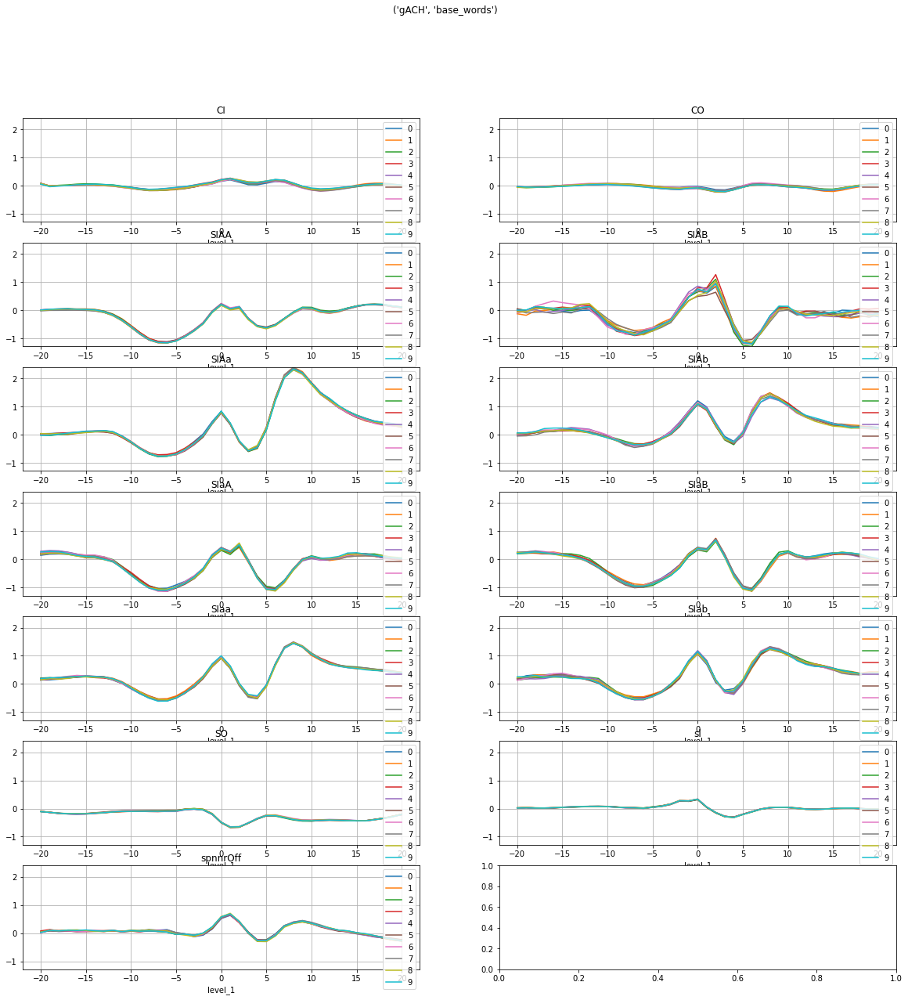

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_0_base_simple_run_num__0 -0.184970   
                                                   /rDA_1_0_base_simple_run_num__1 -0.158923   
                                                   /rDA_1_0_base_simple_run_num__2 -0.157453   
                                                   /rDA_1_0_base_simple_run_num__3 -0.166961   
                                                   /rDA_1_0_base_simple_run_num__4 -0.180635   
                                                   /rDA_1_0_base_simple_run_num__5 -0.140779   
                                                   /rDA_1_0_base_simple_run_num__6 -0.170781   
                                                   /rDA_1_0_base_simple_run_num__7 -0.155774   
                                                   /rDA_1_0_base_simple_run_num__8 -0.180306   
                                                   /rDA_1_0_base_simple_run_num__9 -0.168096   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_0_base_simple_run_num__0 -0.153276   
                                                   /rDA_1_0_base_simple_run_num__1 -0.165335   
                                                   /rDA_1_0_base_simple_run_num__2 -0.171447   
                                                   /rDA_1_0_base_simple_run_num__3 -0.142007   
                                                   /rDA_1_0_base_simple_run_num__4 -0.157532   
                                                   /rDA_1_0_base_simple_run_num__5 -0.118585   
                                                   /rDA_1_0_base_simple_run_num__6 -0.172161   
                                                   /rDA_1_0_base_simple_run_num__7 -0.162747   
                                                   /rDA_1_0_base_simple_run_num__8 -0.157911   
                                                   /rDA_1_0_base_simple_run_num__9 -0.165129   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_0_base_simple_run_num__0 -0.149709   
                                                   /rDA_1_0_base_simple_run_num__1 -0.159848   
                                                   /rDA_1_0_base_simple_run_num__2 -0.202921   
                                                   /rDA_1_0_base_simple_run_num__3 -0.160895   
                                                   /rDA_1_0_base_simple_run_num__4 -0.180428   
                                                   /rDA_1_0_base_simple_run_num__5 -0.097805   
                                                   /rDA_1_0_base_simple_run_num__6 -0.185671   
                                                   /rDA_1_0_base_simple_run_num__7 -0.164573   
                                                   /rDA_1_0_base_simple_run_num__8 -0.173855   
                                                   /rDA_1_0_base_simple_run_num__9 -0.172294   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA

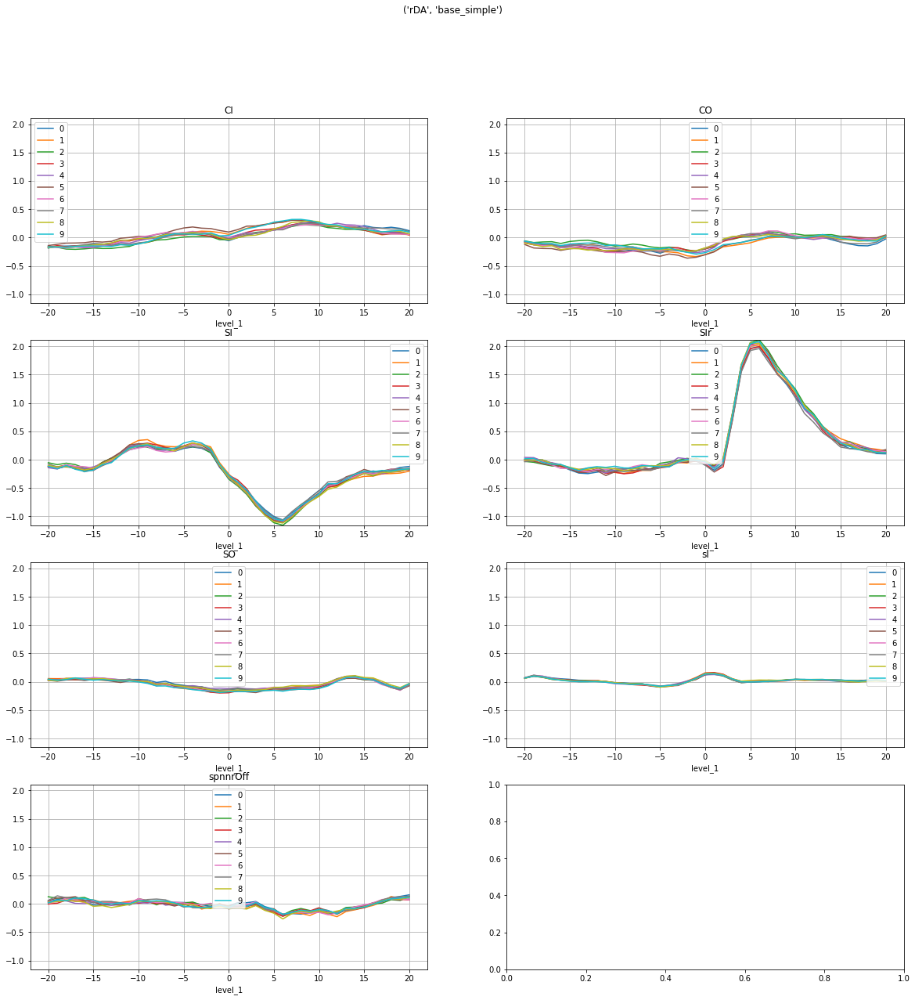

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_8_base_words_run_num__0 -0.185063   
                                                   /rDA_1_8_base_words_run_num__1 -0.159169   
                                                   /rDA_1_8_base_words_run_num__2 -0.159836   
                                                   /rDA_1_8_base_words_run_num__3 -0.168912   
                                                   /rDA_1_8_base_words_run_num__4 -0.180305   
                                                   /rDA_1_8_base_words_run_num__5 -0.147450   
                                                   /rDA_1_8_base_words_run_num__6 -0.170602   
                                                   /rDA_1_8_base_words_run_num__7 -0.157412   
                                                   /rDA_1_8_base_words_run_num__8 -0.186290   
                                                   /rDA_1_8_base_words_run_num__9 -0.171172   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_8_base_words_run_num__0 -0.151173   
                                                   /rDA_1_8_base_words_run_num__1 -0.161023   
                                                   /rDA_1_8_base_words_run_num__2 -0.175111   
                                                   /rDA_1_8_base_words_run_num__3 -0.142979   
                                                   /rDA_1_8_base_words_run_num__4 -0.157666   
                                                   /rDA_1_8_base_words_run_num__5 -0.128168   
                                                   /rDA_1_8_base_words_run_num__6 -0.168783   
                                                   /rDA_1_8_base_words_run_num__7 -0.163248   
                                                   /rDA_1_8_base_words_run_num__8 -0.164919   
                                                   /rDA_1_8_base_words_run_num__9 -0.171881   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_8_base_words_run_num__0 -0.146424   
                                                   /rDA_1_8_base_words_run_num__1 -0.153348   
                                                   /rDA_1_8_base_words_run_num__2 -0.209794   
                                                   /rDA_1_8_base_words_run_num__3 -0.162131   
                                                   /rDA_1_8_base_words_run_num__4 -0.182211   
                                                   /rDA_1_8_base_words_run_num__5 -0.111880   
                                                   /rDA_1_8_base_words_run_num__6 -0.180007   
                                                   /rDA_1_8_base_words_run_num__7 -0.164645   
                                                   /rDA_1_8_base_words_run_num__8 -0.184139   
                                                   /rDA_1_8_base_words_run_num__9 -0.181908   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_1_8_base_words_run_num__0 -0.141424   
 

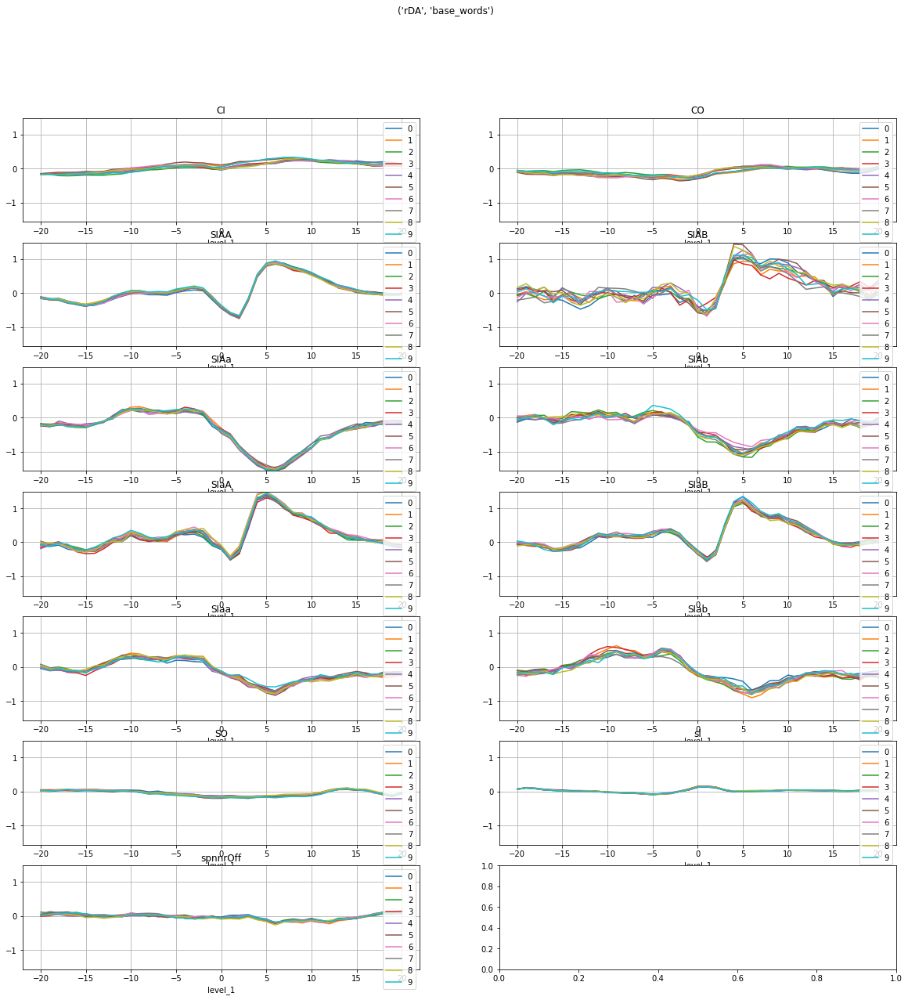

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_0_base_simple_run_num__0 -0.074019   
                                                   /gDA_2_0_base_simple_run_num__1 -0.094043   
                                                   /gDA_2_0_base_simple_run_num__2 -0.099615   
                                                   /gDA_2_0_base_simple_run_num__3 -0.098475   
                                                   /gDA_2_0_base_simple_run_num__4 -0.104987   
                                                   /gDA_2_0_base_simple_run_num__5 -0.073836   
                                                   /gDA_2_0_base_simple_run_num__6 -0.099260   
                                                   /gDA_2_0_base_simple_run_num__7 -0.099872   
                                                   /gDA_2_0_base_simple_run_num__8 -0.097039   
                                                   /gDA_2_0_base_simple_run_num__9 -0.112219   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_0_base_simple_run_num__0 -0.140872   
                                                   /gDA_2_0_base_simple_run_num__1 -0.186749   
                                                   /gDA_2_0_base_simple_run_num__2 -0.179304   
                                                   /gDA_2_0_base_simple_run_num__3 -0.168291   
                                                   /gDA_2_0_base_simple_run_num__4 -0.177869   
                                                   /gDA_2_0_base_simple_run_num__5 -0.161091   
                                                   /gDA_2_0_base_simple_run_num__6 -0.186825   
                                                   /gDA_2_0_base_simple_run_num__7 -0.190313   
                                                   /gDA_2_0_base_simple_run_num__8 -0.166213   
                                                   /gDA_2_0_base_simple_run_num__9 -0.203210   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_0_base_simple_run_num__0 -0.135820   
                                                   /gDA_2_0_base_simple_run_num__1 -0.184057   
                                                   /gDA_2_0_base_simple_run_num__2 -0.161252   
                                                   /gDA_2_0_base_simple_run_num__3 -0.144954   
                                                   /gDA_2_0_base_simple_run_num__4 -0.176860   
                                                   /gDA_2_0_base_simple_run_num__5 -0.163227   
                                                   /gDA_2_0_base_simple_run_num__6 -0.183214   
                                                   /gDA_2_0_base_simple_run_num__7 -0.205658   
                                                   /gDA_2_0_base_simple_run_num__8 -0.157689   
                                                   /gDA_2_0_base_simple_run_num__9 -0.208471   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

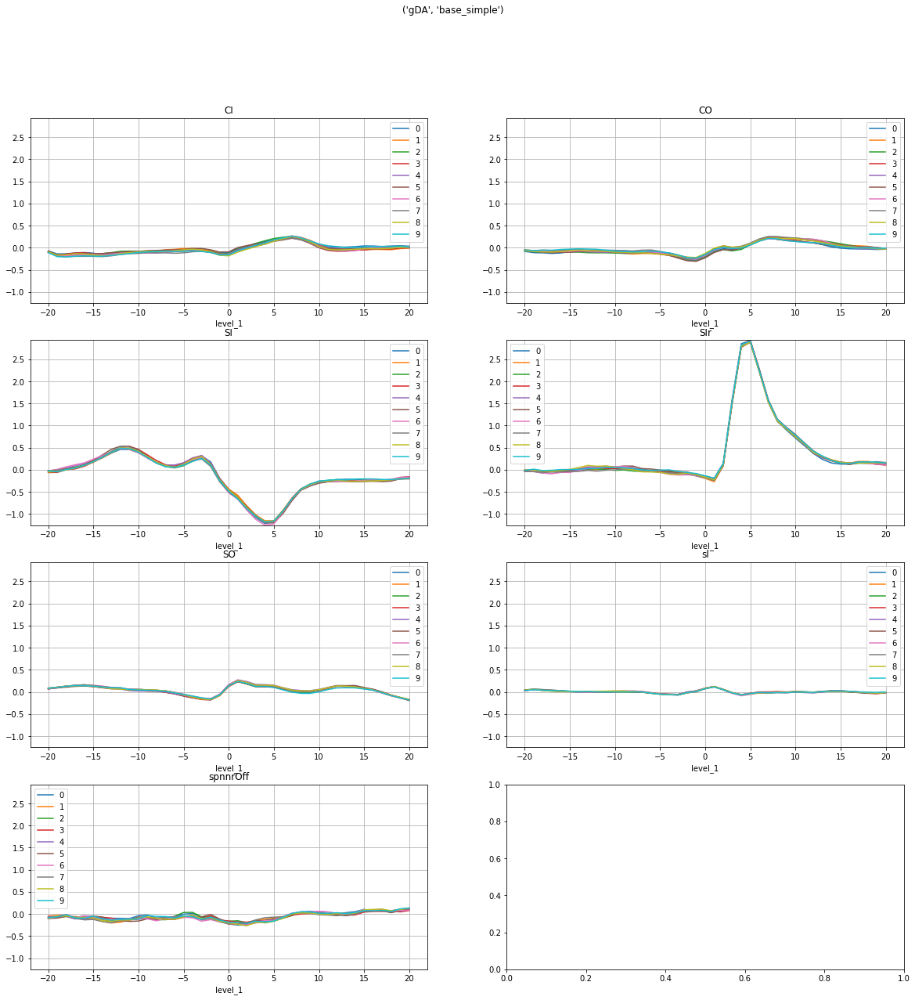

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_8_base_words_run_num__0 -0.076481   
                                                   /gDA_2_8_base_words_run_num__1 -0.098182   
                                                   /gDA_2_8_base_words_run_num__2 -0.100217   
                                                   /gDA_2_8_base_words_run_num__3 -0.097300   
                                                   /gDA_2_8_base_words_run_num__4 -0.104879   
                                                   /gDA_2_8_base_words_run_num__5 -0.074521   
                                                   /gDA_2_8_base_words_run_num__6 -0.098316   
                                                   /gDA_2_8_base_words_run_num__7 -0.100835   
                                                   /gDA_2_8_base_words_run_num__8 -0.099723   
                                                   /gDA_2_8_base_words_run_num__9 -0.113920   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_8_base_words_run_num__0 -0.142464   
                                                   /gDA_2_8_base_words_run_num__1 -0.188826   
                                                   /gDA_2_8_base_words_run_num__2 -0.178688   
                                                   /gDA_2_8_base_words_run_num__3 -0.165950   
                                                   /gDA_2_8_base_words_run_num__4 -0.176520   
                                                   /gDA_2_8_base_words_run_num__5 -0.158770   
                                                   /gDA_2_8_base_words_run_num__6 -0.181129   
                                                   /gDA_2_8_base_words_run_num__7 -0.190573   
                                                   /gDA_2_8_base_words_run_num__8 -0.171151   
                                                   /gDA_2_8_base_words_run_num__9 -0.204447   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_8_base_words_run_num__0 -0.137223   
                                                   /gDA_2_8_base_words_run_num__1 -0.187443   
                                                   /gDA_2_8_base_words_run_num__2 -0.160628   
                                                   /gDA_2_8_base_words_run_num__3 -0.141619   
                                                   /gDA_2_8_base_words_run_num__4 -0.176205   
                                                   /gDA_2_8_base_words_run_num__5 -0.160247   
                                                   /gDA_2_8_base_words_run_num__6 -0.175683   
                                                   /gDA_2_8_base_words_run_num__7 -0.206547   
                                                   /gDA_2_8_base_words_run_num__8 -0.163992   
                                                   /gDA_2_8_base_words_run_num__9 -0.210258   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_2_8_base_words_run_num__0 -0.120041   
 

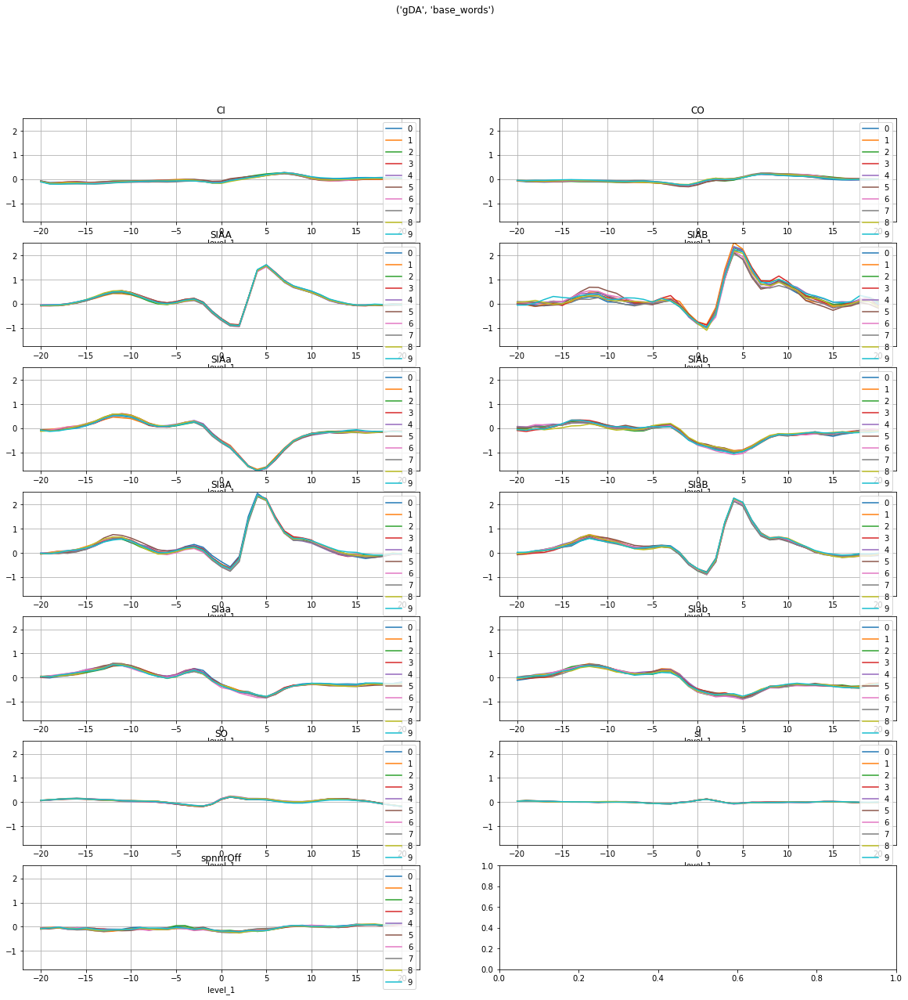

fig_folder ('Figure_3', 'f3*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_3\all\f3*-ft\coefs\*_best_coeffs.h5


gDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.009567   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.007958   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.007130   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.010806   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.008225   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.005908   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.013127   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.010418   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.013848   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.009259   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.005963   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.004597   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.004865   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.000385   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.003664   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.006692   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.006264   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.004936   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8 -0.000222   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.004382   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.004695   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.003938   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.002610   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.003048   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.003889   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.005097   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.002466   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.005822   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.008825   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.004641   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

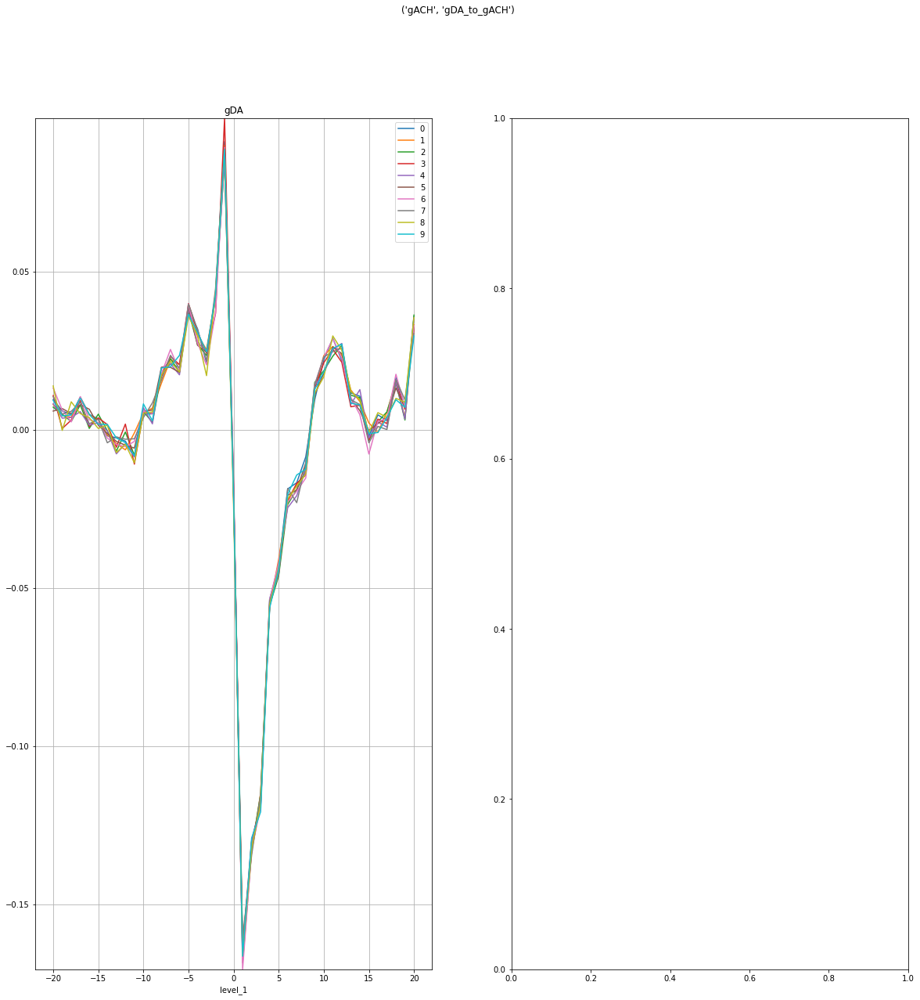

rDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.028710   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.024467   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.024331   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.025172   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.025394   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.023138   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.027300   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.023843   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.024475   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.028605   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.011742   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.009801   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.009305   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.008127   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.008999   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.009843   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.008555   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.009462   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.008485   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.011714   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.012177   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.012068   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.011765   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.013140   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.010396   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.015295   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.011470   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.012214   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.012256   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.013229   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

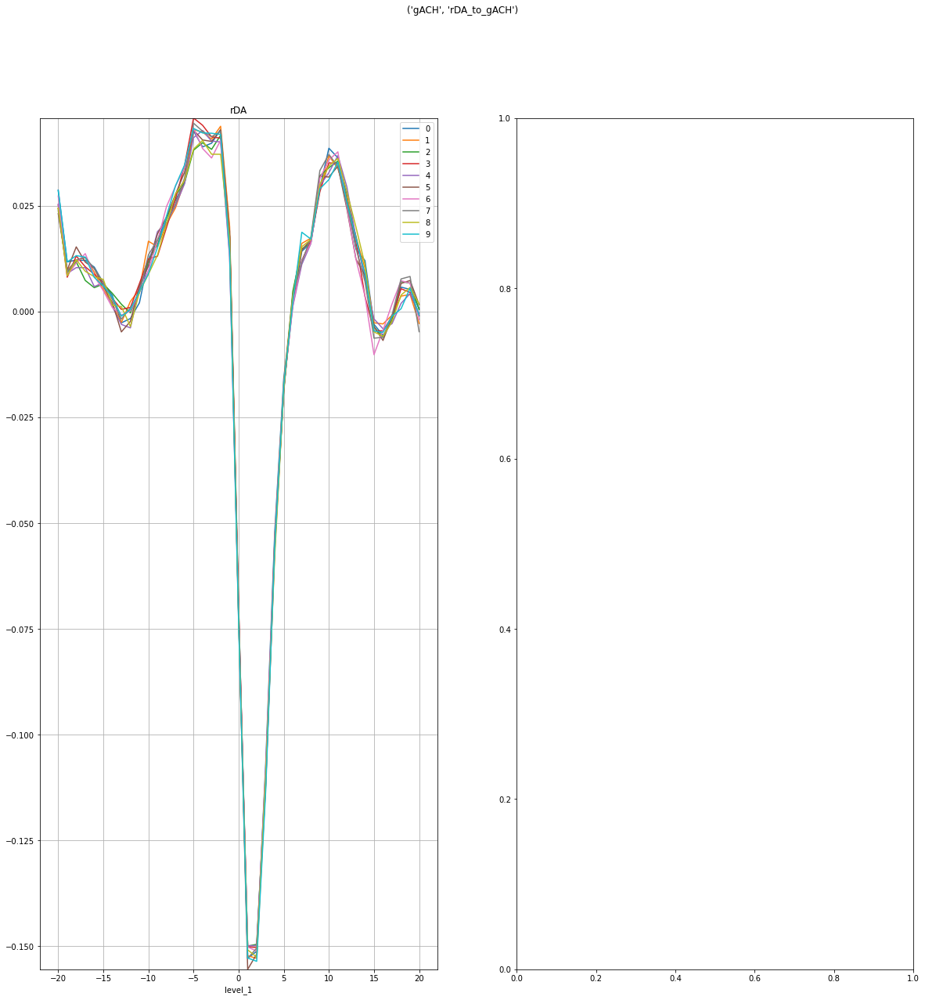

gDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.011066   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.009801   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.007231   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.014341   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.008639   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.010303   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.012900   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.010638   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8  0.012983   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9  0.010488   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.005153   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.003001   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.004202   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3 -0.000350   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.005229   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.005763   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.006256   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.004222   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8 -0.000182   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9  0.003984   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.005531   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.005337   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.004653   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.005423   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.007837   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.005899   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.002787   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.007071   
                                                   /gACH_0_2_base_s

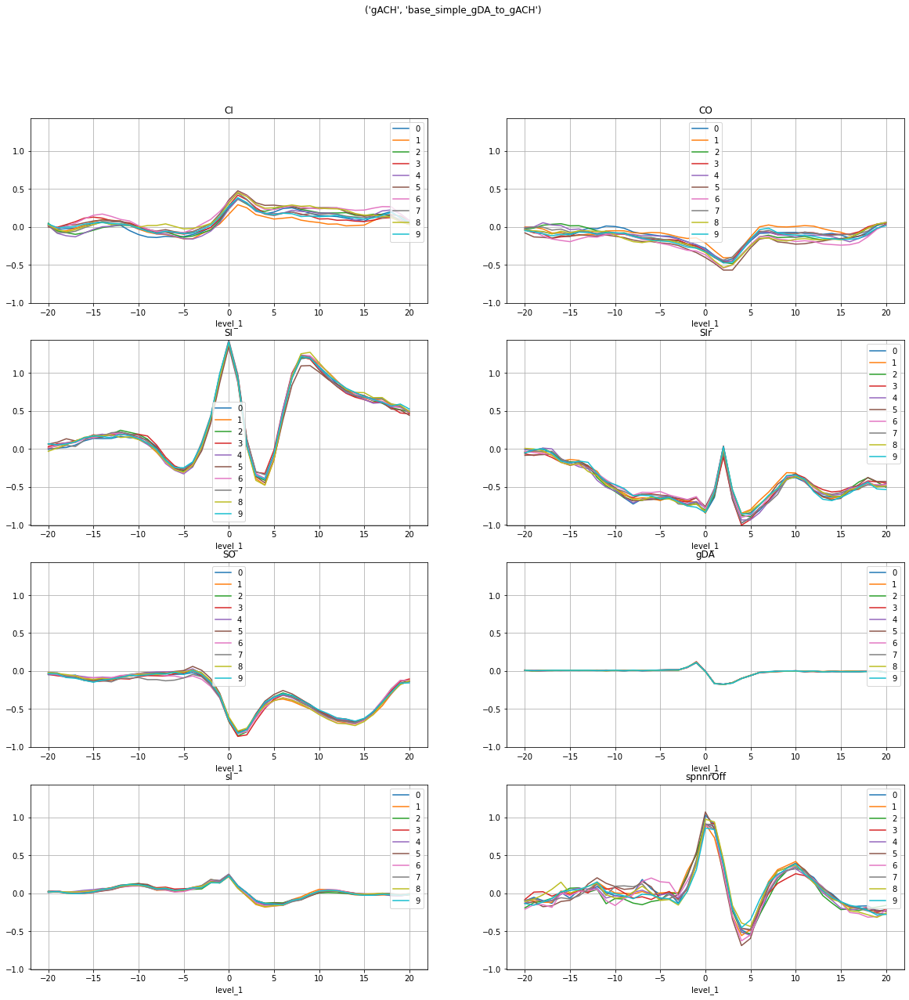

rDA  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.019827   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.015809   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__2  0.017113   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__3  0.020082   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__4  0.016360   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__5  0.018710   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__6  0.019742   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__7  0.017300   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__8  0.015760   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__9  0.020600   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.009276   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.007295

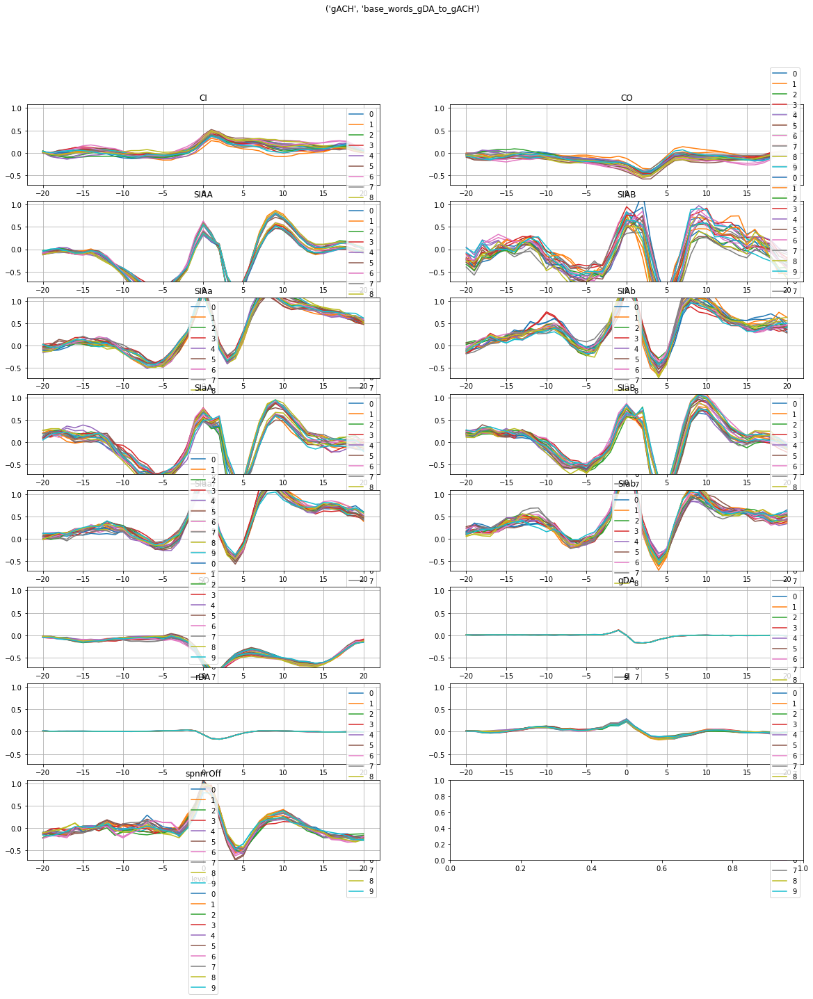

rDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.020876   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.017505   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.018027   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.021224   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.017579   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.019619   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.020530   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.017903   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.016917   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.021680   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.010241   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.008274   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.010379   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.009323   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.009390   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.010142   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.007976   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.009127   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.008701   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.011660   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.012414   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.010667   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.013049   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.013328   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.011052   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.014565   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.010486   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.011510   
                                                   /gACH_0_4_base_s

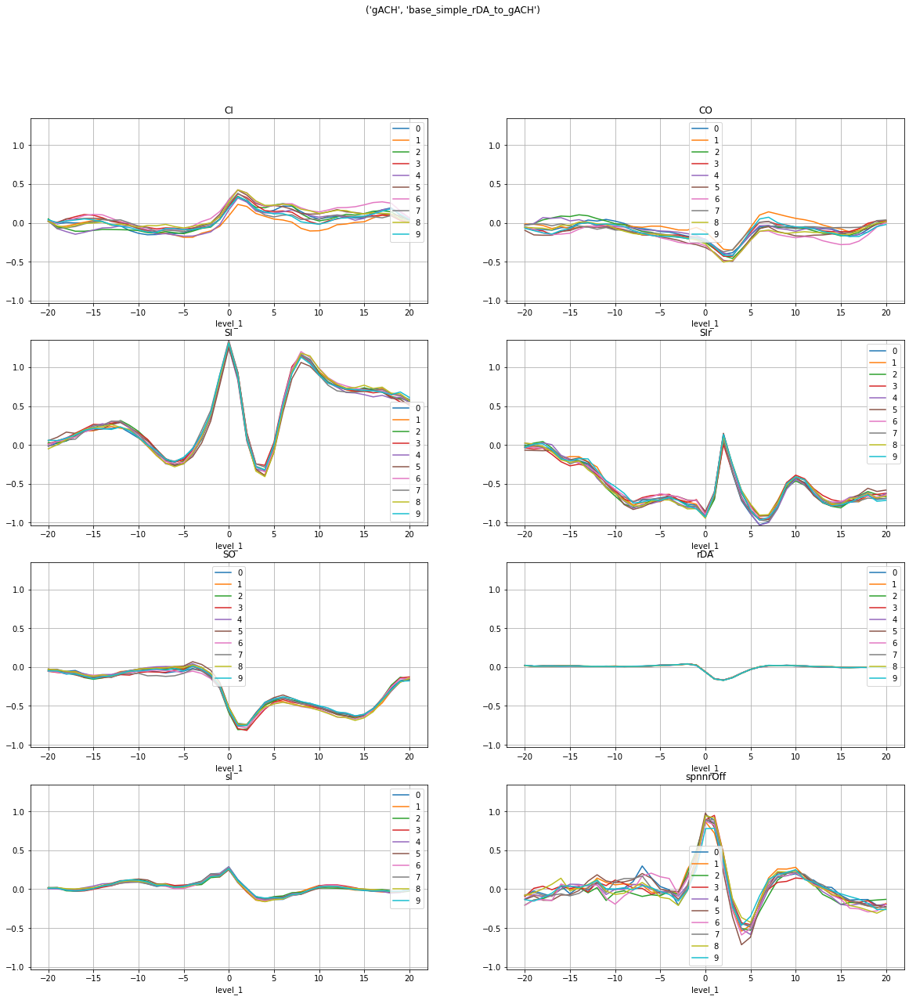

CI  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0  0.064818   
                                                   /gACH_0_6_base_simple_run_num__1  0.049717   
                                                   /gACH_0_6_base_simple_run_num__2  0.093051   
                                                   /gACH_0_6_base_simple_run_num__3  0.061161   
                                                   /gACH_0_6_base_simple_run_num__4  0.068922   
                                                   /gACH_0_6_base_simple_run_num__5  0.051133   
                                                   /gACH_0_6_base_simple_run_num__6  0.054723   
                                                   /gACH_0_6_base_simple_run_num__7  0.050491   
                                                   /gACH_0_6_base_simple_run_num__8  0.051102   
                                                   /gACH_0_6_base_simple_run_num__9  0.081034   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.034766   
                                                   /gACH_0_6_base_simple_run_num__1 -0.044660   
                                                   /gACH_0_6_base_simple_run_num__2 -0.044863   
                                                   /gACH_0_6_base_simple_run_num__3  0.025032   
                                                   /gACH_0_6_base_simple_run_num__4 -0.038737   
                                                   /gACH_0_6_base_simple_run_num__5  0.014460   
                                                   /gACH_0_6_base_simple_run_num__6 -0.007827   
                                                   /gACH_0_6_base_simple_run_num__7 -0.067773   
                                                   /gACH_0_6_base_simple_run_num__8 -0.036899   
                                                   /gACH_0_6_base_simple_run_num__9  0.010669   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.004063   
                                                   /gACH_0_6_base_simple_run_num__1 -0.010390   
                                                   /gACH_0_6_base_simple_run_num__2 -0.051958   
                                                   /gACH_0_6_base_simple_run_num__3  0.081259   
                                                   /gACH_0_6_base_simple_run_num__4 -0.049213   
                                                   /gACH_0_6_base_simple_run_num__5  0.086399   
                                                   /gACH_0_6_base_simple_run_num__6  0.049635   
                                                   /gACH_0_6_base_simple_run_num__7 -0.041010   
                                                   /gACH_0_6_base_simple_run_num__8 -0.044442   
                                                   /gACH_0_6_base_simple_run_num__9  0.054115   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh\

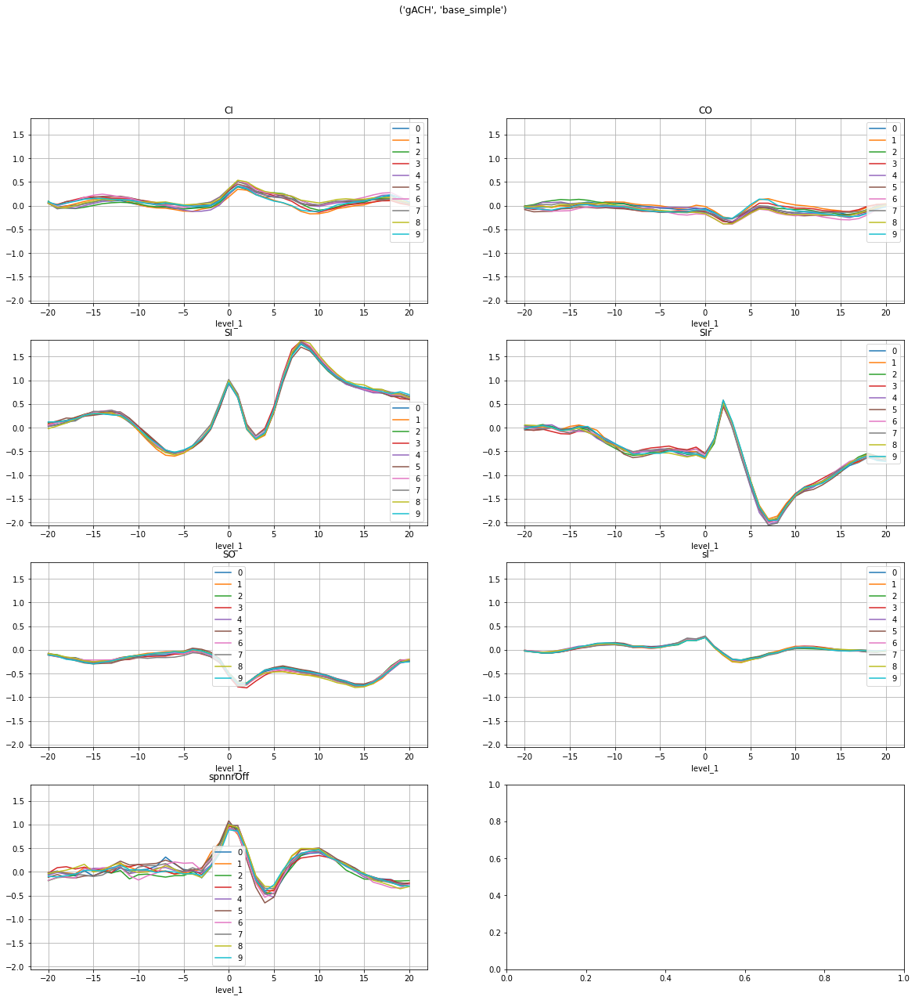

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0  0.065905   
                                                   /gACH_0_7_base_words_run_num__1  0.047644   
                                                   /gACH_0_7_base_words_run_num__2  0.089948   
                                                   /gACH_0_7_base_words_run_num__3  0.055983   
                                                   /gACH_0_7_base_words_run_num__4  0.062408   
                                                   /gACH_0_7_base_words_run_num__5  0.048851   
                                                   /gACH_0_7_base_words_run_num__6  0.047881   
                                                   /gACH_0_7_base_words_run_num__7  0.049015   
                                                   /gACH_0_7_base_words_run_num__8  0.049850   
                                                   /gACH_0_7_base_words_run_num__9  0.075632   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.028881   
                                                   /gACH_0_7_base_words_run_num__1 -0.036584   
                                                   /gACH_0_7_base_words_run_num__2 -0.042273   
                                                   /gACH_0_7_base_words_run_num__3  0.028207   
                                                   /gACH_0_7_base_words_run_num__4 -0.039338   
                                                   /gACH_0_7_base_words_run_num__5  0.020633   
                                                   /gACH_0_7_base_words_run_num__6 -0.008291   
                                                   /gACH_0_7_base_words_run_num__7 -0.063690   
                                                   /gACH_0_7_base_words_run_num__8 -0.024883   
                                                   /gACH_0_7_base_words_run_num__9  0.015808   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0  0.001486   
                                                   /gACH_0_7_base_words_run_num__1 -0.001511   
                                                   /gACH_0_7_base_words_run_num__2 -0.048176   
                                                   /gACH_0_7_base_words_run_num__3  0.084788   
                                                   /gACH_0_7_base_words_run_num__4 -0.047633   
                                                   /gACH_0_7_base_words_run_num__5  0.093599   
                                                   /gACH_0_7_base_words_run_num__6  0.047383   
                                                   /gACH_0_7_base_words_run_num__7 -0.036110   
                                                   /gACH_0_7_base_words_run_num__8 -0.028067   
                                                   /gACH_0_7_base_words_run_num__9  0.062076   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gAC

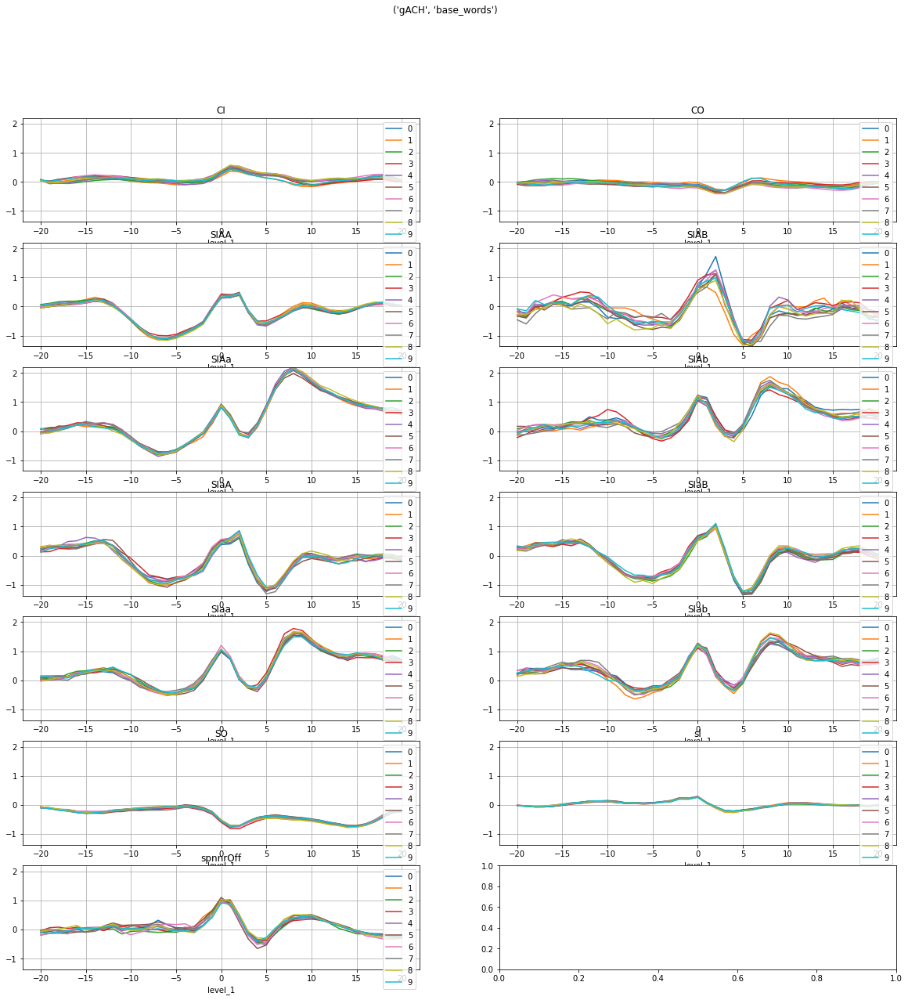

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.025502   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.026318   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.029357   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.023906   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.021539   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.028552   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.024831   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.028628   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.023304   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.021509   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.009390   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.011178   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.010218   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.013340   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.013390   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.010574   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.011437   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.005748   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.010983   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.018055   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.014544   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.015668   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.012882   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.015732   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.013384   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.015908   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.015507   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.012570   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.016941   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.016083   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /g

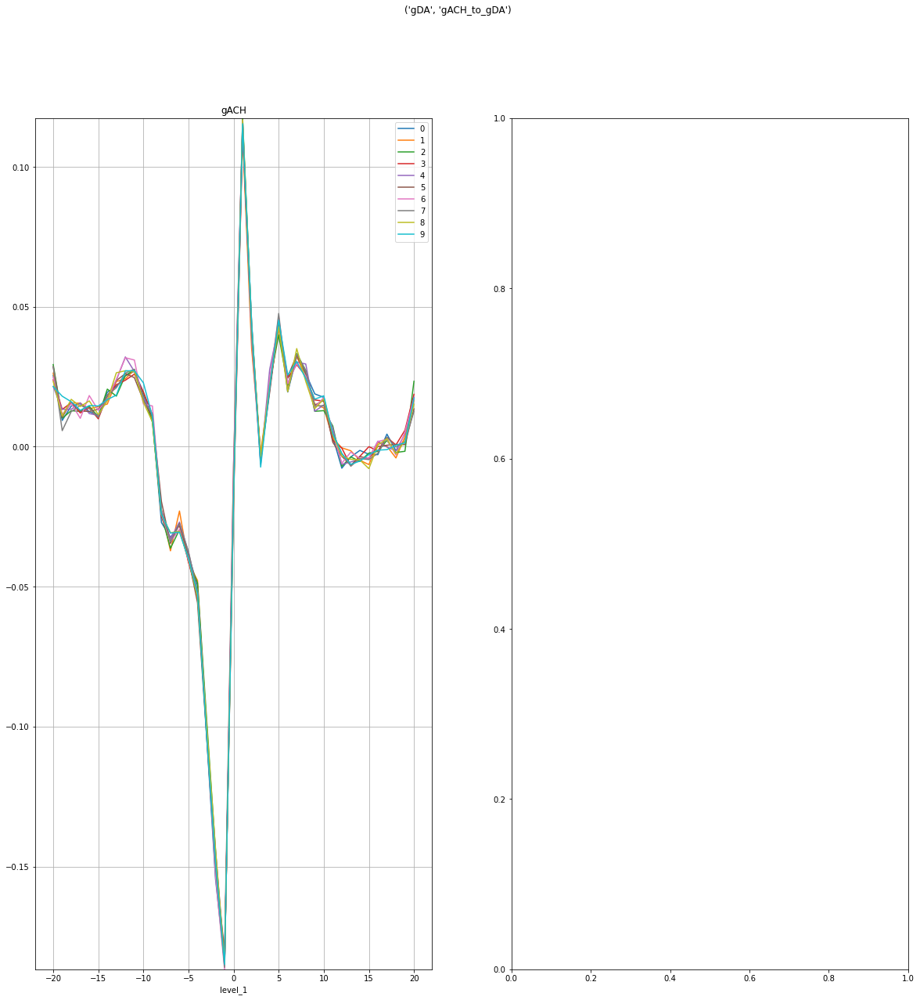

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.002547   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1 -0.003077   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.007017   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.001108   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4 -0.000407   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.001693   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6 -0.000307   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.004485   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8 -0.001628   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9 -0.000704   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.000446   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.001327   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.001298   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.003120   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.002528   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.000722   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6 -0.000055   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7 -0.005015   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.000828   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9  0.005880   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.002516   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.002164   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.000701   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.004059   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.000977   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.005993   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.003557   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.000849   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.0046

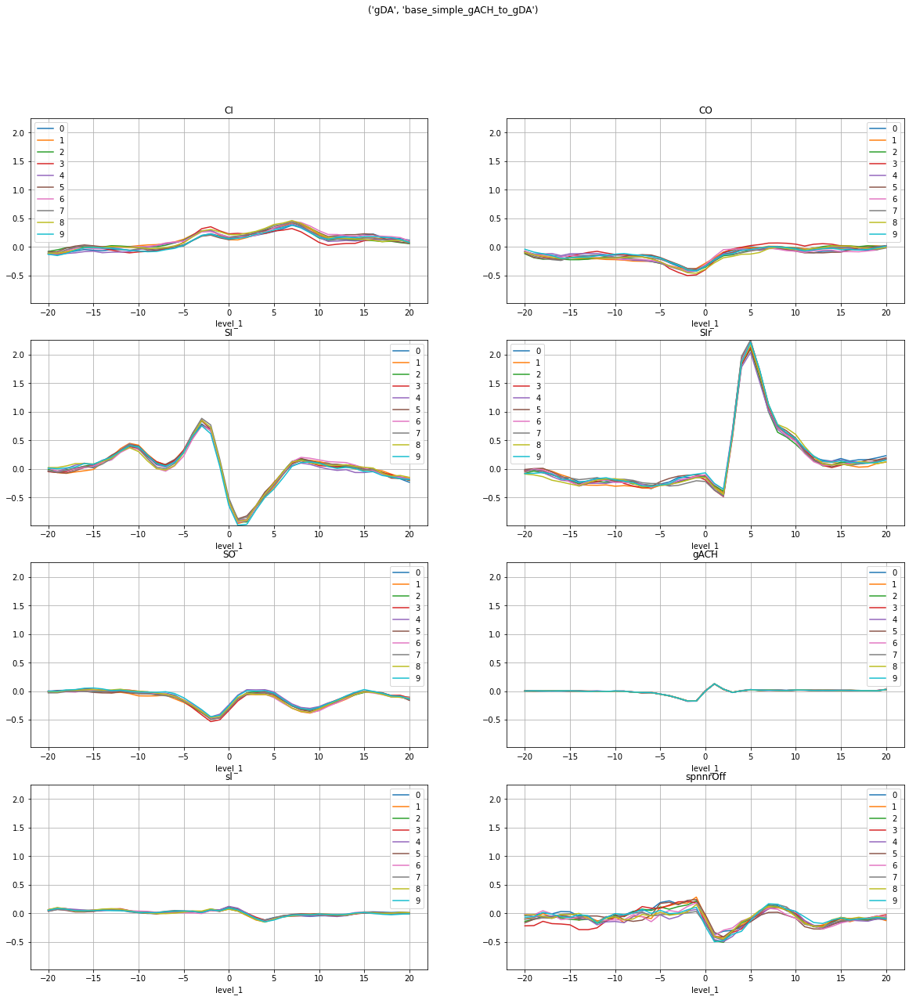

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.004514   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1 -0.001288   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.008356   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.003185   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.000832   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.003519   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.000991   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.006124   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8 -0.000601   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9  0.000974   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.000824   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.001633   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.002243   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.003224   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.003088   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.001233   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.000282   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7 -0.004535   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.001237   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9  0.006251   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.003098   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.003068   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.001869   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.004787   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.001592   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.006891   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.003961   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.001633   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.005581   
                               

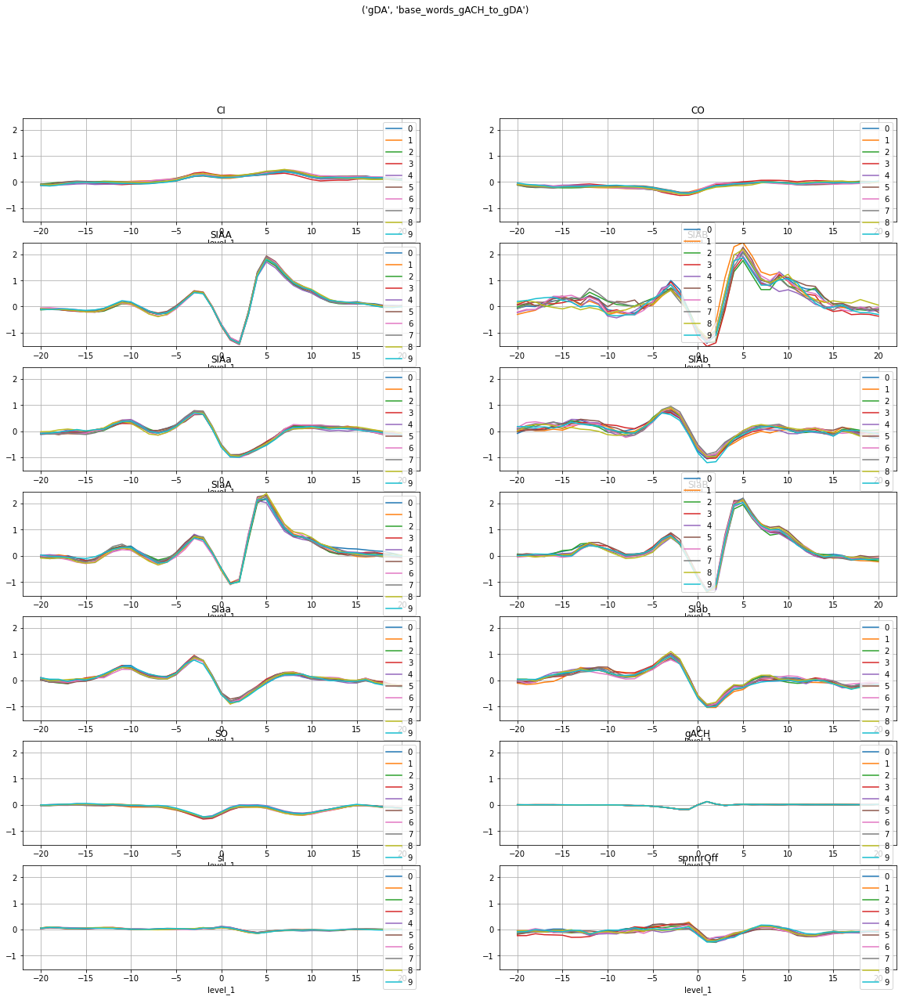

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.115810   
                                                   /gDA_1_3_base_simple_run_num__1 -0.126820   
                                                   /gDA_1_3_base_simple_run_num__2 -0.093842   
                                                   /gDA_1_3_base_simple_run_num__3 -0.122755   
                                                   /gDA_1_3_base_simple_run_num__4 -0.121396   
                                                   /gDA_1_3_base_simple_run_num__5 -0.075996   
                                                   /gDA_1_3_base_simple_run_num__6 -0.104806   
                                                   /gDA_1_3_base_simple_run_num__7 -0.094804   
                                                   /gDA_1_3_base_simple_run_num__8 -0.100182   
                                                   /gDA_1_3_base_simple_run_num__9 -0.115925   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.130716   
                                                   /gDA_1_3_base_simple_run_num__1 -0.176978   
                                                   /gDA_1_3_base_simple_run_num__2 -0.105059   
                                                   /gDA_1_3_base_simple_run_num__3 -0.152796   
                                                   /gDA_1_3_base_simple_run_num__4 -0.174356   
                                                   /gDA_1_3_base_simple_run_num__5 -0.115731   
                                                   /gDA_1_3_base_simple_run_num__6 -0.138316   
                                                   /gDA_1_3_base_simple_run_num__7 -0.150865   
                                                   /gDA_1_3_base_simple_run_num__8 -0.126019   
                                                   /gDA_1_3_base_simple_run_num__9 -0.178973   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.108249   
                                                   /gDA_1_3_base_simple_run_num__1 -0.170254   
                                                   /gDA_1_3_base_simple_run_num__2 -0.092475   
                                                   /gDA_1_3_base_simple_run_num__3 -0.108284   
                                                   /gDA_1_3_base_simple_run_num__4 -0.160872   
                                                   /gDA_1_3_base_simple_run_num__5 -0.063011   
                                                   /gDA_1_3_base_simple_run_num__6 -0.106864   
                                                   /gDA_1_3_base_simple_run_num__7 -0.110460   
                                                   /gDA_1_3_base_simple_run_num__8 -0.108991   
                                                   /gDA_1_3_base_simple_run_num__9 -0.163404   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

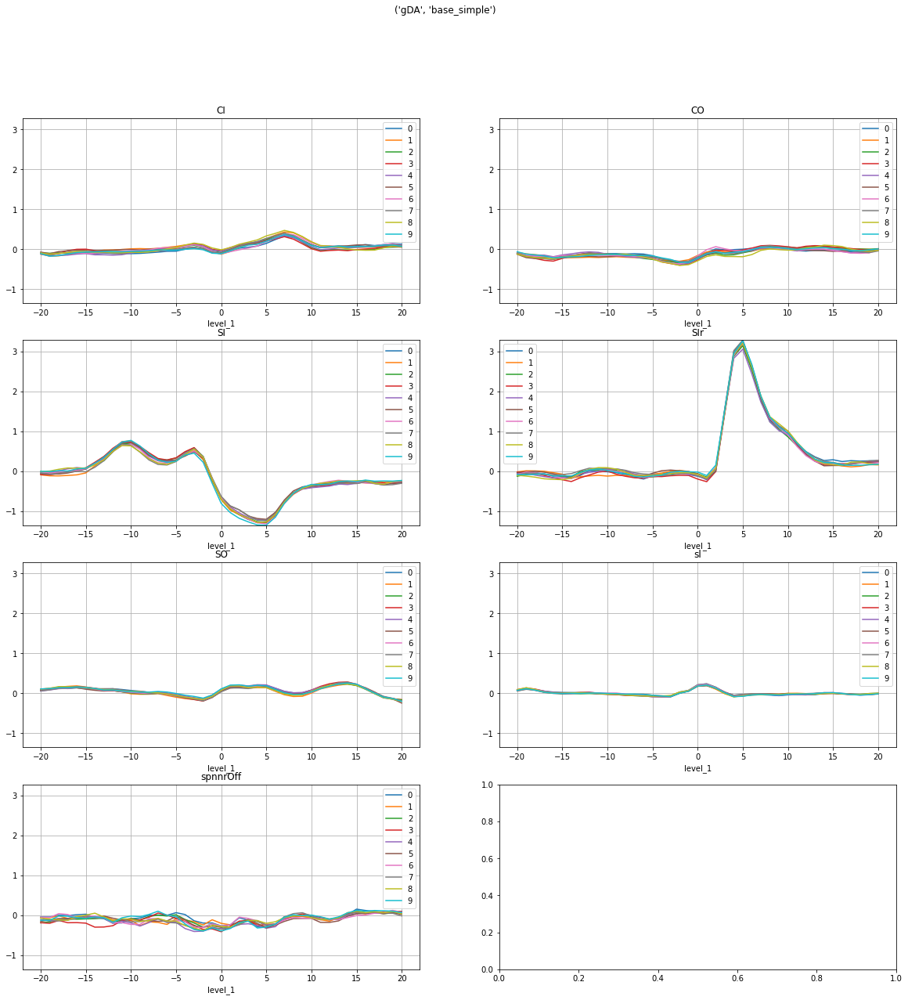

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.116113   
                                                   /gDA_1_4_base_words_run_num__1 -0.130441   
                                                   /gDA_1_4_base_words_run_num__2 -0.094972   
                                                   /gDA_1_4_base_words_run_num__3 -0.126849   
                                                   /gDA_1_4_base_words_run_num__4 -0.125328   
                                                   /gDA_1_4_base_words_run_num__5 -0.079669   
                                                   /gDA_1_4_base_words_run_num__6 -0.108420   
                                                   /gDA_1_4_base_words_run_num__7 -0.099924   
                                                   /gDA_1_4_base_words_run_num__8 -0.103219   
                                                   /gDA_1_4_base_words_run_num__9 -0.121833   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.128387   
                                                   /gDA_1_4_base_words_run_num__1 -0.179842   
                                                   /gDA_1_4_base_words_run_num__2 -0.104100   
                                                   /gDA_1_4_base_words_run_num__3 -0.157555   
                                                   /gDA_1_4_base_words_run_num__4 -0.177938   
                                                   /gDA_1_4_base_words_run_num__5 -0.119950   
                                                   /gDA_1_4_base_words_run_num__6 -0.145716   
                                                   /gDA_1_4_base_words_run_num__7 -0.155951   
                                                   /gDA_1_4_base_words_run_num__8 -0.134672   
                                                   /gDA_1_4_base_words_run_num__9 -0.187713   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.105231   
                                                   /gDA_1_4_base_words_run_num__1 -0.173493   
                                                   /gDA_1_4_base_words_run_num__2 -0.090763   
                                                   /gDA_1_4_base_words_run_num__3 -0.116080   
                                                   /gDA_1_4_base_words_run_num__4 -0.165182   
                                                   /gDA_1_4_base_words_run_num__5 -0.068687   
                                                   /gDA_1_4_base_words_run_num__6 -0.116137   
                                                   /gDA_1_4_base_words_run_num__7 -0.115638   
                                                   /gDA_1_4_base_words_run_num__8 -0.120362   
                                                   /gDA_1_4_base_words_run_num__9 -0.174486   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.094317   
 

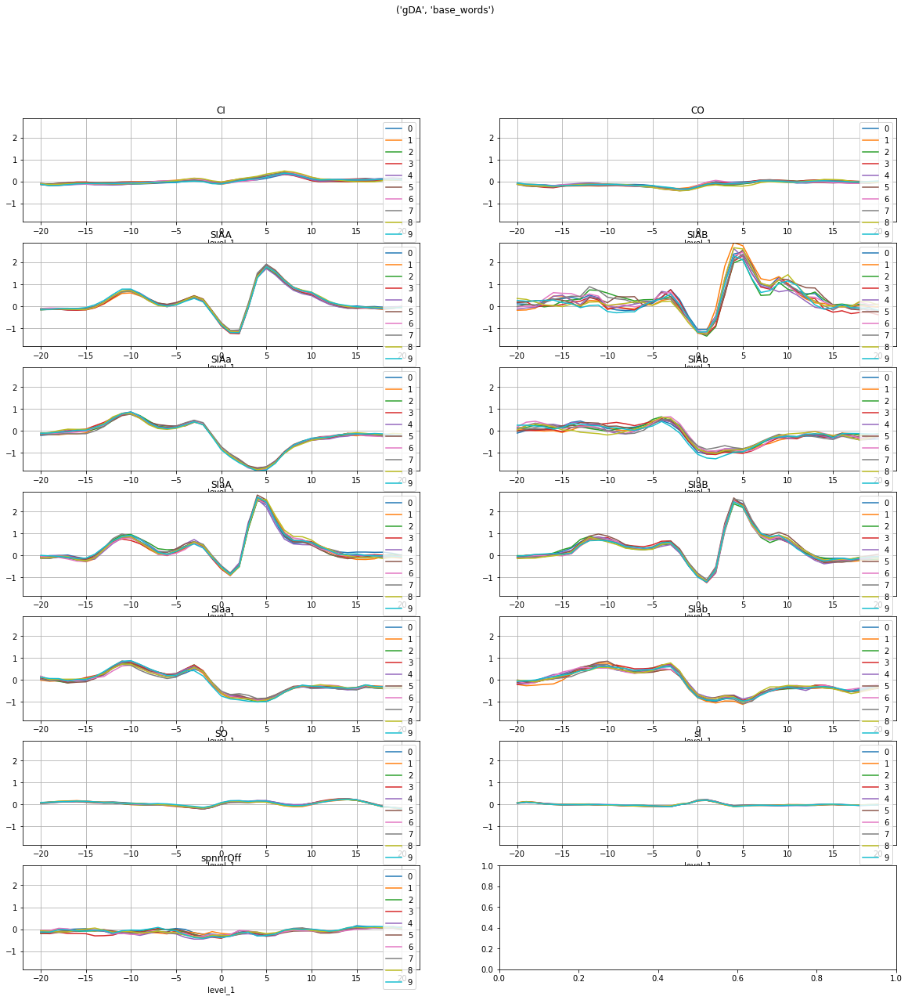

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.017298   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.018497   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.019901   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.020538   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.018989   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.018931   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.019381   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.017006   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.019302   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.018636   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.006572   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.004142   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.003280   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.003674   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.007374   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.004883   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.004828   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.006236   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.004670   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.004710   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.013987   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.012552   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.010311   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.011140   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.009611   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.010796   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.009807   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.007628   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.011850   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.010777   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /r

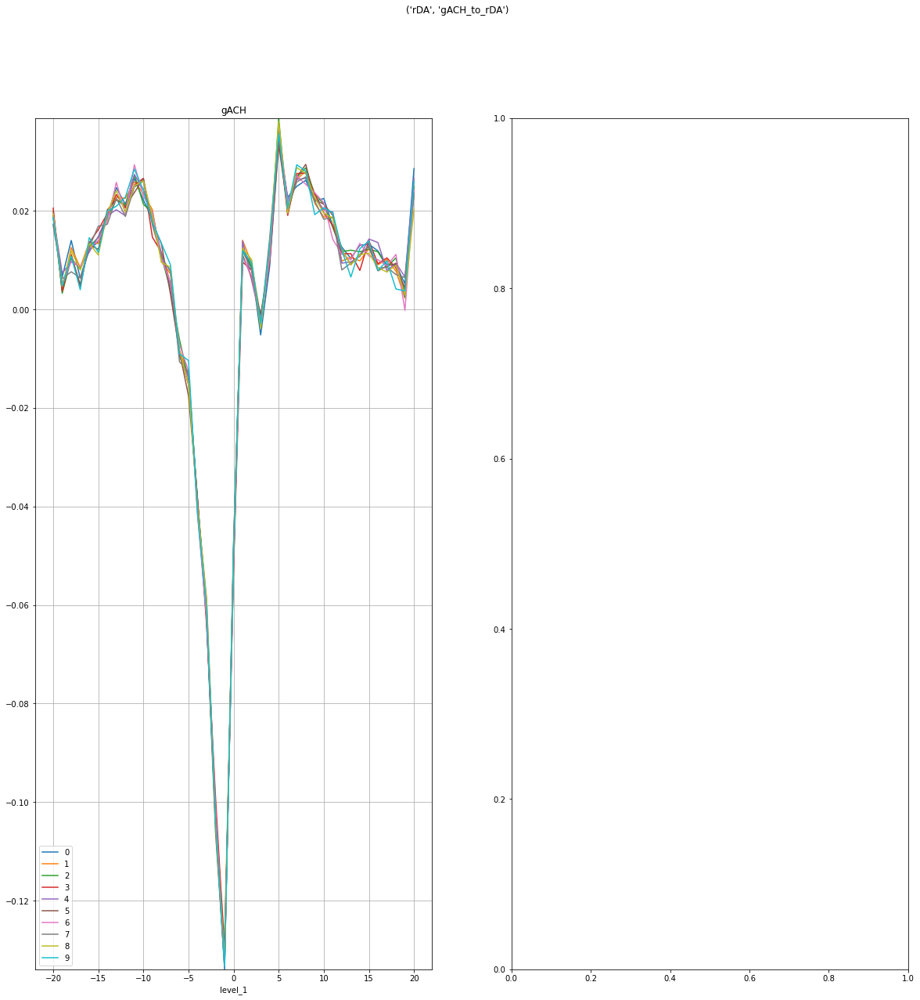

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.020774   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.023116   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.023954   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.023478   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.023135   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.024250   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.023840   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.022459   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.022496   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9  0.023811   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.005093   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.002090   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.002166   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.002136   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.005884   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.004066   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.003731   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.004880   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.003145   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9  0.003402   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.010908   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.008877   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.007096   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.008426   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.006674   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.008893   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.007547   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.004589   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.0086

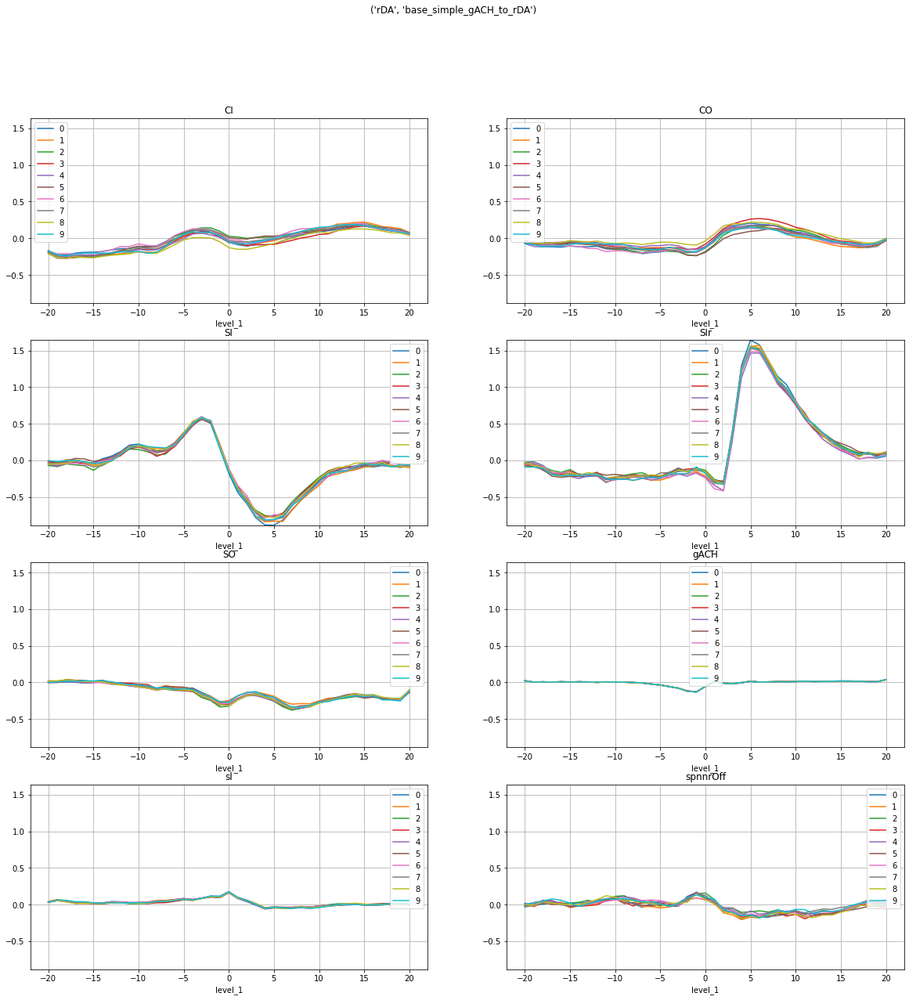

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.023162   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.025073   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.026013   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.025909   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.025312   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.026525   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.026181   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.024791   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.024531   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9  0.026042   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.005546   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.002757   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.002639   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.002693   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.006587   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.004624   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.004366   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.005502   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.003803   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9  0.004056   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.011721   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.009604   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.007907   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.009171   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.007620   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.009610   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.008221   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.005380   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.009406   
                               

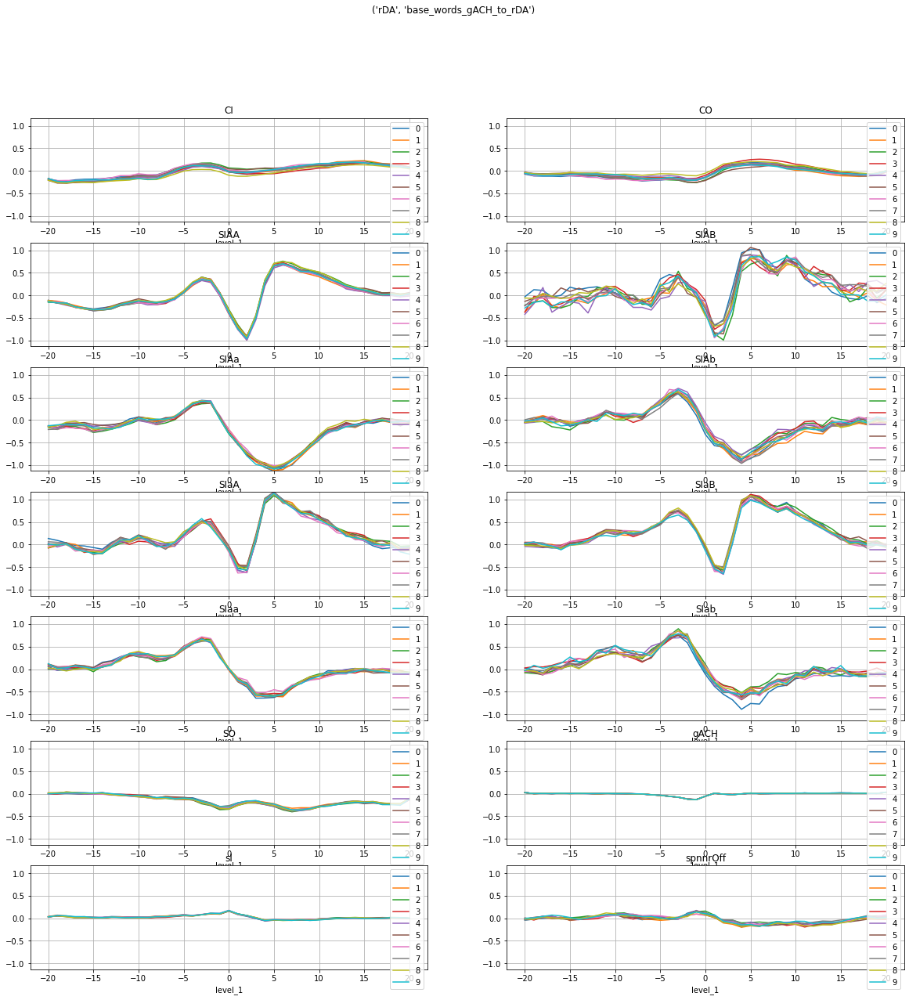

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.157835   
                                                   /rDA_2_3_base_simple_run_num__1 -0.159023   
                                                   /rDA_2_3_base_simple_run_num__2 -0.176044   
                                                   /rDA_2_3_base_simple_run_num__3 -0.151898   
                                                   /rDA_2_3_base_simple_run_num__4 -0.160749   
                                                   /rDA_2_3_base_simple_run_num__5 -0.193244   
                                                   /rDA_2_3_base_simple_run_num__6 -0.156659   
                                                   /rDA_2_3_base_simple_run_num__7 -0.161190   
                                                   /rDA_2_3_base_simple_run_num__8 -0.189267   
                                                   /rDA_2_3_base_simple_run_num__9 -0.147154   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.207146   
                                                   /rDA_2_3_base_simple_run_num__1 -0.238760   
                                                   /rDA_2_3_base_simple_run_num__2 -0.233321   
                                                   /rDA_2_3_base_simple_run_num__3 -0.239527   
                                                   /rDA_2_3_base_simple_run_num__4 -0.229399   
                                                   /rDA_2_3_base_simple_run_num__5 -0.272950   
                                                   /rDA_2_3_base_simple_run_num__6 -0.202700   
                                                   /rDA_2_3_base_simple_run_num__7 -0.247930   
                                                   /rDA_2_3_base_simple_run_num__8 -0.252039   
                                                   /rDA_2_3_base_simple_run_num__9 -0.209855   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.212691   
                                                   /rDA_2_3_base_simple_run_num__1 -0.268151   
                                                   /rDA_2_3_base_simple_run_num__2 -0.241865   
                                                   /rDA_2_3_base_simple_run_num__3 -0.262782   
                                                   /rDA_2_3_base_simple_run_num__4 -0.228750   
                                                   /rDA_2_3_base_simple_run_num__5 -0.281650   
                                                   /rDA_2_3_base_simple_run_num__6 -0.192603   
                                                   /rDA_2_3_base_simple_run_num__7 -0.266304   
                                                   /rDA_2_3_base_simple_run_num__8 -0.258825   
                                                   /rDA_2_3_base_simple_run_num__9 -0.217162   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA

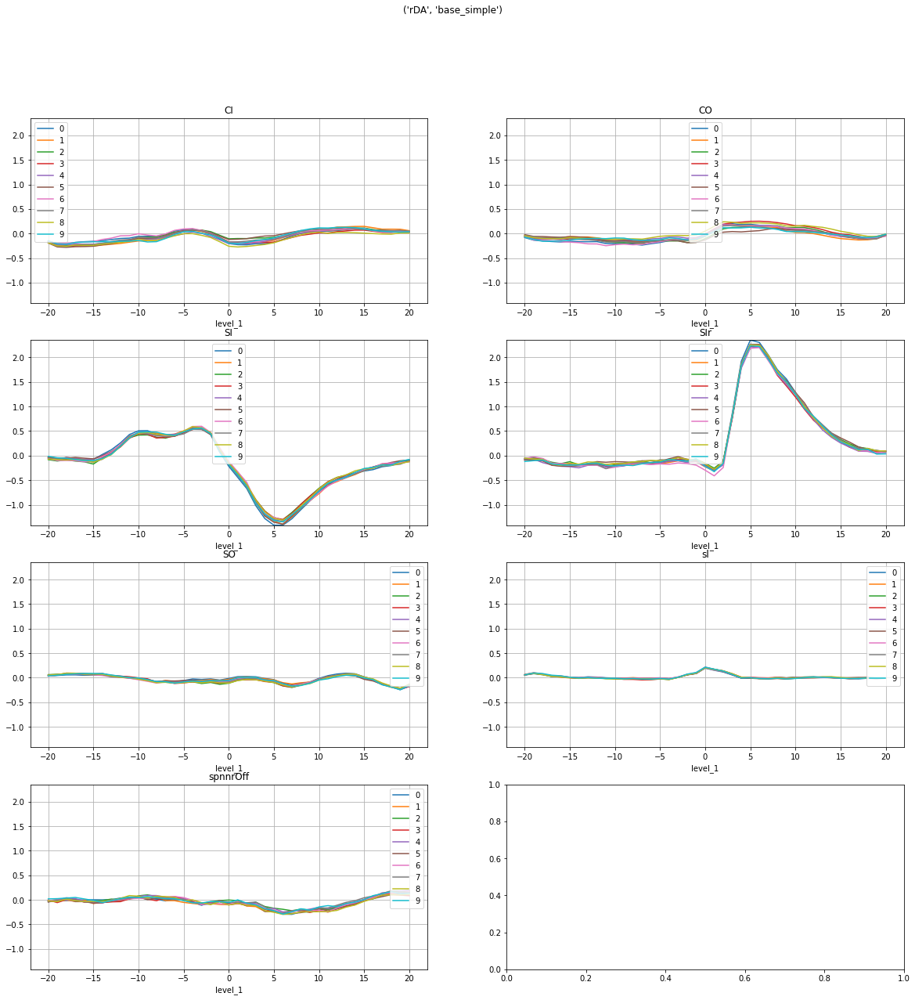

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.161634   
                                                   /rDA_2_4_base_words_run_num__1 -0.162604   
                                                   /rDA_2_4_base_words_run_num__2 -0.178261   
                                                   /rDA_2_4_base_words_run_num__3 -0.154599   
                                                   /rDA_2_4_base_words_run_num__4 -0.165139   
                                                   /rDA_2_4_base_words_run_num__5 -0.196551   
                                                   /rDA_2_4_base_words_run_num__6 -0.161843   
                                                   /rDA_2_4_base_words_run_num__7 -0.164925   
                                                   /rDA_2_4_base_words_run_num__8 -0.191251   
                                                   /rDA_2_4_base_words_run_num__9 -0.151521   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.203740   
                                                   /rDA_2_4_base_words_run_num__1 -0.238634   
                                                   /rDA_2_4_base_words_run_num__2 -0.226491   
                                                   /rDA_2_4_base_words_run_num__3 -0.233899   
                                                   /rDA_2_4_base_words_run_num__4 -0.228359   
                                                   /rDA_2_4_base_words_run_num__5 -0.270479   
                                                   /rDA_2_4_base_words_run_num__6 -0.203958   
                                                   /rDA_2_4_base_words_run_num__7 -0.243886   
                                                   /rDA_2_4_base_words_run_num__8 -0.246711   
                                                   /rDA_2_4_base_words_run_num__9 -0.211587   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.208722   
                                                   /rDA_2_4_base_words_run_num__1 -0.269200   
                                                   /rDA_2_4_base_words_run_num__2 -0.232629   
                                                   /rDA_2_4_base_words_run_num__3 -0.254653   
                                                   /rDA_2_4_base_words_run_num__4 -0.228456   
                                                   /rDA_2_4_base_words_run_num__5 -0.278834   
                                                   /rDA_2_4_base_words_run_num__6 -0.194528   
                                                   /rDA_2_4_base_words_run_num__7 -0.261959   
                                                   /rDA_2_4_base_words_run_num__8 -0.251400   
                                                   /rDA_2_4_base_words_run_num__9 -0.220954   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.176171   
 

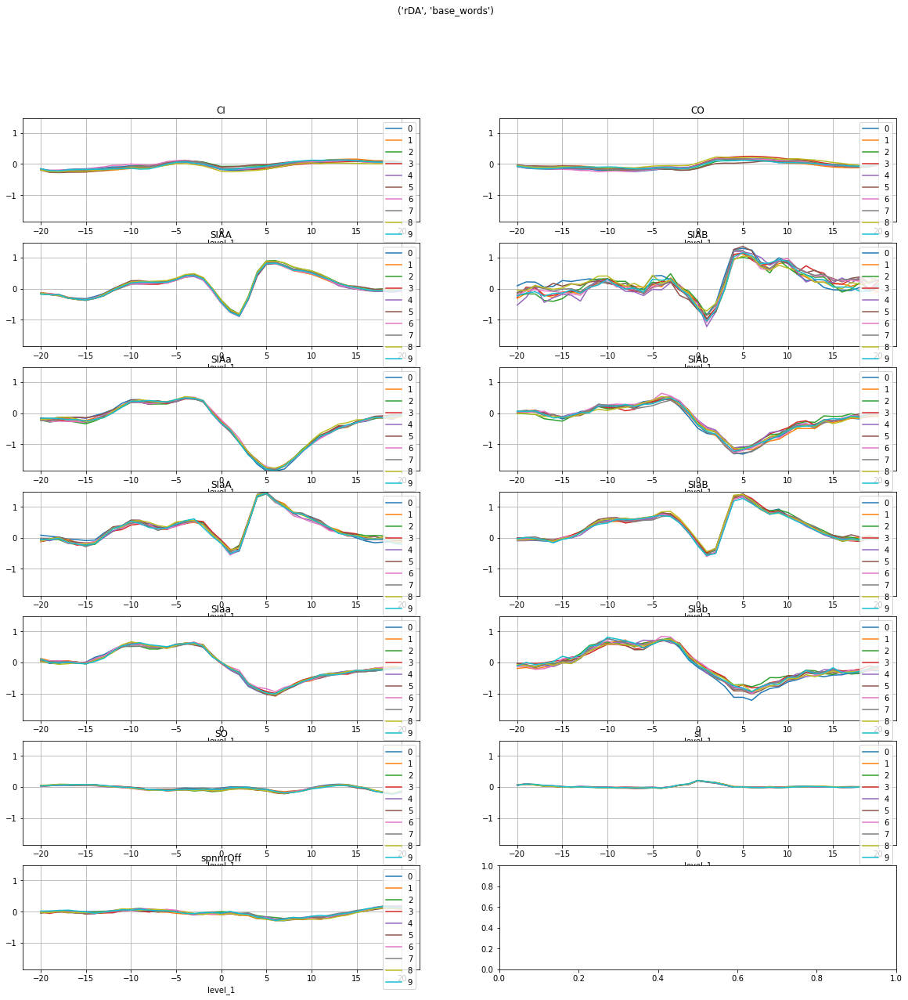

fig_folder ('Figure_4_g1', 'f4*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_4_g1\all\f4*-ft\coefs\*_best_coeffs.h5


CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_0_base_simple_run_num__0 -0.120379   
                                                   /gDA_0_0_base_simple_run_num__1 -0.131904   
                                                   /gDA_0_0_base_simple_run_num__2 -0.116359   
                                                   /gDA_0_0_base_simple_run_num__3 -0.124076   
                                                   /gDA_0_0_base_simple_run_num__4 -0.117717   
                                                   /gDA_0_0_base_simple_run_num__5 -0.105216   
                                                   /gDA_0_0_base_simple_run_num__6 -0.124161   
                                                   /gDA_0_0_base_simple_run_num__7 -0.111375   
                                                   /gDA_0_0_base_simple_run_num__8 -0.113133   
                                                   /gDA_0_0_base_simple_run_num__9 -0.124579   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_0_base_simple_run_num__0 -0.210549   
                                                   /gDA_0_0_base_simple_run_num__1 -0.214397   
                                                   /gDA_0_0_base_simple_run_num__2 -0.215391   
                                                   /gDA_0_0_base_simple_run_num__3 -0.200903   
                                                   /gDA_0_0_base_simple_run_num__4 -0.222456   
                                                   /gDA_0_0_base_simple_run_num__5 -0.215994   
                                                   /gDA_0_0_base_simple_run_num__6 -0.233556   
                                                   /gDA_0_0_base_simple_run_num__7 -0.222144   
                                                   /gDA_0_0_base_simple_run_num__8 -0.210595   
                                                   /gDA_0_0_base_simple_run_num__9 -0.231824   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_0_base_simple_run_num__0 -0.179329   
                                                   /gDA_0_0_base_simple_run_num__1 -0.171051   
                                                   /gDA_0_0_base_simple_run_num__2 -0.178307   
                                                   /gDA_0_0_base_simple_run_num__3 -0.169902   
                                                   /gDA_0_0_base_simple_run_num__4 -0.180335   
                                                   /gDA_0_0_base_simple_run_num__5 -0.180853   
                                                   /gDA_0_0_base_simple_run_num__6 -0.188919   
                                                   /gDA_0_0_base_simple_run_num__7 -0.191645   
                                                   /gDA_0_0_base_simple_run_num__8 -0.185552   
                                                   /gDA_0_0_base_simple_run_num__9 -0.184074   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

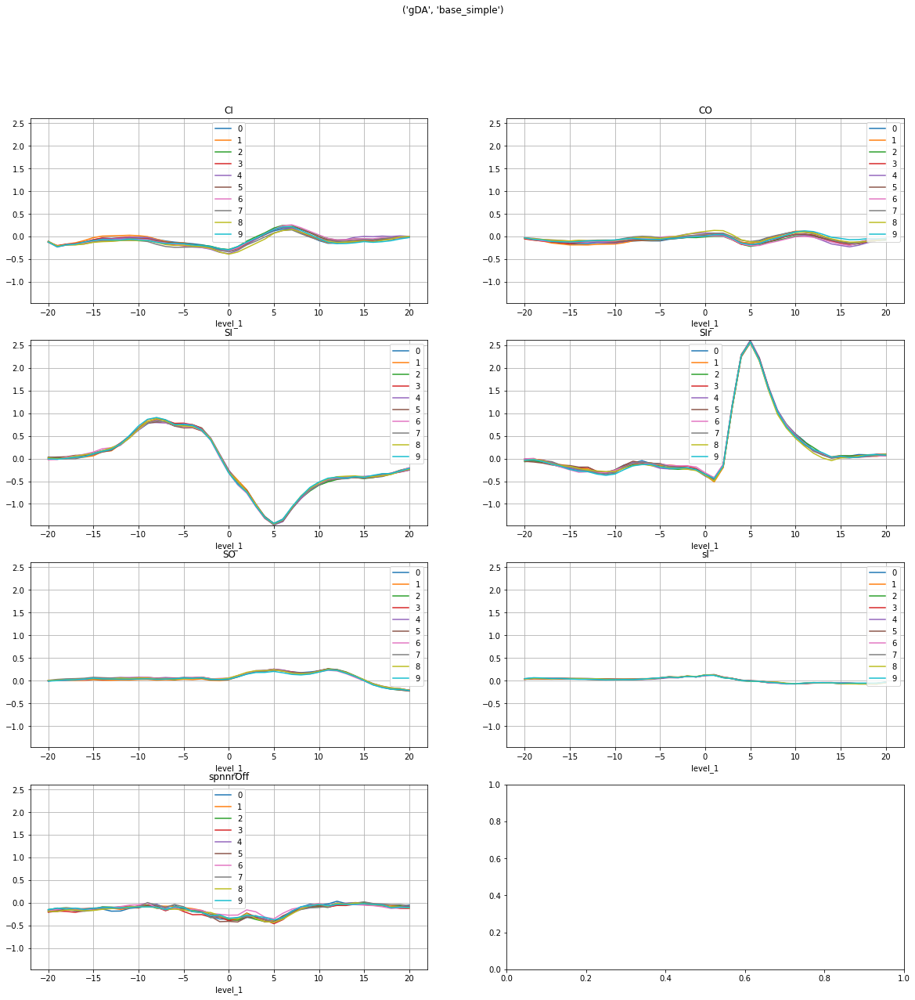

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.127474   
                                                   /gDA_0_1_base_words_run_num__1 -0.136380   
                                                   /gDA_0_1_base_words_run_num__2 -0.123484   
                                                   /gDA_0_1_base_words_run_num__3 -0.131539   
                                                   /gDA_0_1_base_words_run_num__4 -0.124259   
                                                   /gDA_0_1_base_words_run_num__5 -0.112731   
                                                   /gDA_0_1_base_words_run_num__6 -0.130643   
                                                   /gDA_0_1_base_words_run_num__7 -0.119028   
                                                   /gDA_0_1_base_words_run_num__8 -0.119946   
                                                   /gDA_0_1_base_words_run_num__9 -0.130095   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.206081   
                                                   /gDA_0_1_base_words_run_num__1 -0.208188   
                                                   /gDA_0_1_base_words_run_num__2 -0.210633   
                                                   /gDA_0_1_base_words_run_num__3 -0.198648   
                                                   /gDA_0_1_base_words_run_num__4 -0.218196   
                                                   /gDA_0_1_base_words_run_num__5 -0.212431   
                                                   /gDA_0_1_base_words_run_num__6 -0.227019   
                                                   /gDA_0_1_base_words_run_num__7 -0.221089   
                                                   /gDA_0_1_base_words_run_num__8 -0.210095   
                                                   /gDA_0_1_base_words_run_num__9 -0.226484   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.174178   
                                                   /gDA_0_1_base_words_run_num__1 -0.164373   
                                                   /gDA_0_1_base_words_run_num__2 -0.173331   
                                                   /gDA_0_1_base_words_run_num__3 -0.167885   
                                                   /gDA_0_1_base_words_run_num__4 -0.175193   
                                                   /gDA_0_1_base_words_run_num__5 -0.177182   
                                                   /gDA_0_1_base_words_run_num__6 -0.181150   
                                                   /gDA_0_1_base_words_run_num__7 -0.191798   
                                                   /gDA_0_1_base_words_run_num__8 -0.186418   
                                                   /gDA_0_1_base_words_run_num__9 -0.178876   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.152024   
 

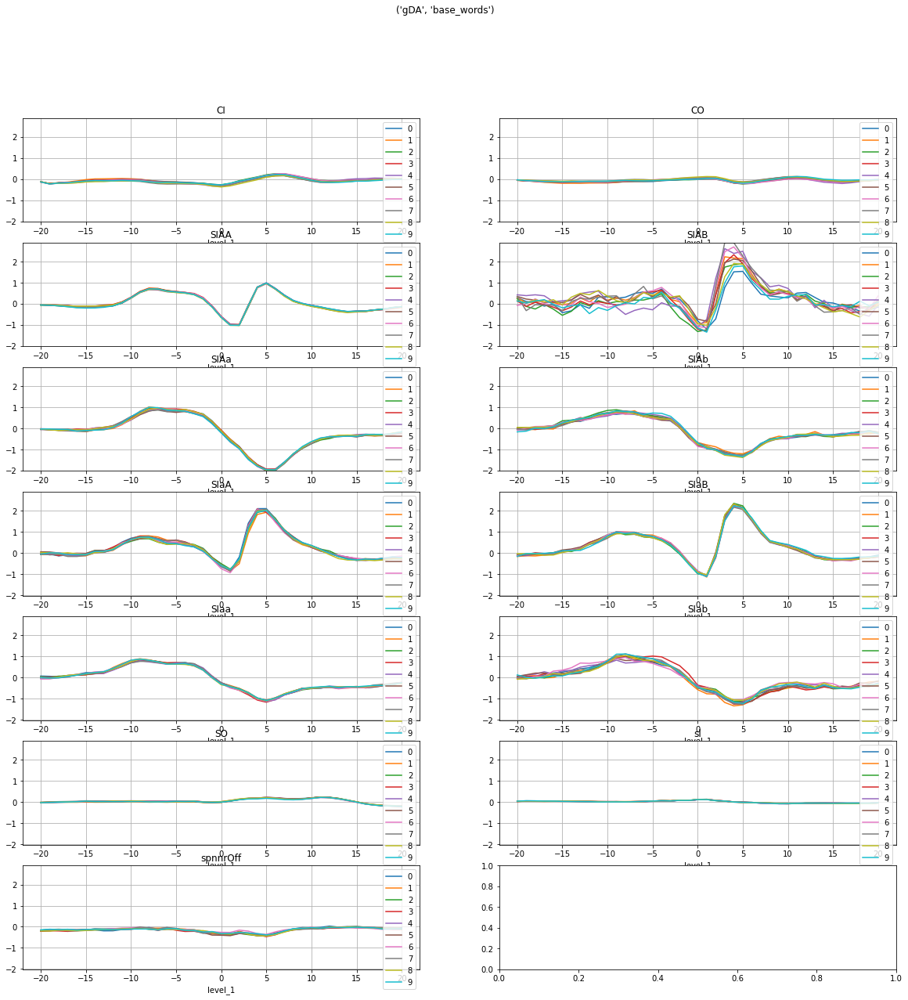

fig_folder ('Figure_4_g2', 'f4*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_4_g2\all\f4*-ft\coefs\*_best_coeffs.h5


CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_0_base_simple_run_num__0 -0.112582   
                                                   /gDA_0_0_base_simple_run_num__1 -0.118138   
                                                   /gDA_0_0_base_simple_run_num__2 -0.107468   
                                                   /gDA_0_0_base_simple_run_num__3 -0.116599   
                                                   /gDA_0_0_base_simple_run_num__4 -0.105709   
                                                   /gDA_0_0_base_simple_run_num__5 -0.088604   
                                                   /gDA_0_0_base_simple_run_num__6 -0.089782   
                                                   /gDA_0_0_base_simple_run_num__7 -0.110088   
                                                   /gDA_0_0_base_simple_run_num__8 -0.112744   
                                                   /gDA_0_0_base_simple_run_num__9 -0.086259   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_0_base_simple_run_num__0 -0.092376   
                                                   /gDA_0_0_base_simple_run_num__1 -0.121998   
                                                   /gDA_0_0_base_simple_run_num__2 -0.102097   
                                                   /gDA_0_0_base_simple_run_num__3 -0.115190   
                                                   /gDA_0_0_base_simple_run_num__4 -0.107748   
                                                   /gDA_0_0_base_simple_run_num__5 -0.091647   
                                                   /gDA_0_0_base_simple_run_num__6 -0.107889   
                                                   /gDA_0_0_base_simple_run_num__7 -0.094706   
                                                   /gDA_0_0_base_simple_run_num__8 -0.112955   
                                                   /gDA_0_0_base_simple_run_num__9 -0.106361   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_0_base_simple_run_num__0 -0.060328   
                                                   /gDA_0_0_base_simple_run_num__1 -0.105051   
                                                   /gDA_0_0_base_simple_run_num__2 -0.086748   
                                                   /gDA_0_0_base_simple_run_num__3 -0.078665   
                                                   /gDA_0_0_base_simple_run_num__4 -0.093891   
                                                   /gDA_0_0_base_simple_run_num__5 -0.069233   
                                                   /gDA_0_0_base_simple_run_num__6 -0.083729   
                                                   /gDA_0_0_base_simple_run_num__7 -0.090017   
                                                   /gDA_0_0_base_simple_run_num__8 -0.068417   
                                                   /gDA_0_0_base_simple_run_num__9 -0.092573   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

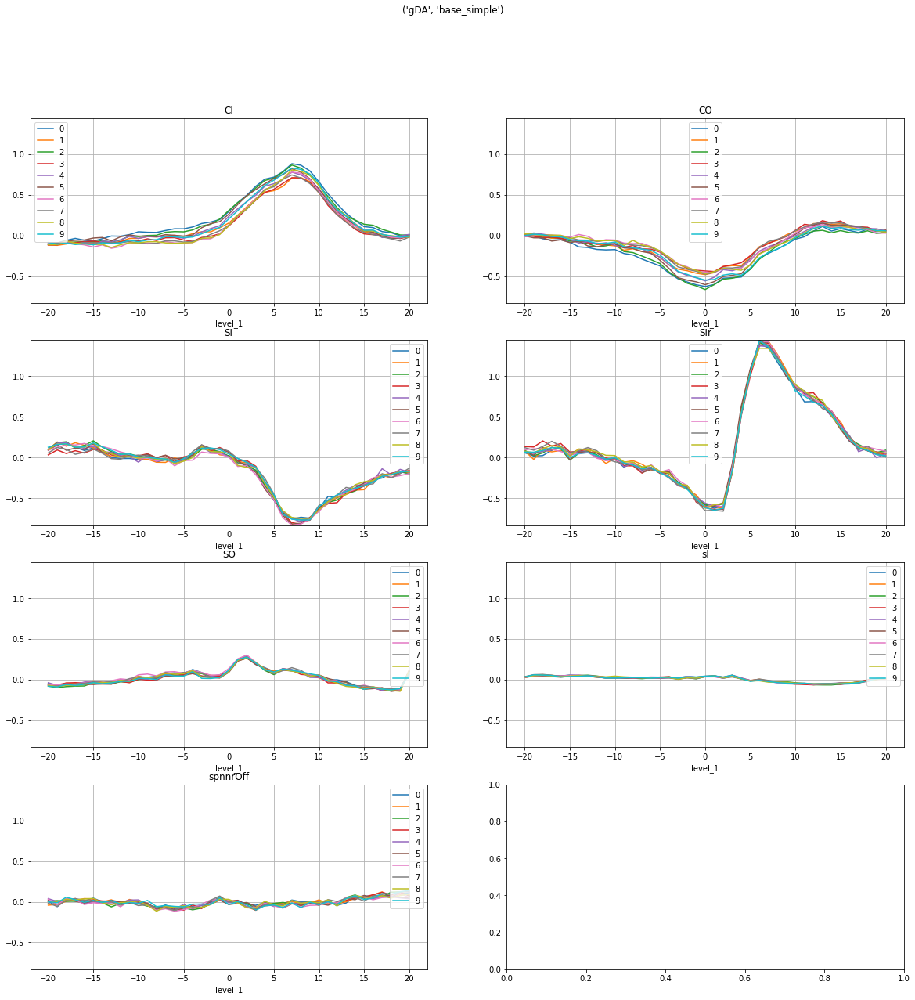

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.112379   
                                                   /gDA_0_1_base_words_run_num__1 -0.118478   
                                                   /gDA_0_1_base_words_run_num__2 -0.107553   
                                                   /gDA_0_1_base_words_run_num__3 -0.116735   
                                                   /gDA_0_1_base_words_run_num__4 -0.105810   
                                                   /gDA_0_1_base_words_run_num__5 -0.088692   
                                                   /gDA_0_1_base_words_run_num__6 -0.090104   
                                                   /gDA_0_1_base_words_run_num__7 -0.110382   
                                                   /gDA_0_1_base_words_run_num__8 -0.112535   
                                                   /gDA_0_1_base_words_run_num__9 -0.086140   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.091613   
                                                   /gDA_0_1_base_words_run_num__1 -0.122337   
                                                   /gDA_0_1_base_words_run_num__2 -0.101929   
                                                   /gDA_0_1_base_words_run_num__3 -0.114833   
                                                   /gDA_0_1_base_words_run_num__4 -0.107406   
                                                   /gDA_0_1_base_words_run_num__5 -0.091393   
                                                   /gDA_0_1_base_words_run_num__6 -0.108527   
                                                   /gDA_0_1_base_words_run_num__7 -0.095007   
                                                   /gDA_0_1_base_words_run_num__8 -0.112690   
                                                   /gDA_0_1_base_words_run_num__9 -0.106090   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.059072   
                                                   /gDA_0_1_base_words_run_num__1 -0.105495   
                                                   /gDA_0_1_base_words_run_num__2 -0.086484   
                                                   /gDA_0_1_base_words_run_num__3 -0.077908   
                                                   /gDA_0_1_base_words_run_num__4 -0.093273   
                                                   /gDA_0_1_base_words_run_num__5 -0.068833   
                                                   /gDA_0_1_base_words_run_num__6 -0.084744   
                                                   /gDA_0_1_base_words_run_num__7 -0.090441   
                                                   /gDA_0_1_base_words_run_num__8 -0.068068   
                                                   /gDA_0_1_base_words_run_num__9 -0.092136   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_0_1_base_words_run_num__0 -0.034755   
 

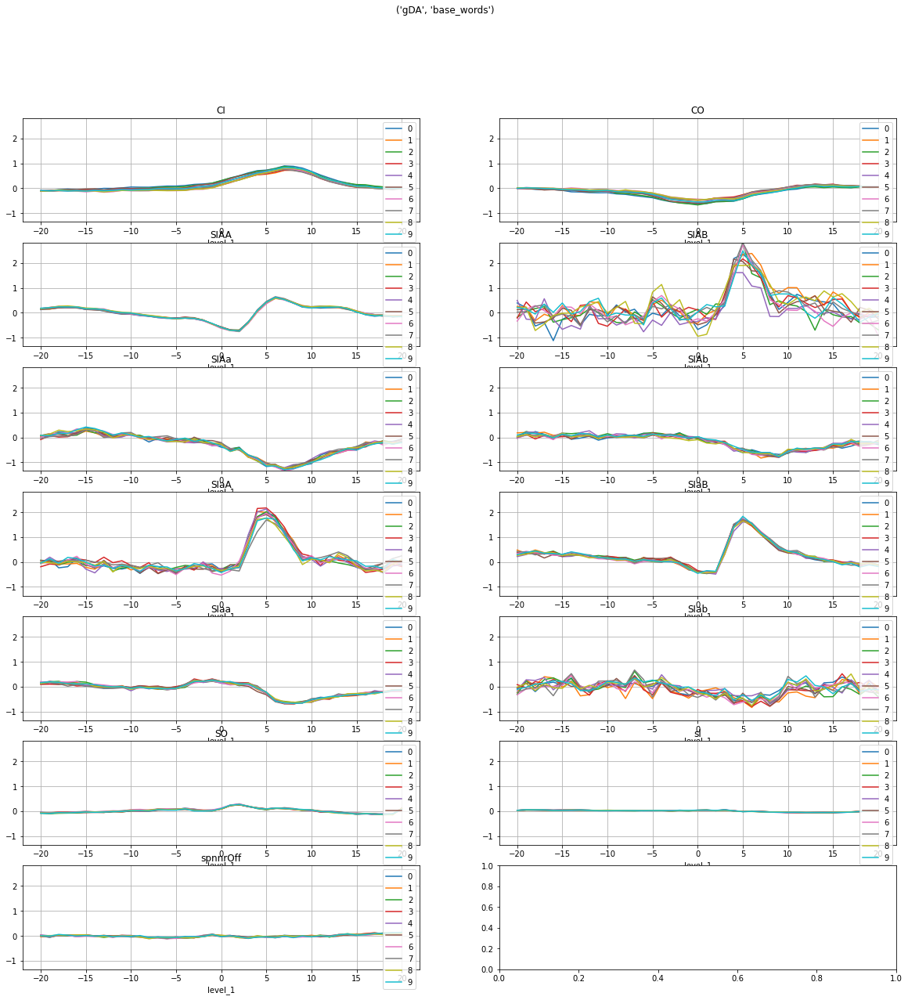

fig_folder ('Figure_5_g1', 'f5*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_5_g1\all\f5*-ft\coefs\*_best_coeffs.h5


gDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.005443   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.005147   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.003371   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.003513   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.004431   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.004882   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.005062   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.004677   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.004439   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.007036   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0 -0.003660   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1 -0.003201   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2 -0.003007   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3 -0.003431   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4 -0.003032   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5 -0.002911   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6 -0.003082   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7 -0.002912   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8 -0.004148   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9 -0.002690   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.002471   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.002765   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.001492   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.003206   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.002654   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.003833   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.003171   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.001001   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.002372   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.003664   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

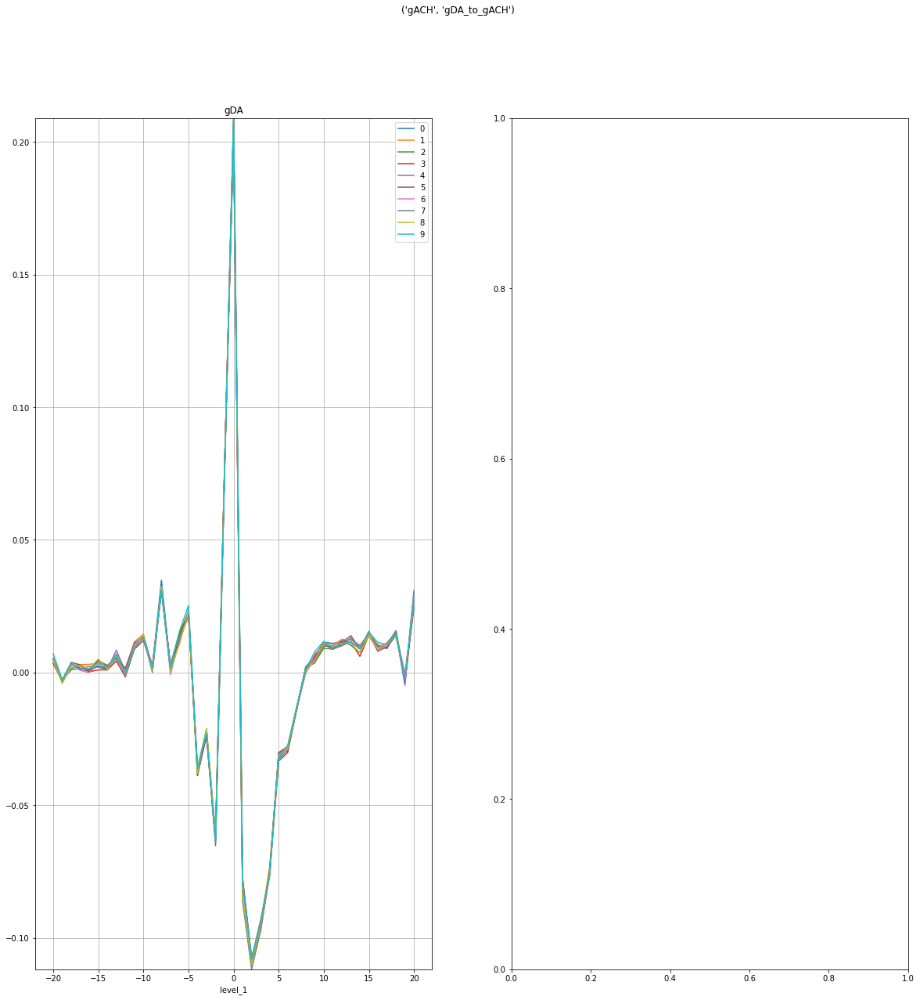

rDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.018499   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.019338   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.018084   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.017523   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.020906   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.019999   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.020956   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.021788   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.017822   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.017575   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.006434   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.007501   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.005222   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.006846   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.006230   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.008408   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.006879   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.008174   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.006622   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.007125   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.007236   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.006945   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.006335   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.007143   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.006187   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.007487   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.006876   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.005039   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.007373   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.007500   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

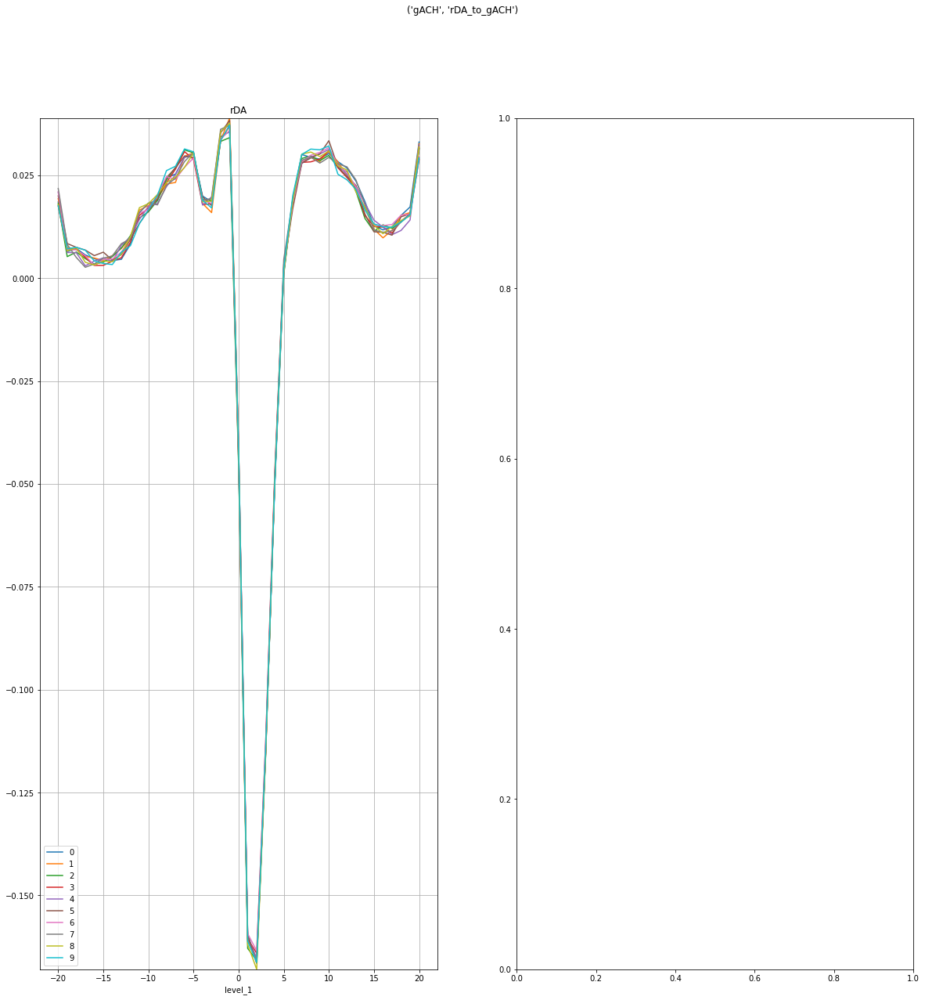

gDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.010790   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.012805   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.011599   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.009598   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.009219   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.011536   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.011141   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.010672   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8  0.011716   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9  0.013545   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0 -0.002505   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1 -0.003475   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2 -0.003026   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3 -0.002484   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4 -0.001888   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5 -0.003303   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6 -0.002218   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7 -0.002097   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8 -0.003965   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9 -0.002438   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.004347   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.004559   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.003818   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.005119   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.004678   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.004959   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.005431   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.002746   
                                                   /gACH_0_2_base_s

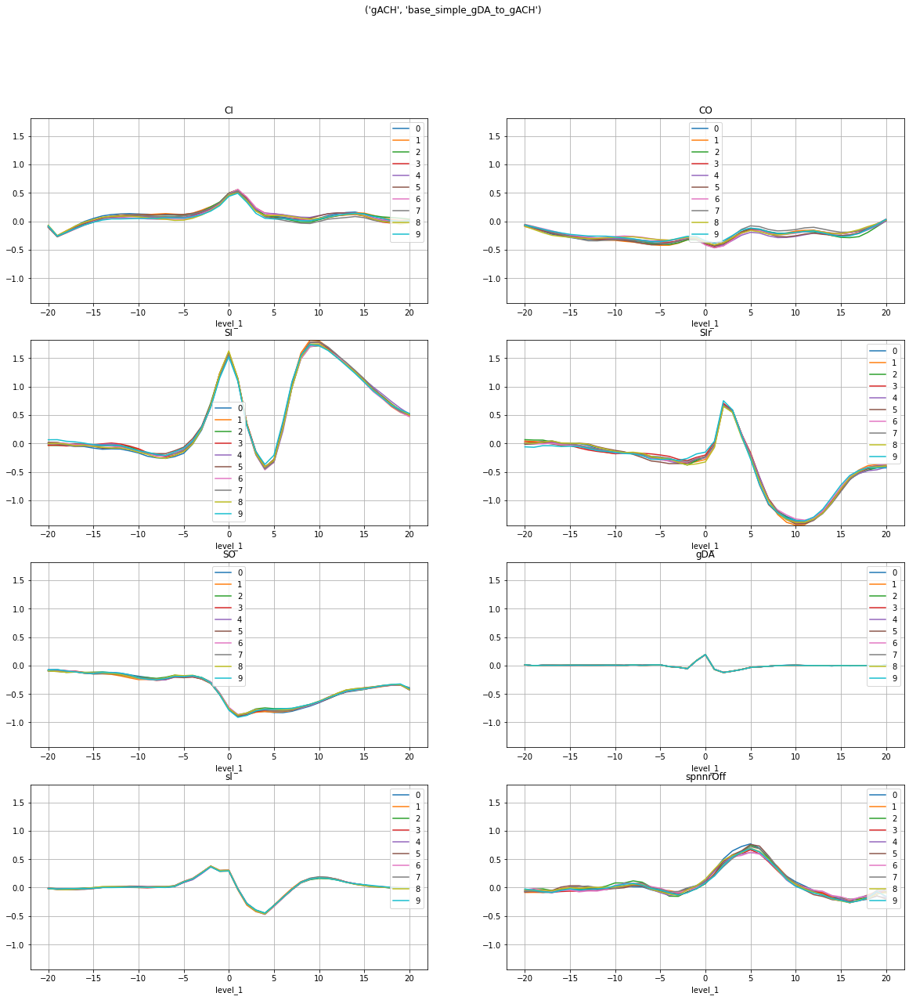

rDA  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.023516   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.022492   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__2  0.021403   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__3  0.020839   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__4  0.023490   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__5  0.022661   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__6  0.025355   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__7  0.025626   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__8  0.021446   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__9  0.021990   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.010242   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.010343

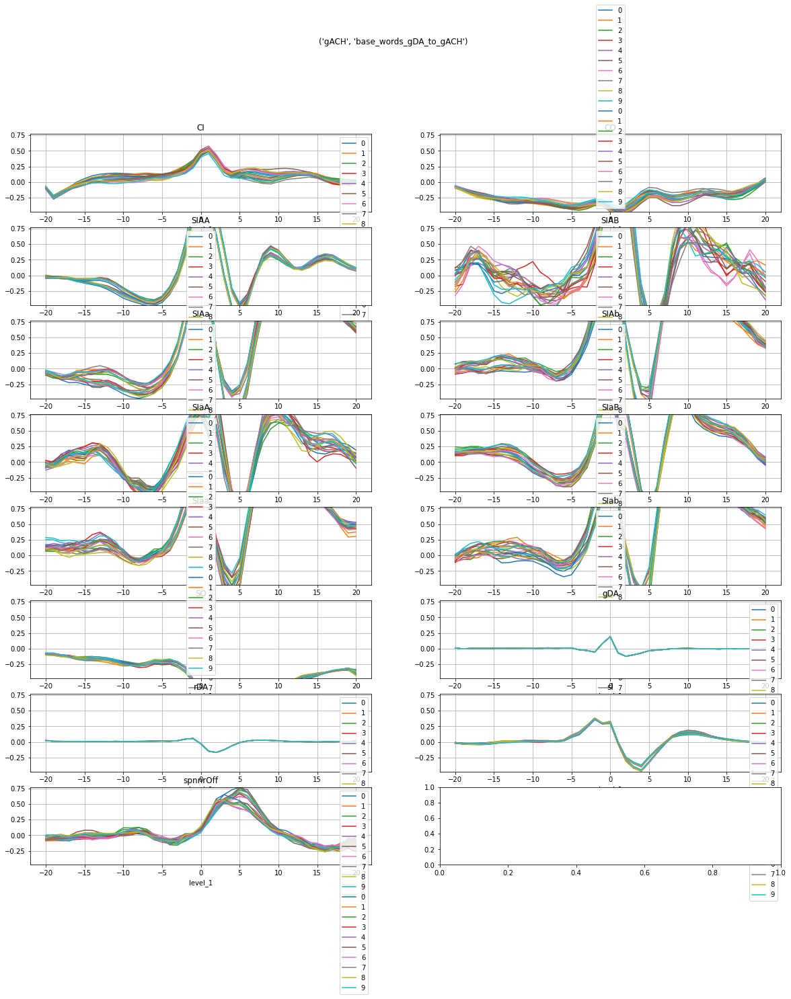

rDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.024777   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.023613   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.022803   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.021996   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.024878   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.023852   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.026379   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.026577   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.022391   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.023122   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.010696   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.010790   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.008575   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.010697   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.010067   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.012059   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.010848   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.011959   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.009598   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.010605   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.010366   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.010054   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.009507   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.010693   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.009561   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.010554   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.010433   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.007925   
                                                   /gACH_0_4_base_s

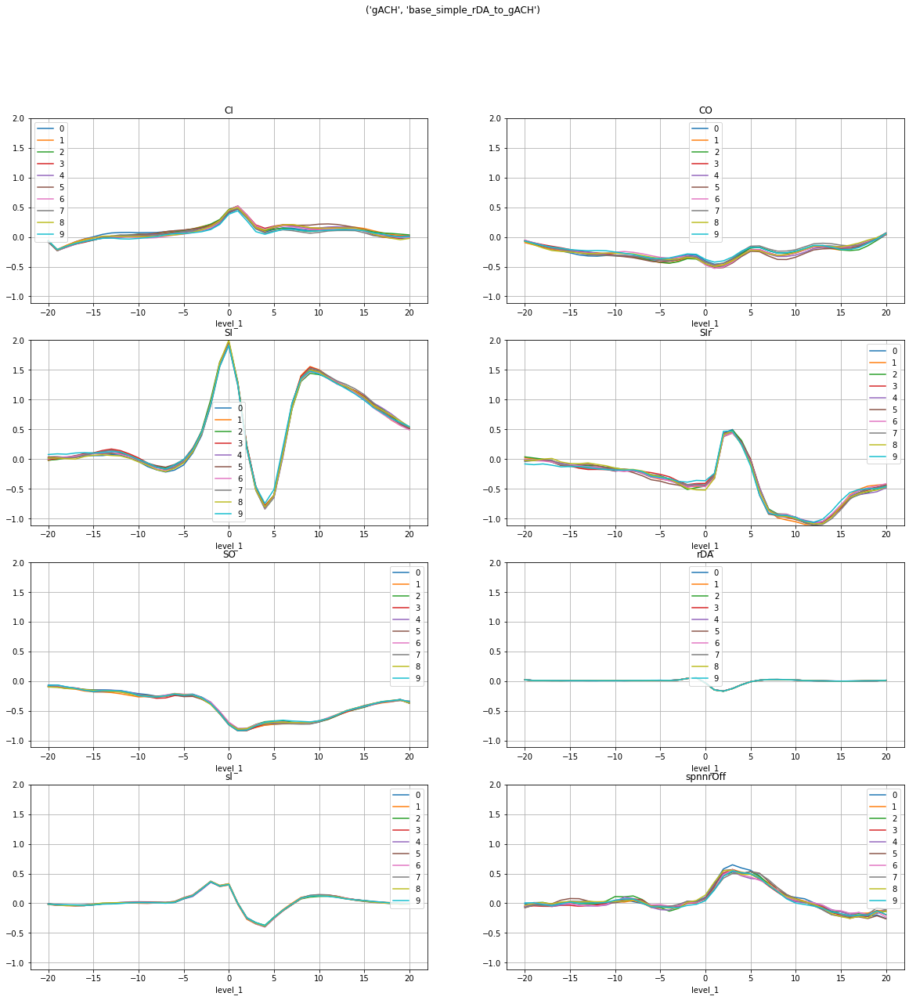

CI  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.061270   
                                                   /gACH_0_6_base_simple_run_num__1 -0.070129   
                                                   /gACH_0_6_base_simple_run_num__2 -0.058547   
                                                   /gACH_0_6_base_simple_run_num__3 -0.057125   
                                                   /gACH_0_6_base_simple_run_num__4 -0.054389   
                                                   /gACH_0_6_base_simple_run_num__5 -0.084626   
                                                   /gACH_0_6_base_simple_run_num__6 -0.067157   
                                                   /gACH_0_6_base_simple_run_num__7 -0.068735   
                                                   /gACH_0_6_base_simple_run_num__8 -0.044919   
                                                   /gACH_0_6_base_simple_run_num__9 -0.049581   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.228785   
                                                   /gACH_0_6_base_simple_run_num__1 -0.233267   
                                                   /gACH_0_6_base_simple_run_num__2 -0.248639   
                                                   /gACH_0_6_base_simple_run_num__3 -0.233011   
                                                   /gACH_0_6_base_simple_run_num__4 -0.241991   
                                                   /gACH_0_6_base_simple_run_num__5 -0.236306   
                                                   /gACH_0_6_base_simple_run_num__6 -0.242501   
                                                   /gACH_0_6_base_simple_run_num__7 -0.238370   
                                                   /gACH_0_6_base_simple_run_num__8 -0.233288   
                                                   /gACH_0_6_base_simple_run_num__9 -0.228901   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.162534   
                                                   /gACH_0_6_base_simple_run_num__1 -0.165612   
                                                   /gACH_0_6_base_simple_run_num__2 -0.183993   
                                                   /gACH_0_6_base_simple_run_num__3 -0.166524   
                                                   /gACH_0_6_base_simple_run_num__4 -0.188054   
                                                   /gACH_0_6_base_simple_run_num__5 -0.178710   
                                                   /gACH_0_6_base_simple_run_num__6 -0.196533   
                                                   /gACH_0_6_base_simple_run_num__7 -0.183390   
                                                   /gACH_0_6_base_simple_run_num__8 -0.170753   
                                                   /gACH_0_6_base_simple_run_num__9 -0.175947   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh\

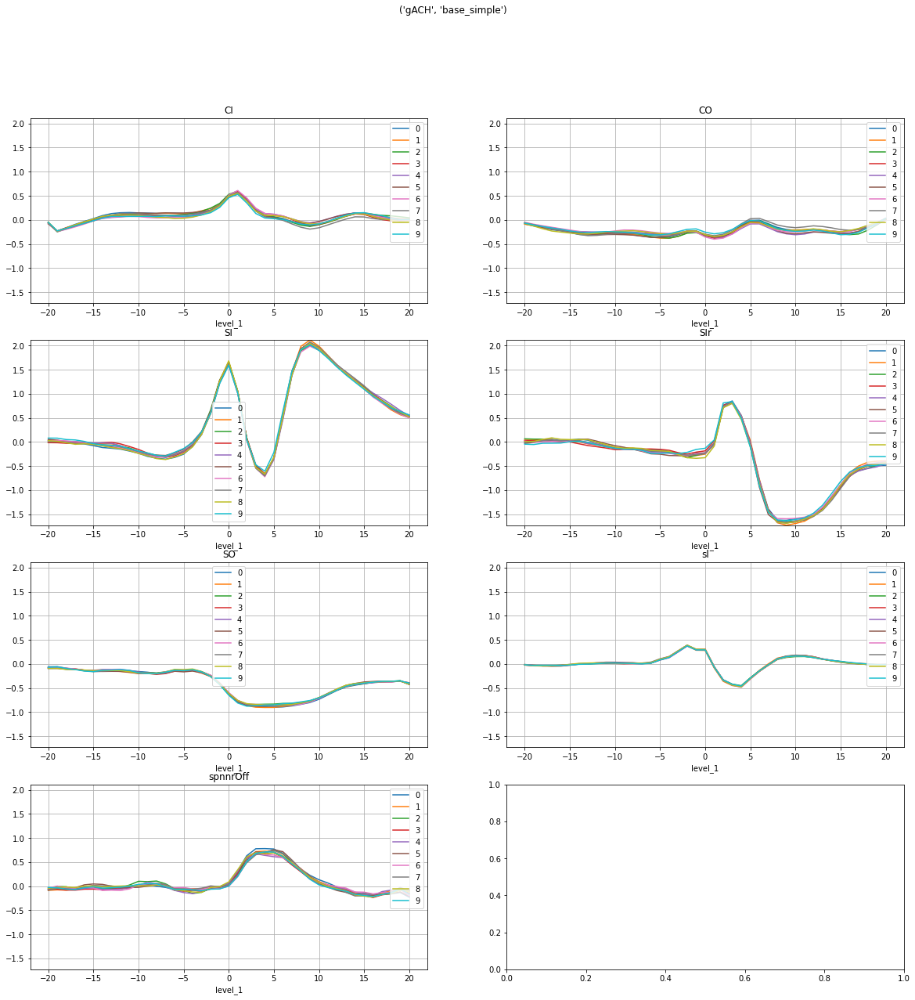

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.063362   
                                                   /gACH_0_7_base_words_run_num__1 -0.072425   
                                                   /gACH_0_7_base_words_run_num__2 -0.061344   
                                                   /gACH_0_7_base_words_run_num__3 -0.059037   
                                                   /gACH_0_7_base_words_run_num__4 -0.056779   
                                                   /gACH_0_7_base_words_run_num__5 -0.086745   
                                                   /gACH_0_7_base_words_run_num__6 -0.068983   
                                                   /gACH_0_7_base_words_run_num__7 -0.070945   
                                                   /gACH_0_7_base_words_run_num__8 -0.046681   
                                                   /gACH_0_7_base_words_run_num__9 -0.051903   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.228419   
                                                   /gACH_0_7_base_words_run_num__1 -0.233083   
                                                   /gACH_0_7_base_words_run_num__2 -0.248241   
                                                   /gACH_0_7_base_words_run_num__3 -0.231981   
                                                   /gACH_0_7_base_words_run_num__4 -0.241478   
                                                   /gACH_0_7_base_words_run_num__5 -0.236254   
                                                   /gACH_0_7_base_words_run_num__6 -0.242382   
                                                   /gACH_0_7_base_words_run_num__7 -0.238058   
                                                   /gACH_0_7_base_words_run_num__8 -0.233012   
                                                   /gACH_0_7_base_words_run_num__9 -0.228112   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.160851   
                                                   /gACH_0_7_base_words_run_num__1 -0.164069   
                                                   /gACH_0_7_base_words_run_num__2 -0.182190   
                                                   /gACH_0_7_base_words_run_num__3 -0.164013   
                                                   /gACH_0_7_base_words_run_num__4 -0.185909   
                                                   /gACH_0_7_base_words_run_num__5 -0.177488   
                                                   /gACH_0_7_base_words_run_num__6 -0.195215   
                                                   /gACH_0_7_base_words_run_num__7 -0.181677   
                                                   /gACH_0_7_base_words_run_num__8 -0.169041   
                                                   /gACH_0_7_base_words_run_num__9 -0.173347   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gAC

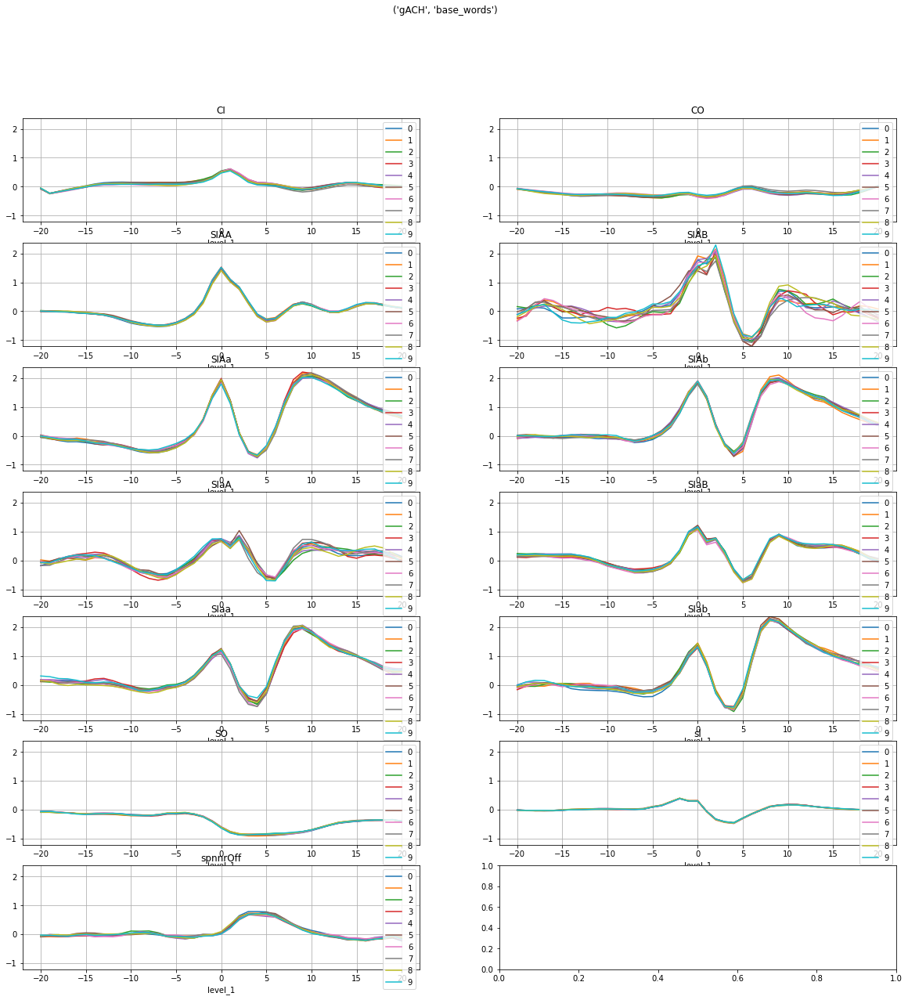

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.049975   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.053211   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.051133   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.053302   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.051318   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.052010   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.054022   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.051781   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.051907   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.055762   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0 -0.008522   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1 -0.010813   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2 -0.009862   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3 -0.009714   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4 -0.010112   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5 -0.010914   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6 -0.011722   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7 -0.011521   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8 -0.010426   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9 -0.014810   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.023173   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.021192   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.017307   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.021736   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.020647   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.021002   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.023007   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.019722   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.020422   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.022205   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /g

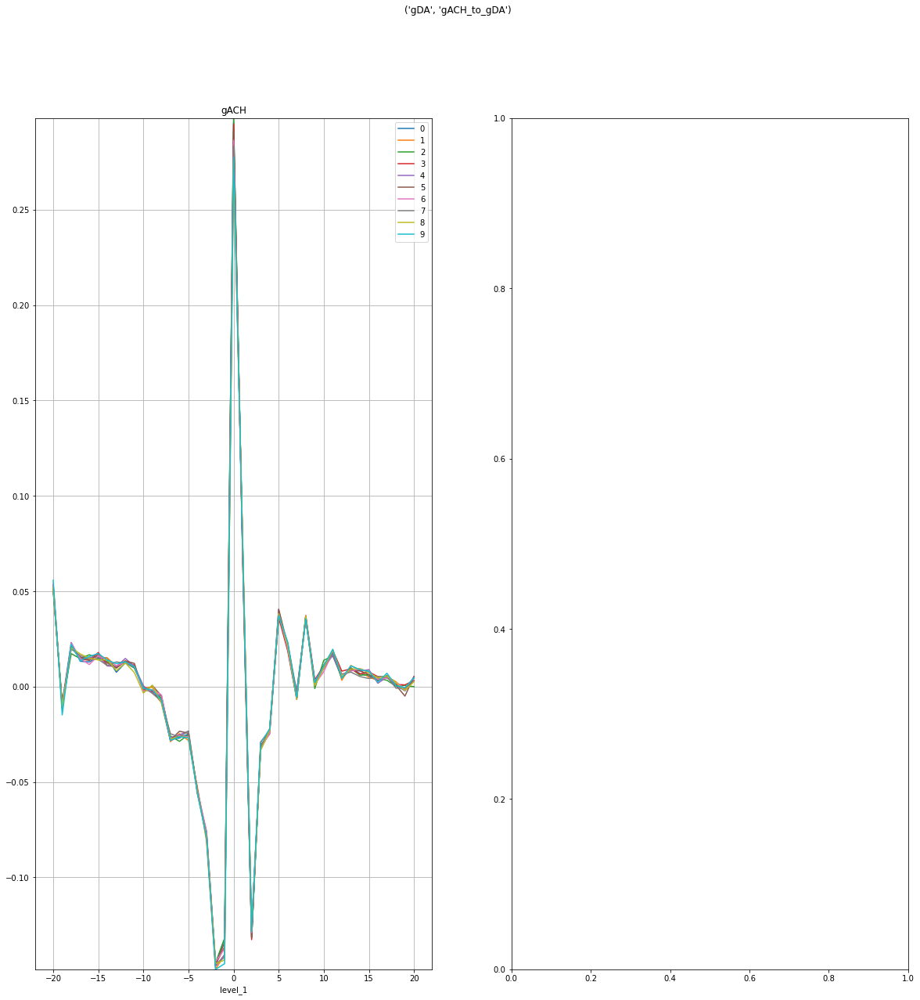

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.013565   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.015689   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.016588   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.016343   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.015144   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.015901   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.018291   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.017775   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.017260   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9  0.019483   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0 -0.003978   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1 -0.006638   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2 -0.007401   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3 -0.006972   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4 -0.006637   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5 -0.008018   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6 -0.009746   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7 -0.009245   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8 -0.007845   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9 -0.011694   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.006230   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.004337   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.001144   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.006137   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.004112   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.005736   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.006979   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.003763   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.0050

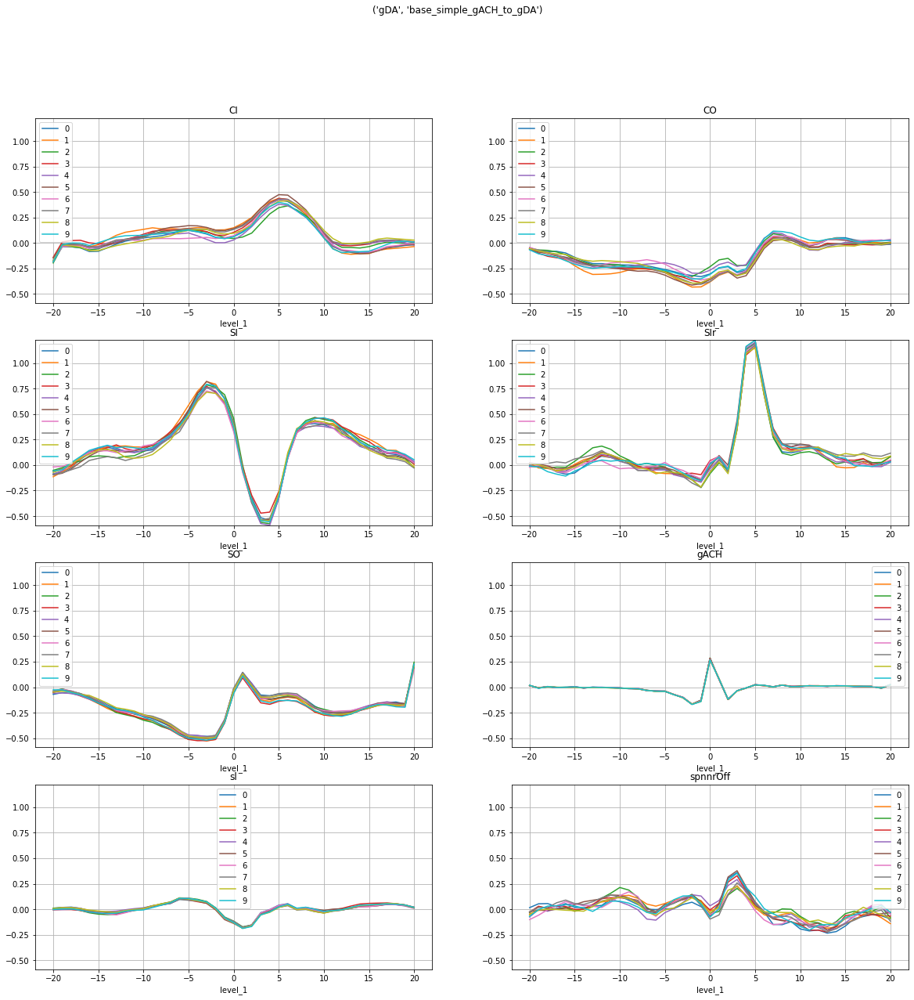

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.014518   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.016126   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.017444   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.017844   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.015966   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.016687   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.018873   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.018749   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.018205   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9  0.020246   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0 -0.003936   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1 -0.006476   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2 -0.007455   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3 -0.007151   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4 -0.006858   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5 -0.007924   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6 -0.009509   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7 -0.009199   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8 -0.007967   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9 -0.011500   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.006652   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.004588   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.001501   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.006620   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.004447   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.005972   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.007252   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.004157   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.005370   
                               

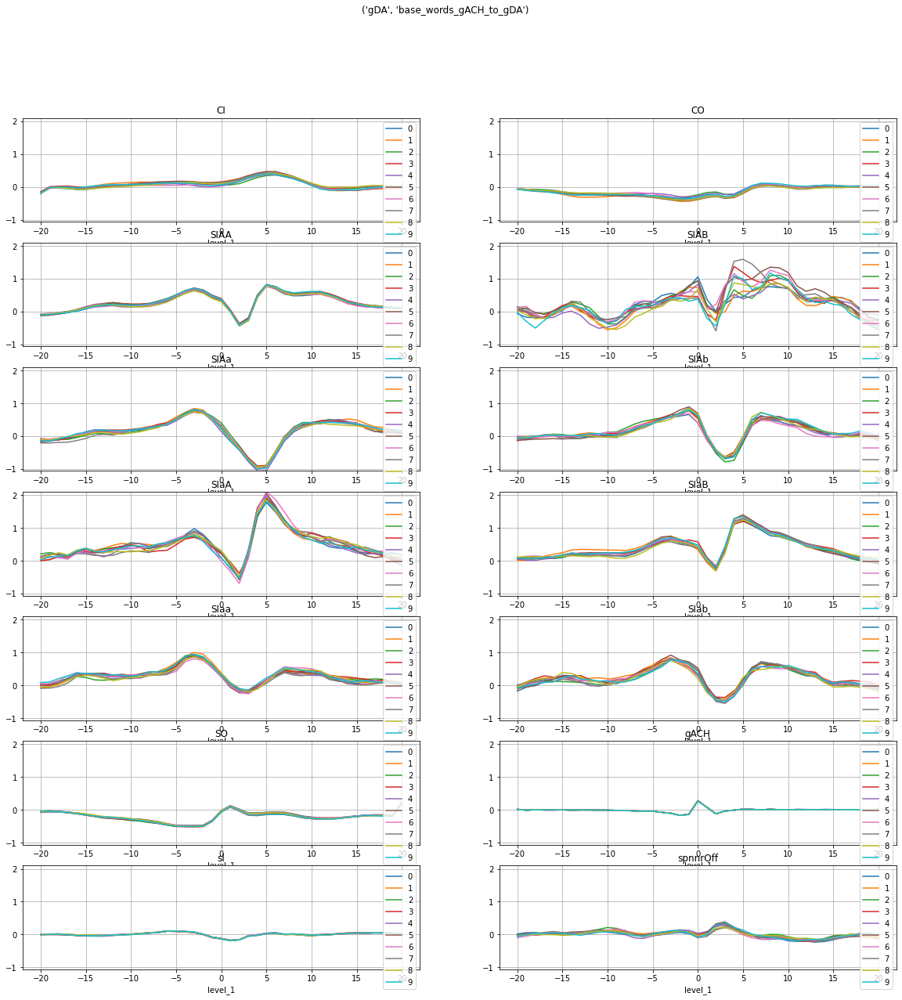

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.150472   
                                                   /gDA_1_3_base_simple_run_num__1 -0.162769   
                                                   /gDA_1_3_base_simple_run_num__2 -0.173271   
                                                   /gDA_1_3_base_simple_run_num__3 -0.114120   
                                                   /gDA_1_3_base_simple_run_num__4 -0.150186   
                                                   /gDA_1_3_base_simple_run_num__5 -0.125276   
                                                   /gDA_1_3_base_simple_run_num__6 -0.144385   
                                                   /gDA_1_3_base_simple_run_num__7 -0.123156   
                                                   /gDA_1_3_base_simple_run_num__8 -0.148691   
                                                   /gDA_1_3_base_simple_run_num__9 -0.156194   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.014585   
                                                   /gDA_1_3_base_simple_run_num__1 -0.024816   
                                                   /gDA_1_3_base_simple_run_num__2 -0.018402   
                                                   /gDA_1_3_base_simple_run_num__3  0.029863   
                                                   /gDA_1_3_base_simple_run_num__4 -0.008612   
                                                   /gDA_1_3_base_simple_run_num__5  0.003267   
                                                   /gDA_1_3_base_simple_run_num__6 -0.013769   
                                                   /gDA_1_3_base_simple_run_num__7  0.013510   
                                                   /gDA_1_3_base_simple_run_num__8  0.002735   
                                                   /gDA_1_3_base_simple_run_num__9 -0.001488   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.033387   
                                                   /gDA_1_3_base_simple_run_num__1 -0.033973   
                                                   /gDA_1_3_base_simple_run_num__2 -0.034908   
                                                   /gDA_1_3_base_simple_run_num__3  0.037152   
                                                   /gDA_1_3_base_simple_run_num__4 -0.015526   
                                                   /gDA_1_3_base_simple_run_num__5 -0.003288   
                                                   /gDA_1_3_base_simple_run_num__6 -0.013435   
                                                   /gDA_1_3_base_simple_run_num__7  0.004267   
                                                   /gDA_1_3_base_simple_run_num__8 -0.018542   
                                                   /gDA_1_3_base_simple_run_num__9  0.002861   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

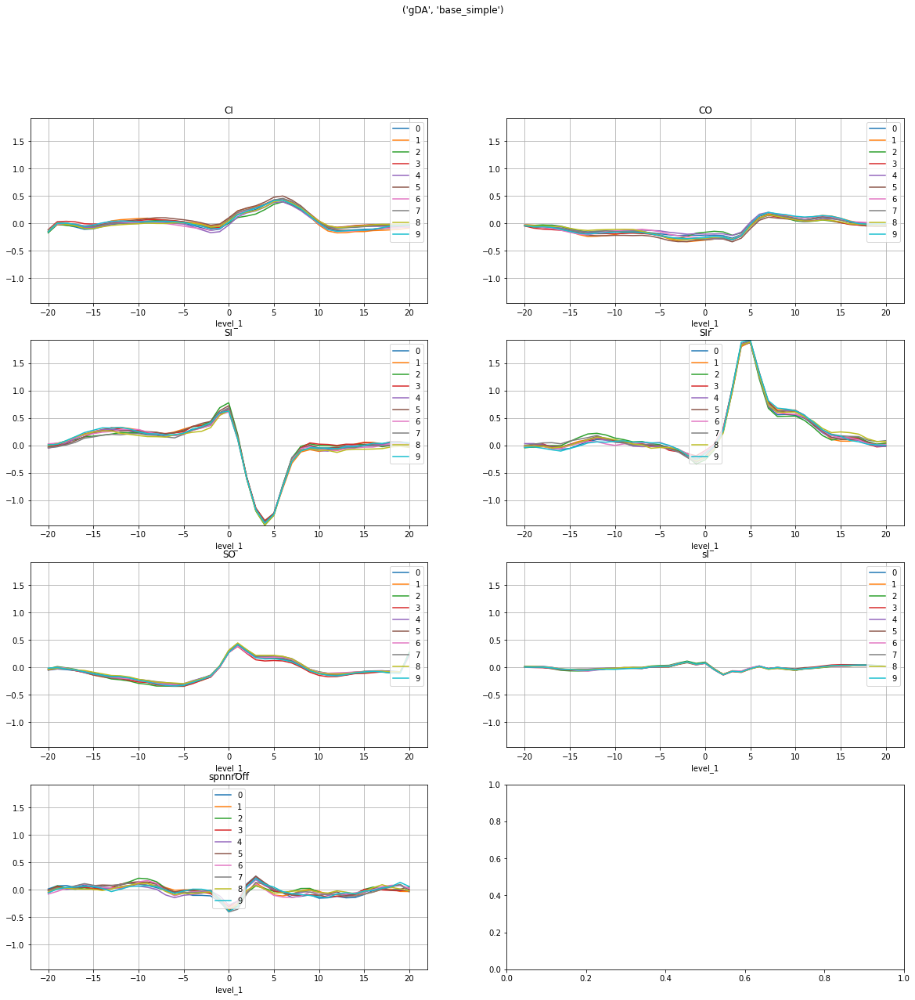

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.151925   
                                                   /gDA_1_4_base_words_run_num__1 -0.163843   
                                                   /gDA_1_4_base_words_run_num__2 -0.174965   
                                                   /gDA_1_4_base_words_run_num__3 -0.115134   
                                                   /gDA_1_4_base_words_run_num__4 -0.150761   
                                                   /gDA_1_4_base_words_run_num__5 -0.126971   
                                                   /gDA_1_4_base_words_run_num__6 -0.145566   
                                                   /gDA_1_4_base_words_run_num__7 -0.124127   
                                                   /gDA_1_4_base_words_run_num__8 -0.149391   
                                                   /gDA_1_4_base_words_run_num__9 -0.157772   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.013479   
                                                   /gDA_1_4_base_words_run_num__1 -0.023339   
                                                   /gDA_1_4_base_words_run_num__2 -0.017849   
                                                   /gDA_1_4_base_words_run_num__3  0.030544   
                                                   /gDA_1_4_base_words_run_num__4 -0.007585   
                                                   /gDA_1_4_base_words_run_num__5  0.004276   
                                                   /gDA_1_4_base_words_run_num__6 -0.012497   
                                                   /gDA_1_4_base_words_run_num__7  0.014680   
                                                   /gDA_1_4_base_words_run_num__8  0.004110   
                                                   /gDA_1_4_base_words_run_num__9 -0.000869   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.030718   
                                                   /gDA_1_4_base_words_run_num__1 -0.030793   
                                                   /gDA_1_4_base_words_run_num__2 -0.032999   
                                                   /gDA_1_4_base_words_run_num__3  0.039042   
                                                   /gDA_1_4_base_words_run_num__4 -0.012845   
                                                   /gDA_1_4_base_words_run_num__5 -0.000684   
                                                   /gDA_1_4_base_words_run_num__6 -0.010402   
                                                   /gDA_1_4_base_words_run_num__7  0.006576   
                                                   /gDA_1_4_base_words_run_num__8 -0.015710   
                                                   /gDA_1_4_base_words_run_num__9  0.005140   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.062627   
 

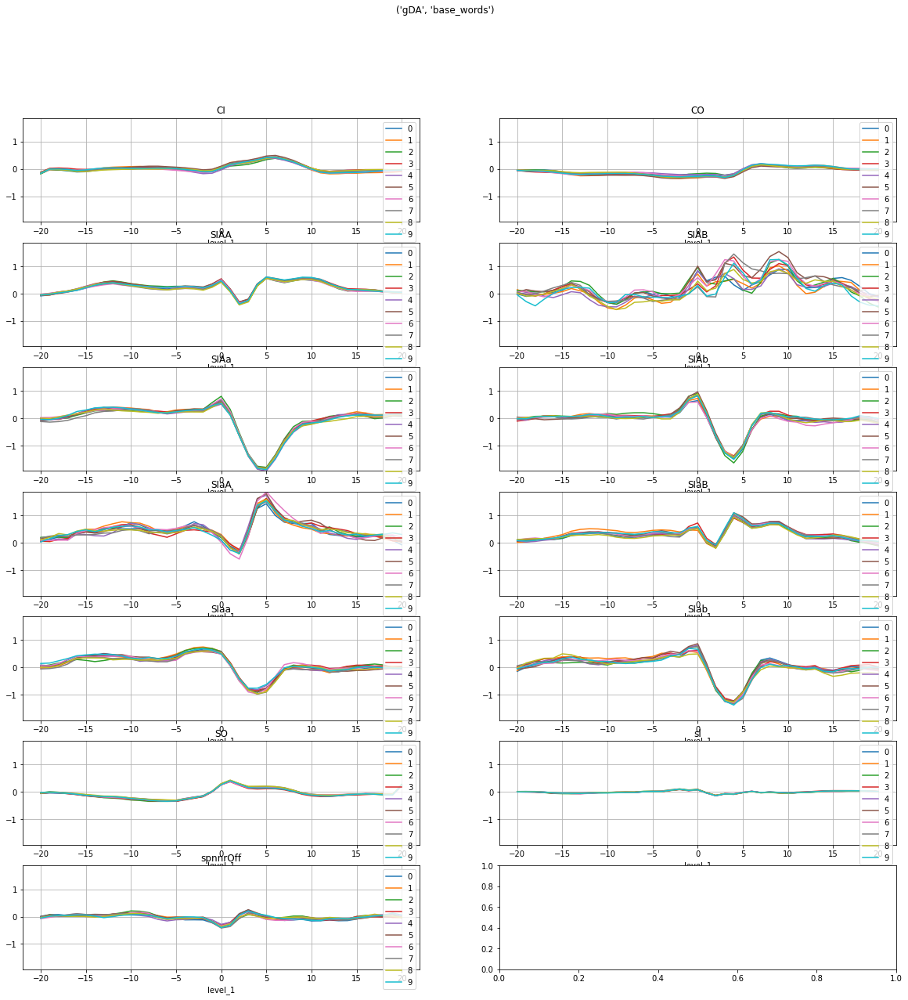

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.074332   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.073460   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.076150   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.072245   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.074281   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.071579   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.077168   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.074447   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.077888   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.073748   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0 -0.009387   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1 -0.010607   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2 -0.013729   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3 -0.007109   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4 -0.010635   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5 -0.011041   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6 -0.011041   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7 -0.010946   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8 -0.011971   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9 -0.010971   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.027061   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.029646   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.032112   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.027714   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.027777   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.030147   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.028913   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.032507   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.029853   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.029202   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /r

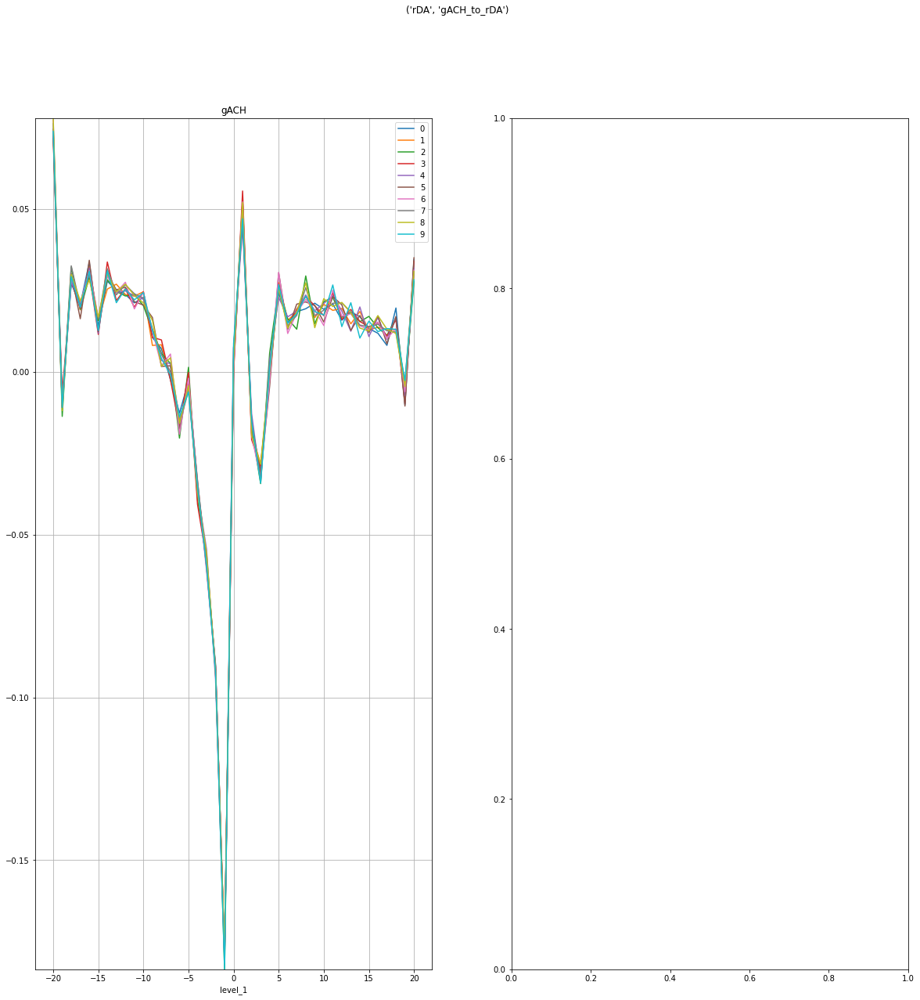

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.033312   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.033268   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.035983   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.032765   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.036749   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.032233   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.035191   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.036792   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.036493   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9  0.030926   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0 -0.006574   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1 -0.007323   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2 -0.010772   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3 -0.006023   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4 -0.009440   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5 -0.009552   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6 -0.007019   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7 -0.009274   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8 -0.008837   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9 -0.007866   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.011970   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.014201   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.016534   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.012602   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.013145   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.014813   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.011648   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.018241   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.0144

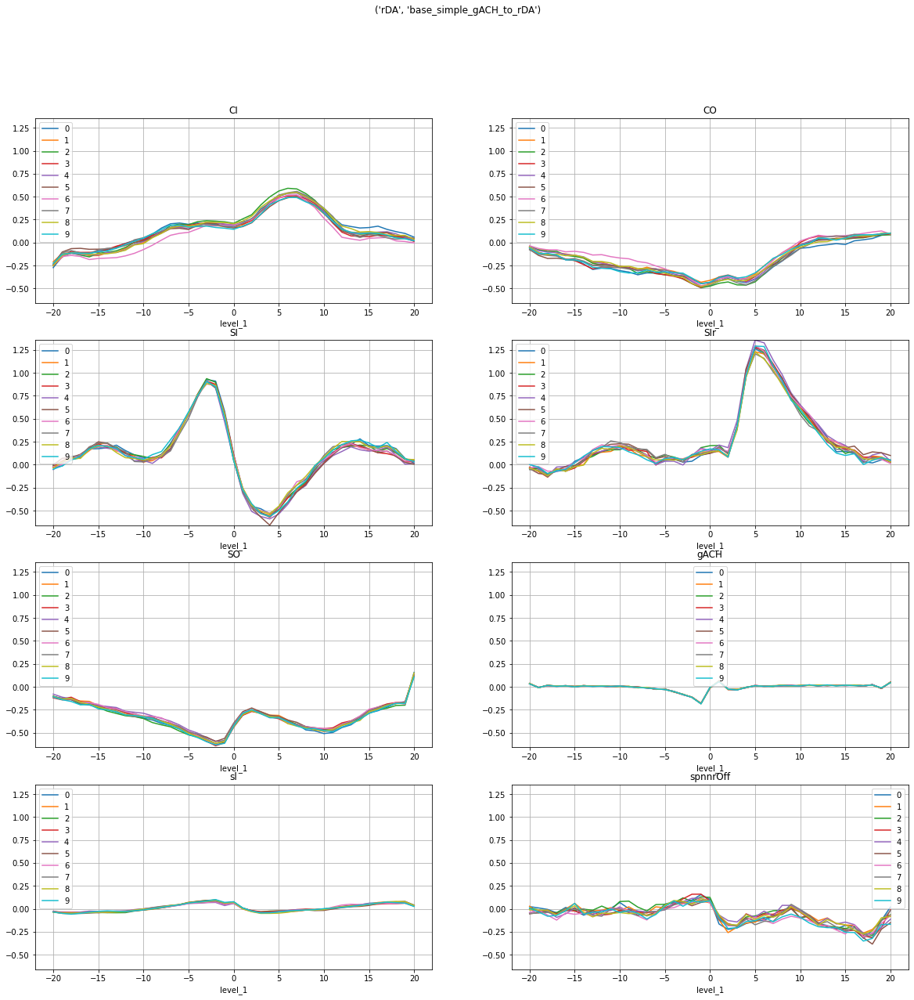

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.033512   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.033299   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.036148   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.032977   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.036791   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.032184   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.035253   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.036441   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.036833   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9  0.030923   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0 -0.006312   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1 -0.006667   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2 -0.010355   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3 -0.005495   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4 -0.008837   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5 -0.009172   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6 -0.006727   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7 -0.008800   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8 -0.008514   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9 -0.007494   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.011999   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.014012   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.016766   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.012780   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.013444   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.015049   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.011789   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.018244   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.014721   
                               

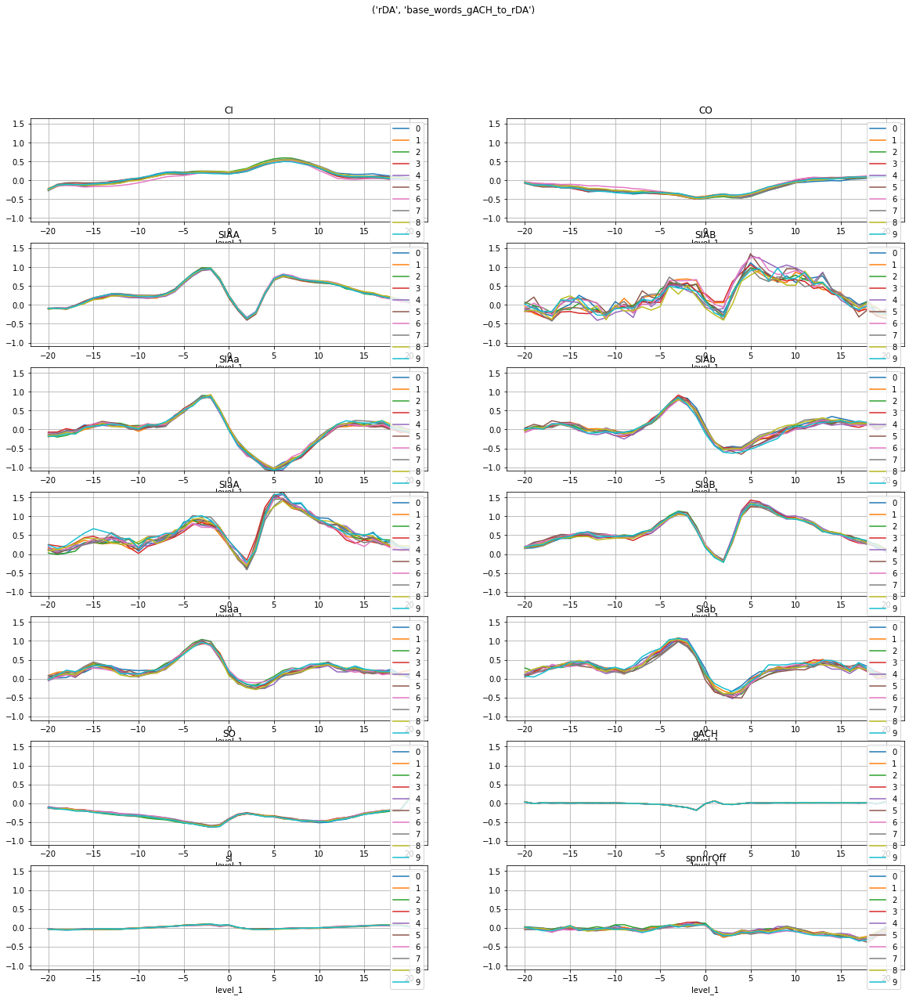

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.245400   
                                                   /rDA_2_3_base_simple_run_num__1 -0.173194   
                                                   /rDA_2_3_base_simple_run_num__2 -0.209752   
                                                   /rDA_2_3_base_simple_run_num__3 -0.225567   
                                                   /rDA_2_3_base_simple_run_num__4 -0.215218   
                                                   /rDA_2_3_base_simple_run_num__5 -0.211545   
                                                   /rDA_2_3_base_simple_run_num__6 -0.213843   
                                                   /rDA_2_3_base_simple_run_num__7 -0.207854   
                                                   /rDA_2_3_base_simple_run_num__8 -0.210958   
                                                   /rDA_2_3_base_simple_run_num__9 -0.190263   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.106476   
                                                   /rDA_2_3_base_simple_run_num__1 -0.084166   
                                                   /rDA_2_3_base_simple_run_num__2 -0.096794   
                                                   /rDA_2_3_base_simple_run_num__3 -0.121083   
                                                   /rDA_2_3_base_simple_run_num__4 -0.110251   
                                                   /rDA_2_3_base_simple_run_num__5 -0.073190   
                                                   /rDA_2_3_base_simple_run_num__6 -0.114143   
                                                   /rDA_2_3_base_simple_run_num__7 -0.075382   
                                                   /rDA_2_3_base_simple_run_num__8 -0.092355   
                                                   /rDA_2_3_base_simple_run_num__9 -0.084828   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.087914   
                                                   /rDA_2_3_base_simple_run_num__1 -0.089336   
                                                   /rDA_2_3_base_simple_run_num__2 -0.084279   
                                                   /rDA_2_3_base_simple_run_num__3 -0.072794   
                                                   /rDA_2_3_base_simple_run_num__4 -0.095147   
                                                   /rDA_2_3_base_simple_run_num__5 -0.051446   
                                                   /rDA_2_3_base_simple_run_num__6 -0.121588   
                                                   /rDA_2_3_base_simple_run_num__7 -0.067132   
                                                   /rDA_2_3_base_simple_run_num__8 -0.077094   
                                                   /rDA_2_3_base_simple_run_num__9 -0.084672   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA

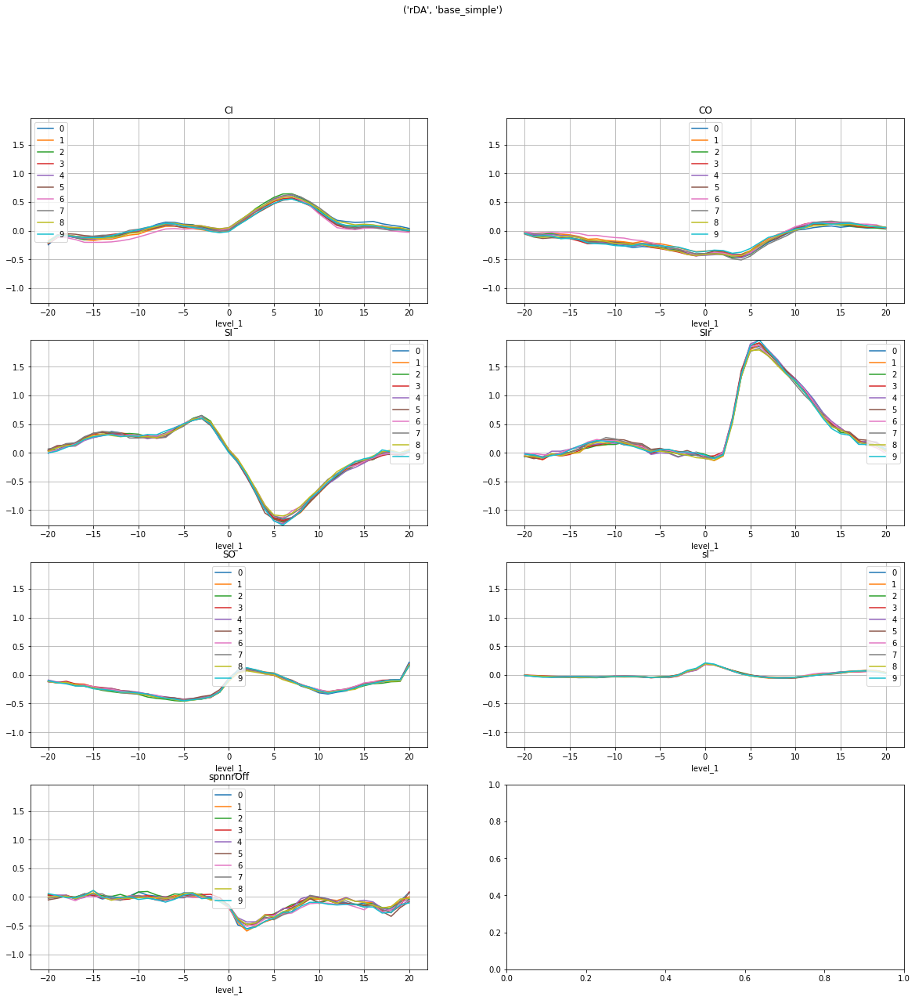

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.246433   
                                                   /rDA_2_4_base_words_run_num__1 -0.175693   
                                                   /rDA_2_4_base_words_run_num__2 -0.212272   
                                                   /rDA_2_4_base_words_run_num__3 -0.228108   
                                                   /rDA_2_4_base_words_run_num__4 -0.217665   
                                                   /rDA_2_4_base_words_run_num__5 -0.214503   
                                                   /rDA_2_4_base_words_run_num__6 -0.216588   
                                                   /rDA_2_4_base_words_run_num__7 -0.210159   
                                                   /rDA_2_4_base_words_run_num__8 -0.213686   
                                                   /rDA_2_4_base_words_run_num__9 -0.192537   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.104643   
                                                   /rDA_2_4_base_words_run_num__1 -0.083159   
                                                   /rDA_2_4_base_words_run_num__2 -0.095714   
                                                   /rDA_2_4_base_words_run_num__3 -0.119527   
                                                   /rDA_2_4_base_words_run_num__4 -0.109265   
                                                   /rDA_2_4_base_words_run_num__5 -0.072927   
                                                   /rDA_2_4_base_words_run_num__6 -0.112543   
                                                   /rDA_2_4_base_words_run_num__7 -0.074540   
                                                   /rDA_2_4_base_words_run_num__8 -0.091455   
                                                   /rDA_2_4_base_words_run_num__9 -0.083635   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.084343   
                                                   /rDA_2_4_base_words_run_num__1 -0.086721   
                                                   /rDA_2_4_base_words_run_num__2 -0.081652   
                                                   /rDA_2_4_base_words_run_num__3 -0.069054   
                                                   /rDA_2_4_base_words_run_num__4 -0.092439   
                                                   /rDA_2_4_base_words_run_num__5 -0.050040   
                                                   /rDA_2_4_base_words_run_num__6 -0.117997   
                                                   /rDA_2_4_base_words_run_num__7 -0.064681   
                                                   /rDA_2_4_base_words_run_num__8 -0.074570   
                                                   /rDA_2_4_base_words_run_num__9 -0.081764   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.113256   
 

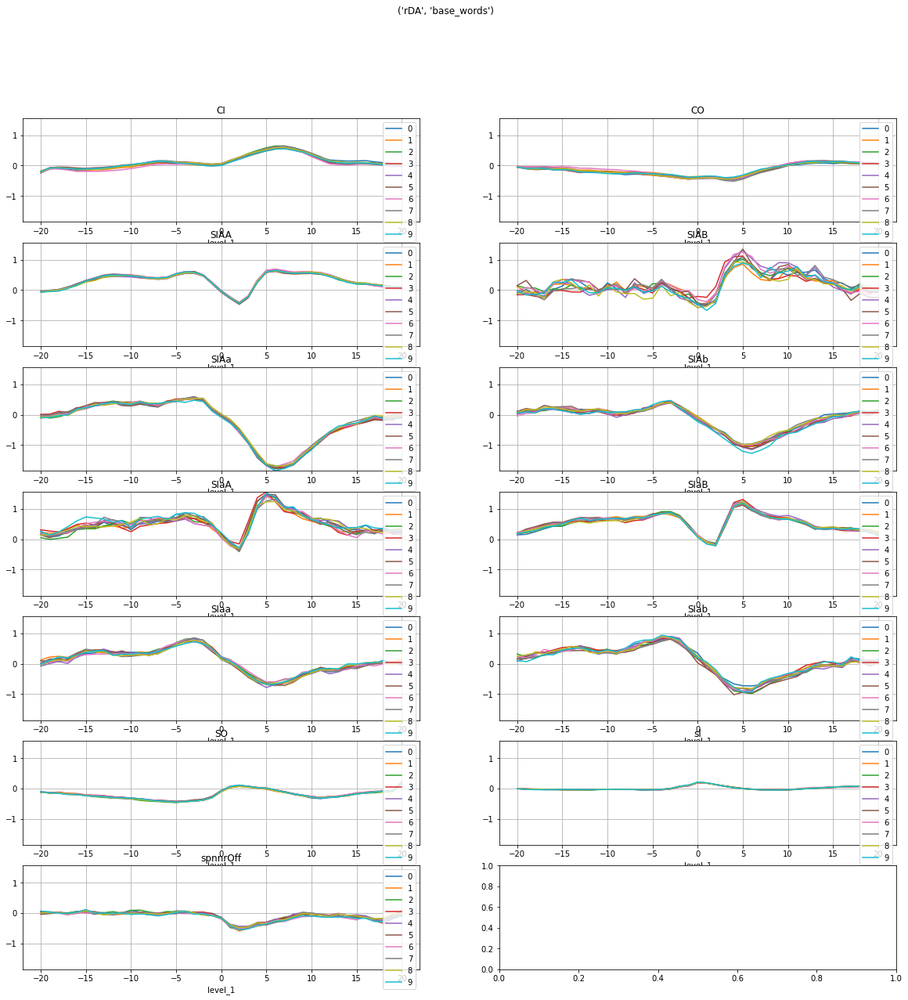

fig_folder ('Figure_5_g2', 'f5*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_5_g2\all\f5*-ft\coefs\*_best_coeffs.h5


gDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.021150   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.020684   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.021476   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.022352   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.022604   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.022359   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.023403   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.023610   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.020392   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.023582   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0 -0.004234   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1 -0.004163   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2 -0.002550   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3 -0.002470   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4 -0.003132   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5 -0.002441   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6 -0.001739   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7 -0.003401   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8 -0.003072   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9 -0.004019   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.005393   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.006040   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.005660   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.006823   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.005840   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.007288   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.007803   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.006067   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.008202   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.007213   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

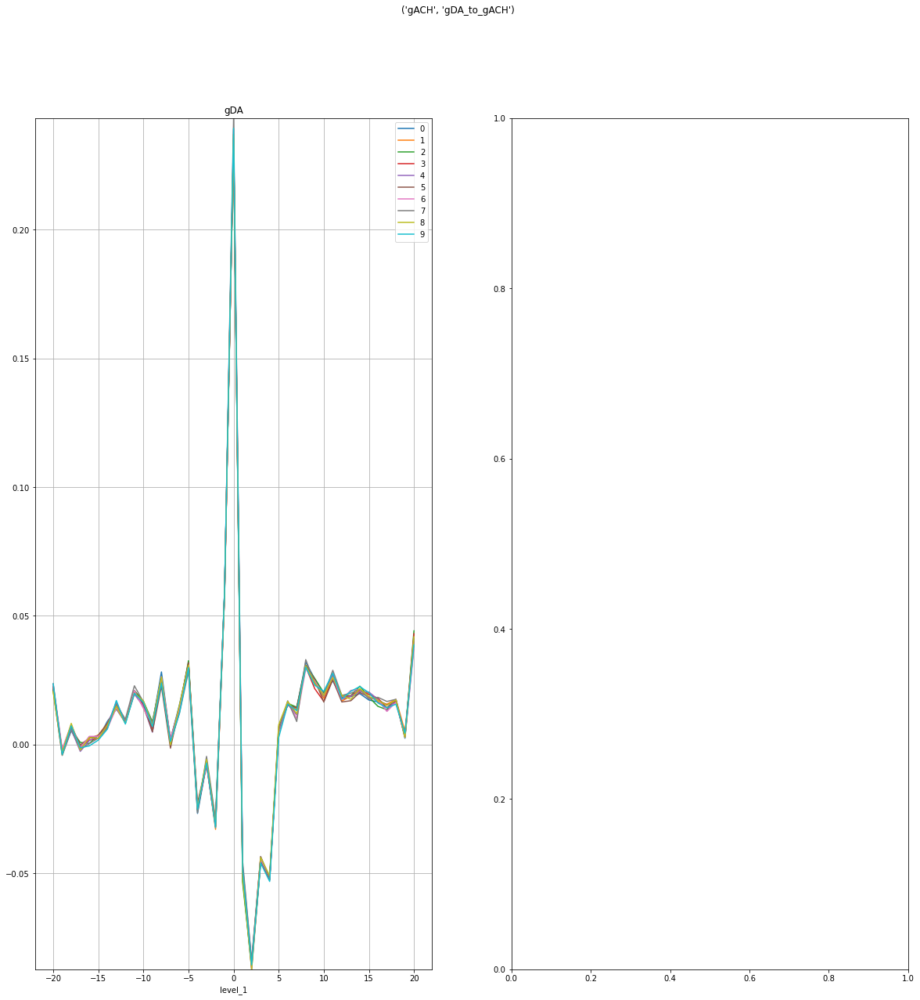

rDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.015526   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.015903   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.015020   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.015097   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.017345   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.014360   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.015298   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.013466   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.016335   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.015387   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.005910   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.002824   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.005510   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.005268   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.004715   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.007069   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.005515   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.004726   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.003644   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.006397   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.007183   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.005431   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.007369   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.006868   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.005581   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.006399   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.005261   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.008719   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.005550   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.006900   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

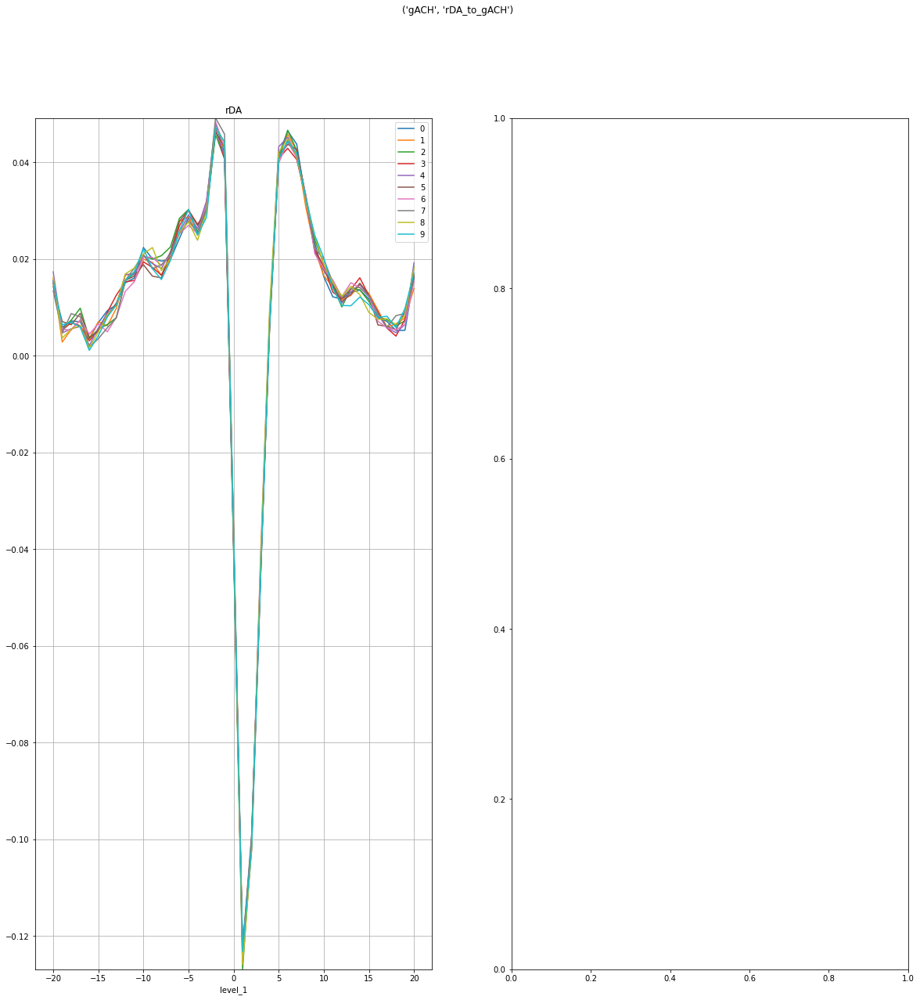

gDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.027557   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.026613   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.027761   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.029579   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.029520   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.028052   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.029765   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.029906   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8  0.026601   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9  0.030375   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0 -0.002330   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1 -0.002682   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2 -0.001388   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3 -0.001421   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4 -0.001622   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5 -0.000582   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6 -0.000995   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7 -0.001535   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8 -0.001213   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9 -0.002309   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.009319   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.009407   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.009617   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.010832   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.009115   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.010124   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.010837   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.009359   
                                                   /gACH_0_2_base_s

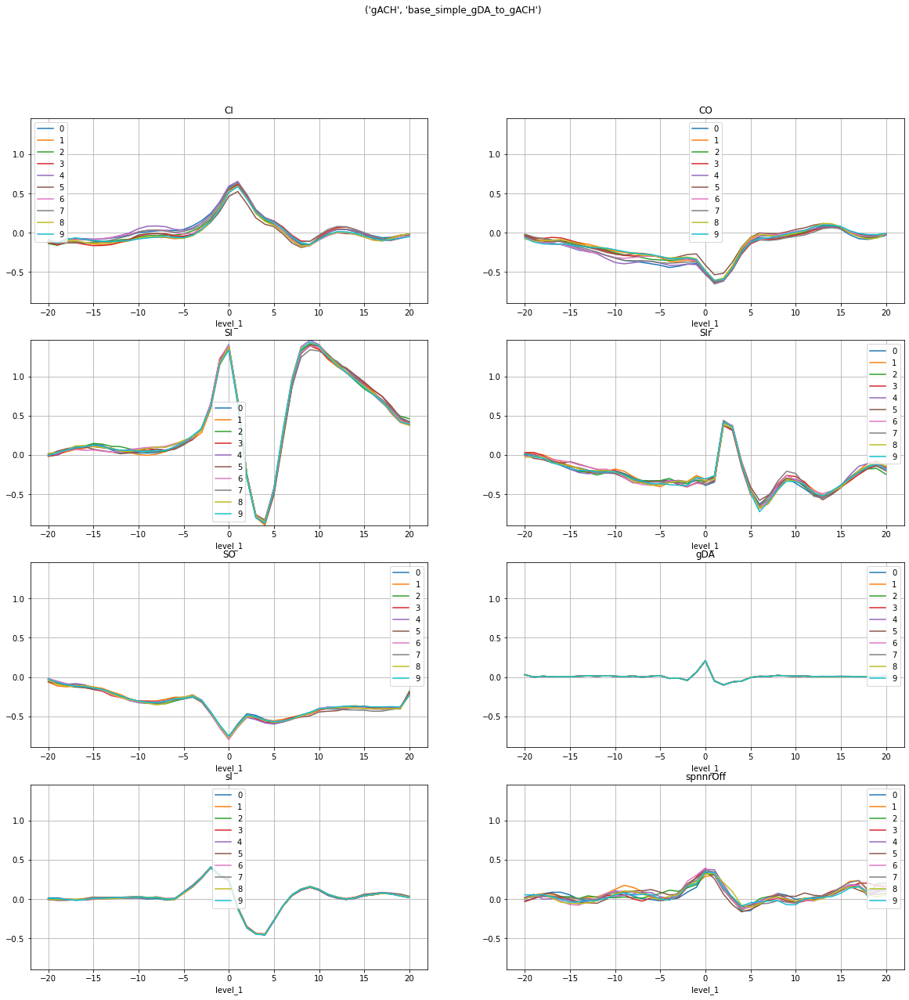

rDA  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.013383   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.012870   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__2  0.012382   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__3  0.011584   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__4  0.014915   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__5  0.012030   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__6  0.013646   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__7  0.011529   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__8  0.013908   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__9  0.013349   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.005580   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.002806

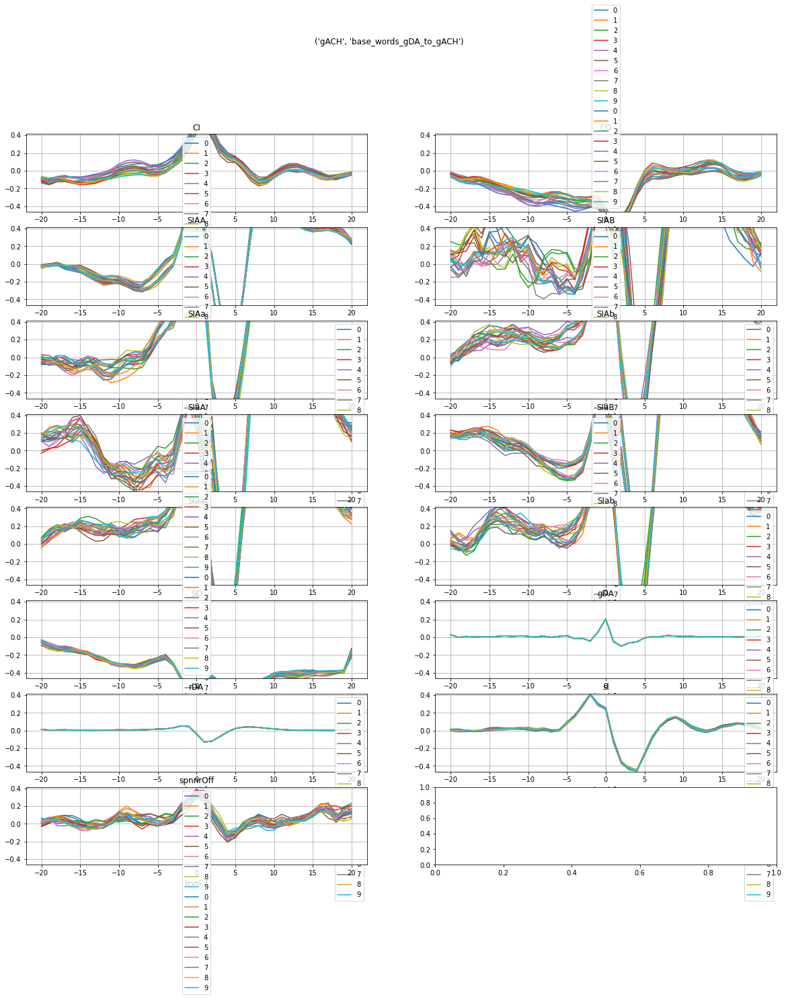

rDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.014900   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.014551   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.013800   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.012805   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.016260   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.013758   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.015013   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.012692   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.015313   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.014909   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.006252   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.003710   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.005667   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.005419   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.005384   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.007262   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.005850   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.005354   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.004793   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.007000   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.008170   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.006767   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.008036   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.008102   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.006675   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.007371   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.006126   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.009669   
                                                   /gACH_0_4_base_s

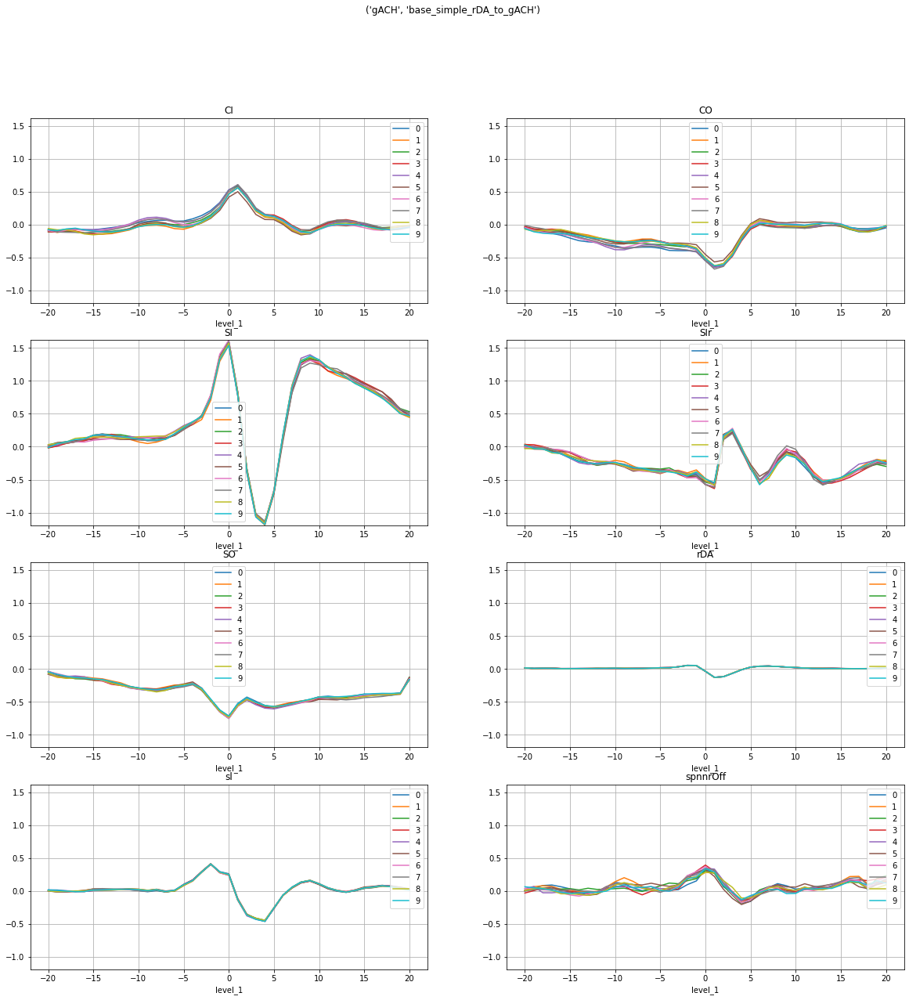

CI  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.125871   
                                                   /gACH_0_6_base_simple_run_num__1 -0.137748   
                                                   /gACH_0_6_base_simple_run_num__2 -0.167817   
                                                   /gACH_0_6_base_simple_run_num__3 -0.155050   
                                                   /gACH_0_6_base_simple_run_num__4 -0.118709   
                                                   /gACH_0_6_base_simple_run_num__5 -0.142816   
                                                   /gACH_0_6_base_simple_run_num__6 -0.139611   
                                                   /gACH_0_6_base_simple_run_num__7 -0.115853   
                                                   /gACH_0_6_base_simple_run_num__8 -0.108467   
                                                   /gACH_0_6_base_simple_run_num__9 -0.124108   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.148566   
                                                   /gACH_0_6_base_simple_run_num__1 -0.169289   
                                                   /gACH_0_6_base_simple_run_num__2 -0.165919   
                                                   /gACH_0_6_base_simple_run_num__3 -0.162545   
                                                   /gACH_0_6_base_simple_run_num__4 -0.138085   
                                                   /gACH_0_6_base_simple_run_num__5 -0.154031   
                                                   /gACH_0_6_base_simple_run_num__6 -0.157809   
                                                   /gACH_0_6_base_simple_run_num__7 -0.157134   
                                                   /gACH_0_6_base_simple_run_num__8 -0.122963   
                                                   /gACH_0_6_base_simple_run_num__9 -0.138890   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.105203   
                                                   /gACH_0_6_base_simple_run_num__1 -0.128936   
                                                   /gACH_0_6_base_simple_run_num__2 -0.136388   
                                                   /gACH_0_6_base_simple_run_num__3 -0.130197   
                                                   /gACH_0_6_base_simple_run_num__4 -0.100029   
                                                   /gACH_0_6_base_simple_run_num__5 -0.110249   
                                                   /gACH_0_6_base_simple_run_num__6 -0.107462   
                                                   /gACH_0_6_base_simple_run_num__7 -0.142712   
                                                   /gACH_0_6_base_simple_run_num__8 -0.099560   
                                                   /gACH_0_6_base_simple_run_num__9 -0.097829   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh\

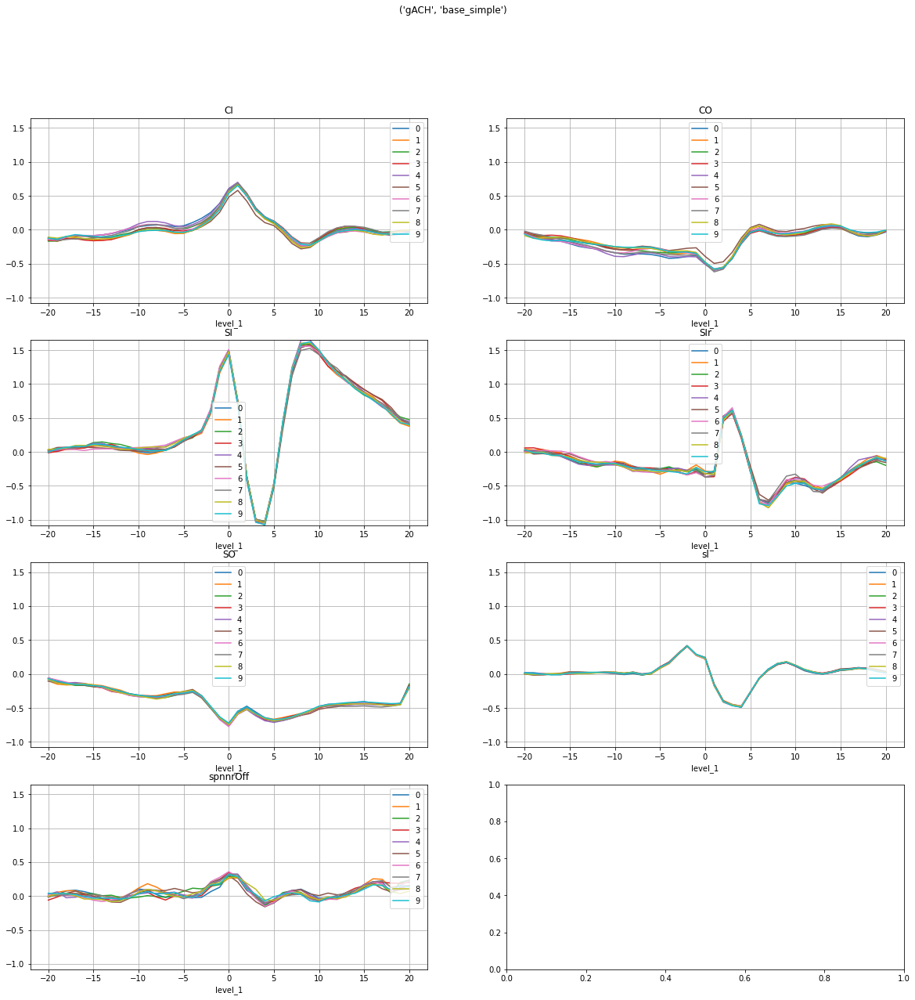

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.126808   
                                                   /gACH_0_7_base_words_run_num__1 -0.138697   
                                                   /gACH_0_7_base_words_run_num__2 -0.168607   
                                                   /gACH_0_7_base_words_run_num__3 -0.155958   
                                                   /gACH_0_7_base_words_run_num__4 -0.119369   
                                                   /gACH_0_7_base_words_run_num__5 -0.143622   
                                                   /gACH_0_7_base_words_run_num__6 -0.140452   
                                                   /gACH_0_7_base_words_run_num__7 -0.116233   
                                                   /gACH_0_7_base_words_run_num__8 -0.109386   
                                                   /gACH_0_7_base_words_run_num__9 -0.125273   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.147245   
                                                   /gACH_0_7_base_words_run_num__1 -0.167794   
                                                   /gACH_0_7_base_words_run_num__2 -0.164317   
                                                   /gACH_0_7_base_words_run_num__3 -0.161102   
                                                   /gACH_0_7_base_words_run_num__4 -0.136617   
                                                   /gACH_0_7_base_words_run_num__5 -0.152242   
                                                   /gACH_0_7_base_words_run_num__6 -0.156604   
                                                   /gACH_0_7_base_words_run_num__7 -0.155157   
                                                   /gACH_0_7_base_words_run_num__8 -0.121299   
                                                   /gACH_0_7_base_words_run_num__9 -0.137652   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.102380   
                                                   /gACH_0_7_base_words_run_num__1 -0.125742   
                                                   /gACH_0_7_base_words_run_num__2 -0.133040   
                                                   /gACH_0_7_base_words_run_num__3 -0.126984   
                                                   /gACH_0_7_base_words_run_num__4 -0.097125   
                                                   /gACH_0_7_base_words_run_num__5 -0.106598   
                                                   /gACH_0_7_base_words_run_num__6 -0.104755   
                                                   /gACH_0_7_base_words_run_num__7 -0.138962   
                                                   /gACH_0_7_base_words_run_num__8 -0.096296   
                                                   /gACH_0_7_base_words_run_num__9 -0.094995   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gAC

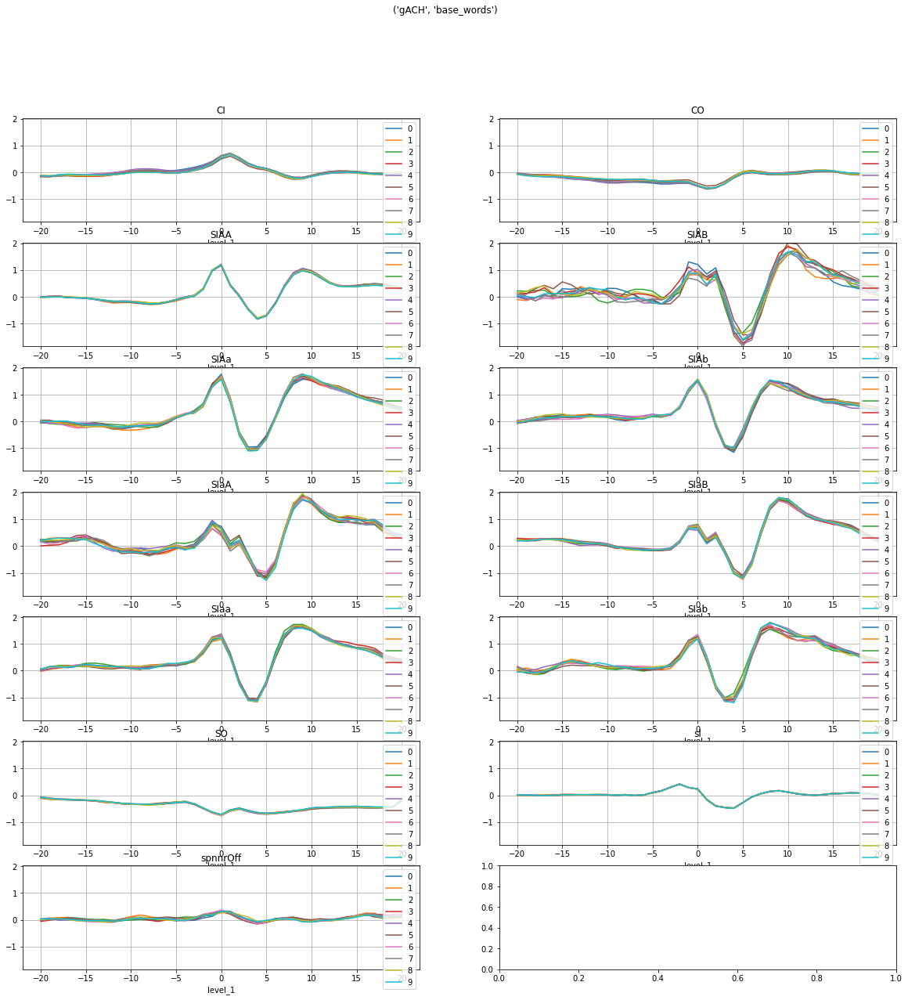

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.045315   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.045758   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.048210   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.047754   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.049257   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.049412   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.046982   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.042740   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.046024   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.049494   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0 -0.000233   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1 -0.000400   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2 -0.000792   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.001380   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4 -0.002634   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5 -0.003638   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6 -0.001027   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7 -0.000415   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8 -0.004355   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9 -0.000024   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.020419   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.019219   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.020001   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.019069   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.020544   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.021104   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.014722   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.017944   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.019170   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.015911   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /g

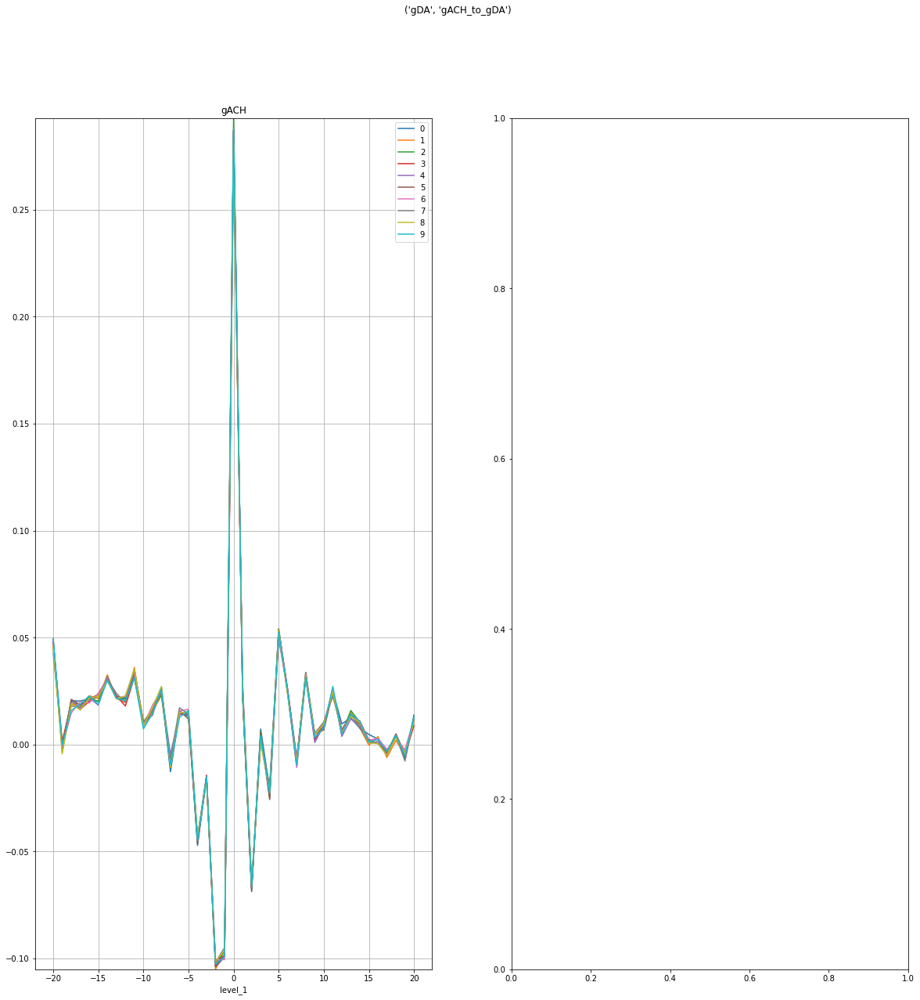

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.025423   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.024583   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.027587   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.028219   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.028970   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.029433   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.027270   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.022424   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.026520   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9  0.029402   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0 -0.001400   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1 -0.001108   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2 -0.001147   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3 -0.000513   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4 -0.002836   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5 -0.004148   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6 -0.001705   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7 -0.000565   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8 -0.005221   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9 -0.000167   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.012807   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.011678   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.013325   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.012016   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.013707   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.014356   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.007728   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.011291   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.0117

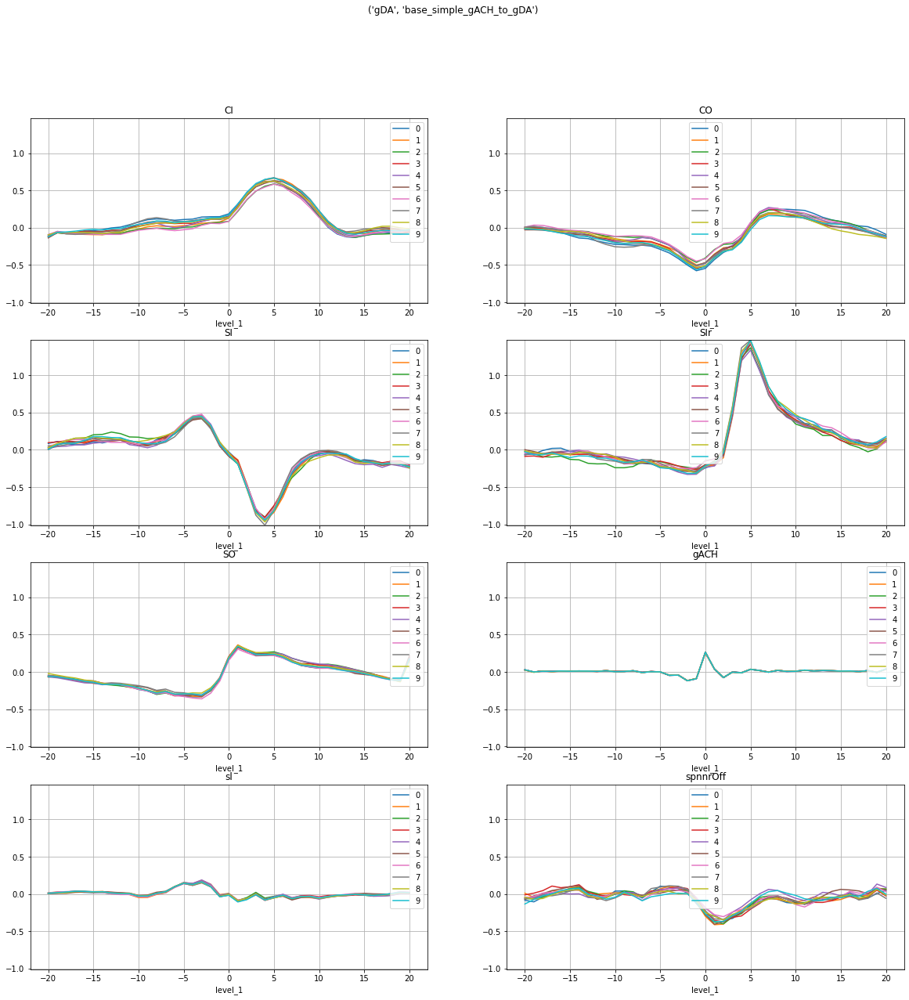

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.026761   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.025580   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.028616   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.029809   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.030401   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.031101   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.028660   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.023795   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.027787   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9  0.030821   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0 -0.001478   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1 -0.001198   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2 -0.001106   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3 -0.000497   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4 -0.002726   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5 -0.004217   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6 -0.001571   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7 -0.000511   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8 -0.005153   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9 -0.000015   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.013224   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.011861   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.013655   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.012542   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.014247   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.014893   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.008101   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.011744   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.012156   
                               

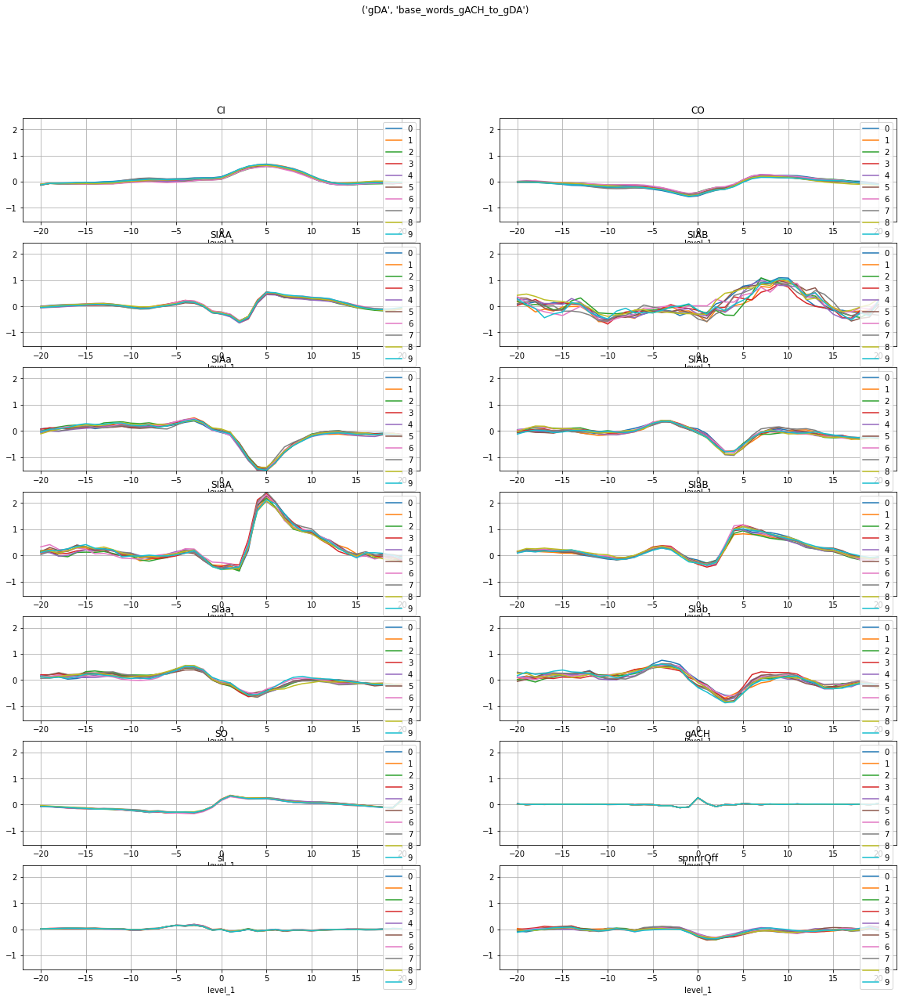

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.147308   
                                                   /gDA_1_3_base_simple_run_num__1 -0.152325   
                                                   /gDA_1_3_base_simple_run_num__2 -0.155248   
                                                   /gDA_1_3_base_simple_run_num__3 -0.154867   
                                                   /gDA_1_3_base_simple_run_num__4 -0.135725   
                                                   /gDA_1_3_base_simple_run_num__5 -0.164496   
                                                   /gDA_1_3_base_simple_run_num__6 -0.111790   
                                                   /gDA_1_3_base_simple_run_num__7 -0.131979   
                                                   /gDA_1_3_base_simple_run_num__8 -0.127230   
                                                   /gDA_1_3_base_simple_run_num__9 -0.149876   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.100541   
                                                   /gDA_1_3_base_simple_run_num__1 -0.095222   
                                                   /gDA_1_3_base_simple_run_num__2 -0.107880   
                                                   /gDA_1_3_base_simple_run_num__3 -0.091226   
                                                   /gDA_1_3_base_simple_run_num__4 -0.088052   
                                                   /gDA_1_3_base_simple_run_num__5 -0.094249   
                                                   /gDA_1_3_base_simple_run_num__6 -0.080201   
                                                   /gDA_1_3_base_simple_run_num__7 -0.101594   
                                                   /gDA_1_3_base_simple_run_num__8 -0.102394   
                                                   /gDA_1_3_base_simple_run_num__9 -0.089235   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.096802   
                                                   /gDA_1_3_base_simple_run_num__1 -0.087077   
                                                   /gDA_1_3_base_simple_run_num__2 -0.109230   
                                                   /gDA_1_3_base_simple_run_num__3 -0.090078   
                                                   /gDA_1_3_base_simple_run_num__4 -0.085821   
                                                   /gDA_1_3_base_simple_run_num__5 -0.082070   
                                                   /gDA_1_3_base_simple_run_num__6 -0.093930   
                                                   /gDA_1_3_base_simple_run_num__7 -0.105275   
                                                   /gDA_1_3_base_simple_run_num__8 -0.090502   
                                                   /gDA_1_3_base_simple_run_num__9 -0.072148   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

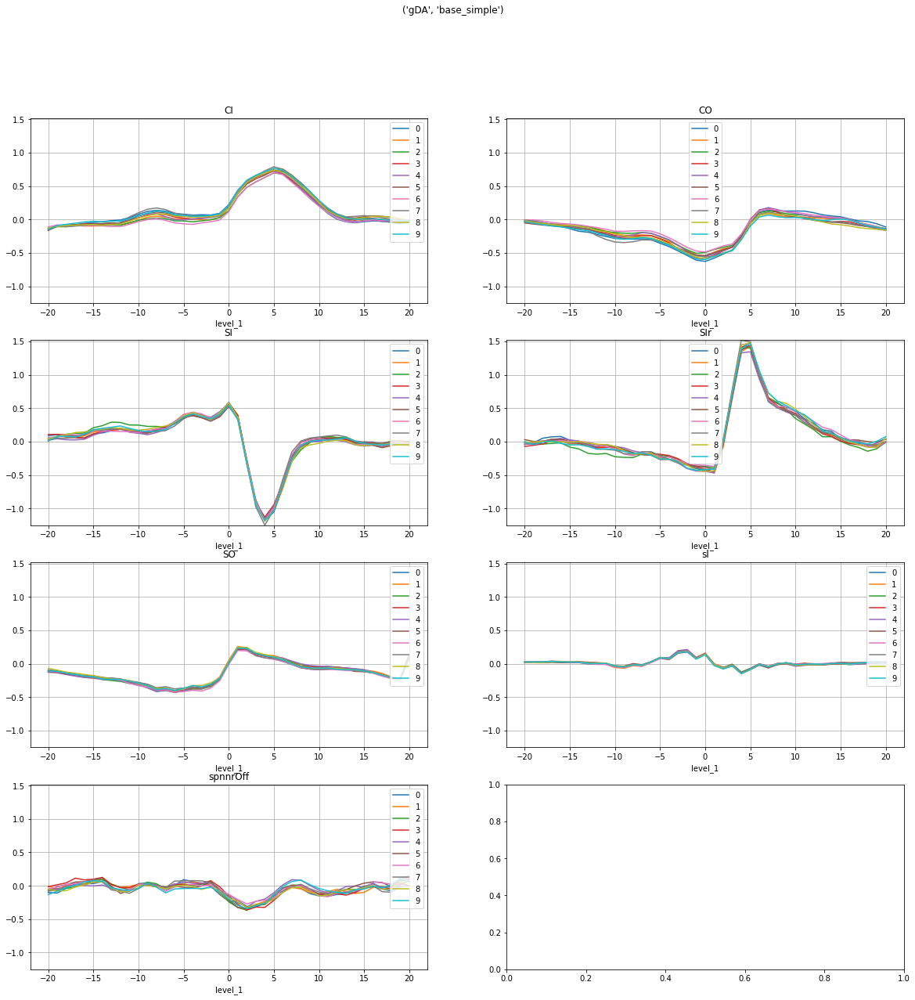

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.148675   
                                                   /gDA_1_4_base_words_run_num__1 -0.152685   
                                                   /gDA_1_4_base_words_run_num__2 -0.156439   
                                                   /gDA_1_4_base_words_run_num__3 -0.155883   
                                                   /gDA_1_4_base_words_run_num__4 -0.137014   
                                                   /gDA_1_4_base_words_run_num__5 -0.165148   
                                                   /gDA_1_4_base_words_run_num__6 -0.113426   
                                                   /gDA_1_4_base_words_run_num__7 -0.133197   
                                                   /gDA_1_4_base_words_run_num__8 -0.128002   
                                                   /gDA_1_4_base_words_run_num__9 -0.150862   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.100699   
                                                   /gDA_1_4_base_words_run_num__1 -0.094519   
                                                   /gDA_1_4_base_words_run_num__2 -0.107285   
                                                   /gDA_1_4_base_words_run_num__3 -0.090380   
                                                   /gDA_1_4_base_words_run_num__4 -0.087432   
                                                   /gDA_1_4_base_words_run_num__5 -0.093339   
                                                   /gDA_1_4_base_words_run_num__6 -0.080099   
                                                   /gDA_1_4_base_words_run_num__7 -0.101481   
                                                   /gDA_1_4_base_words_run_num__8 -0.101204   
                                                   /gDA_1_4_base_words_run_num__9 -0.088905   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.096333   
                                                   /gDA_1_4_base_words_run_num__1 -0.085737   
                                                   /gDA_1_4_base_words_run_num__2 -0.107648   
                                                   /gDA_1_4_base_words_run_num__3 -0.088141   
                                                   /gDA_1_4_base_words_run_num__4 -0.084319   
                                                   /gDA_1_4_base_words_run_num__5 -0.080342   
                                                   /gDA_1_4_base_words_run_num__6 -0.092995   
                                                   /gDA_1_4_base_words_run_num__7 -0.104543   
                                                   /gDA_1_4_base_words_run_num__8 -0.088425   
                                                   /gDA_1_4_base_words_run_num__9 -0.071056   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.077423   
 

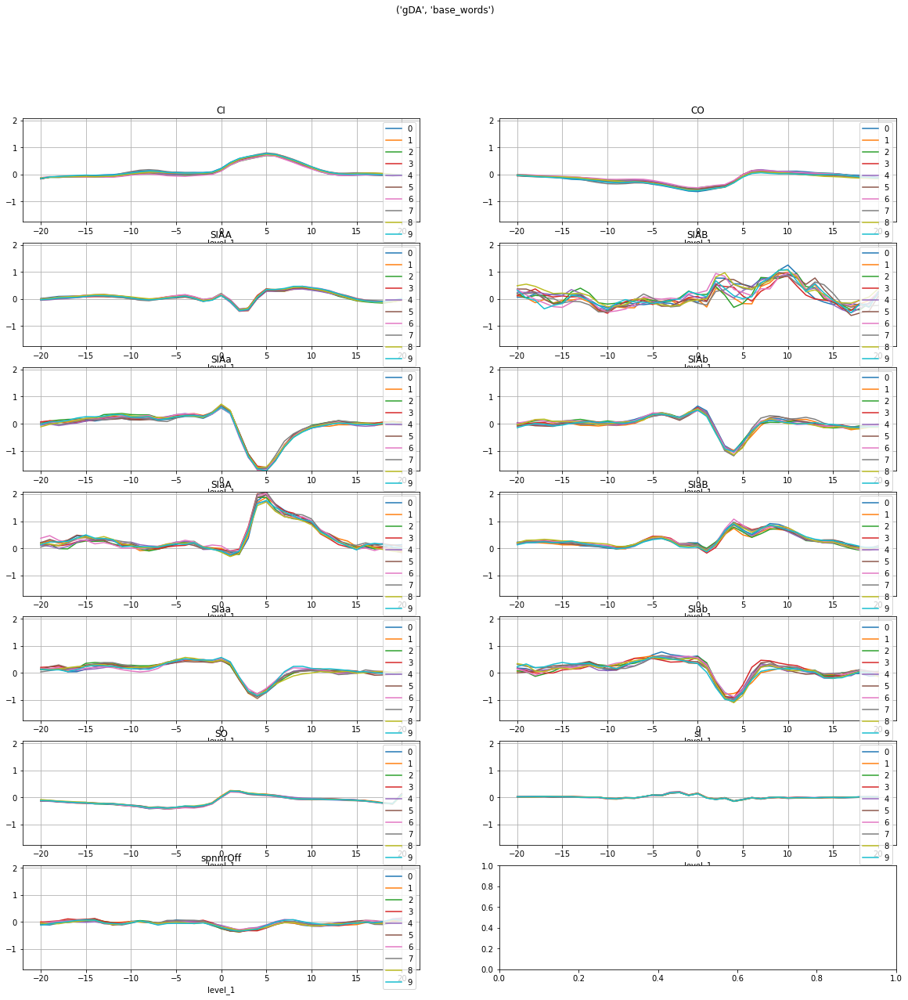

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.032392   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.034980   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.030169   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.034127   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.035901   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.033100   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.034140   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.034251   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.036964   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.035433   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.004073   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.000182   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.005439   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.001674   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.002061   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.001832   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6 -0.001392   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.002370   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8 -0.000479   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.002607   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.014402   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.015547   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.013313   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.013540   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.014933   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.014283   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.018981   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.014888   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.016627   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.014357   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /r

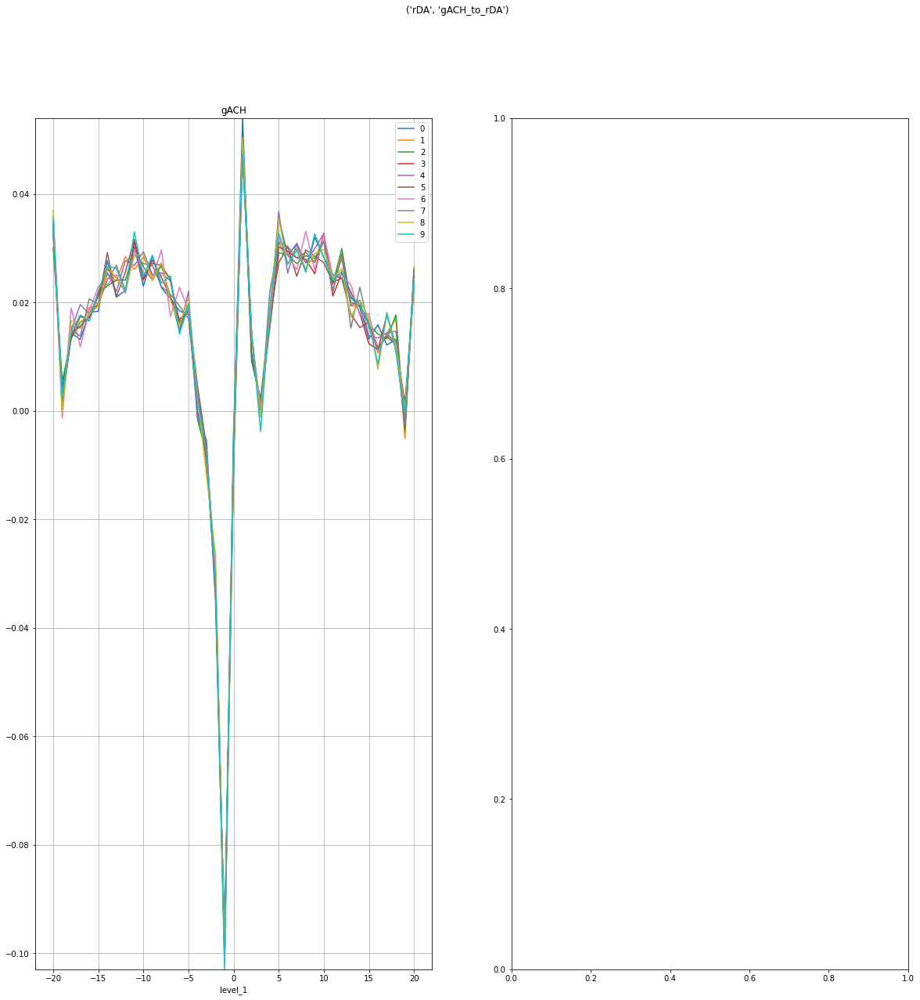

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.025079   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.025657   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.019909   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.026766   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.027415   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.025641   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.027336   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.024889   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.028753   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9  0.026341   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.003636   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1 -0.001121   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.005012   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.000866   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.000556   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.001635   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6 -0.002062   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.001664   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8 -0.002102   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9  0.002432   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.012311   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.014096   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.010312   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.011525   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.012318   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.012796   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.017294   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.012327   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.0143

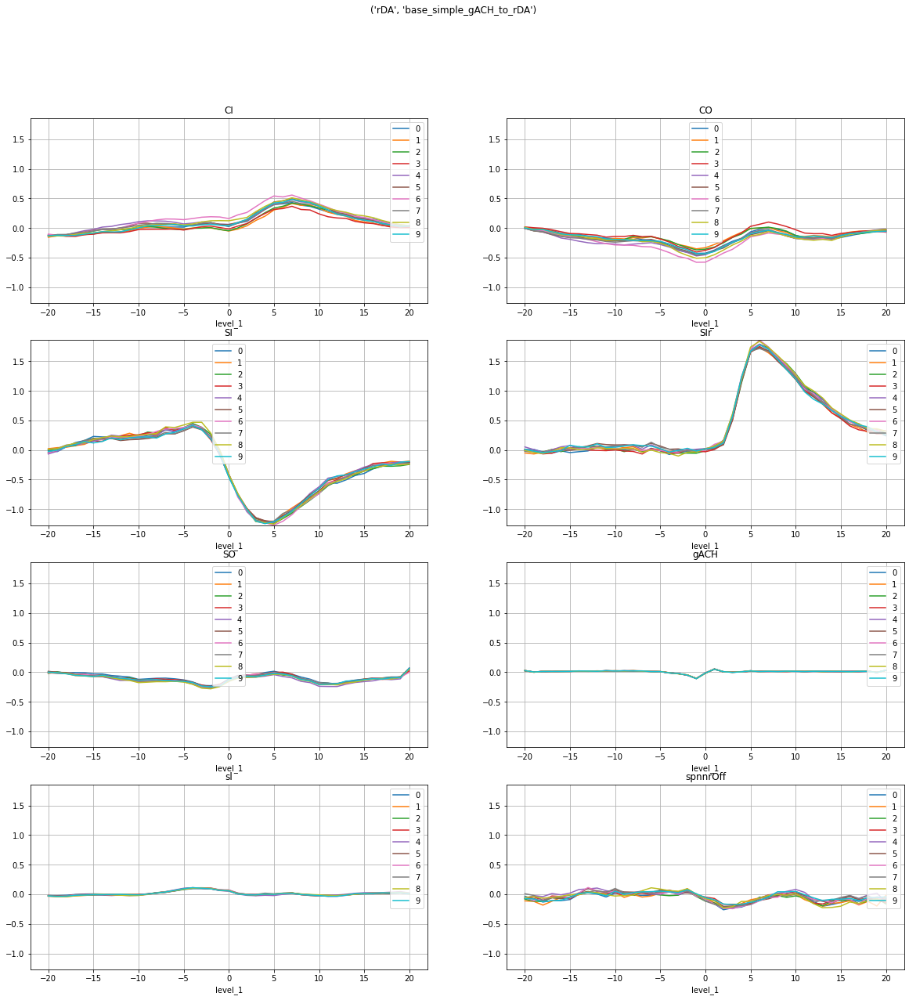

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.025393   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.026089   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.020601   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.026778   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.027592   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.025970   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.027472   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.025527   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.028904   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9  0.026244   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.004143   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1 -0.000911   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.005187   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.001185   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.000944   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.001851   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6 -0.001720   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.001892   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8 -0.001794   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9  0.002723   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.012443   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.014463   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.010439   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.011713   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.012642   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.012893   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.017565   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.012614   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.014498   
                               

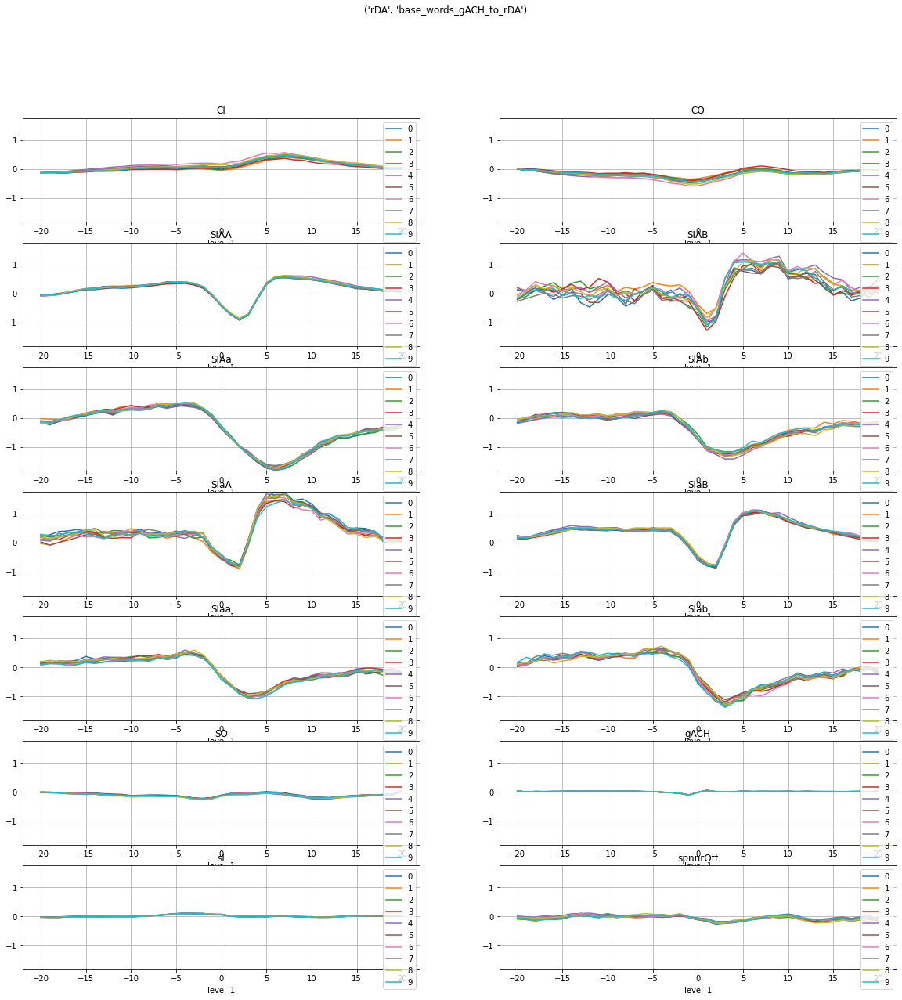

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.185619   
                                                   /rDA_2_3_base_simple_run_num__1 -0.202549   
                                                   /rDA_2_3_base_simple_run_num__2 -0.172288   
                                                   /rDA_2_3_base_simple_run_num__3 -0.162199   
                                                   /rDA_2_3_base_simple_run_num__4 -0.159171   
                                                   /rDA_2_3_base_simple_run_num__5 -0.174511   
                                                   /rDA_2_3_base_simple_run_num__6 -0.153069   
                                                   /rDA_2_3_base_simple_run_num__7 -0.182504   
                                                   /rDA_2_3_base_simple_run_num__8 -0.183216   
                                                   /rDA_2_3_base_simple_run_num__9 -0.181159   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.188184   
                                                   /rDA_2_3_base_simple_run_num__1 -0.191286   
                                                   /rDA_2_3_base_simple_run_num__2 -0.164679   
                                                   /rDA_2_3_base_simple_run_num__3 -0.170856   
                                                   /rDA_2_3_base_simple_run_num__4 -0.173035   
                                                   /rDA_2_3_base_simple_run_num__5 -0.178166   
                                                   /rDA_2_3_base_simple_run_num__6 -0.178945   
                                                   /rDA_2_3_base_simple_run_num__7 -0.171013   
                                                   /rDA_2_3_base_simple_run_num__8 -0.197567   
                                                   /rDA_2_3_base_simple_run_num__9 -0.183287   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.174089   
                                                   /rDA_2_3_base_simple_run_num__1 -0.178454   
                                                   /rDA_2_3_base_simple_run_num__2 -0.146912   
                                                   /rDA_2_3_base_simple_run_num__3 -0.169883   
                                                   /rDA_2_3_base_simple_run_num__4 -0.137462   
                                                   /rDA_2_3_base_simple_run_num__5 -0.157976   
                                                   /rDA_2_3_base_simple_run_num__6 -0.166020   
                                                   /rDA_2_3_base_simple_run_num__7 -0.146895   
                                                   /rDA_2_3_base_simple_run_num__8 -0.175887   
                                                   /rDA_2_3_base_simple_run_num__9 -0.164635   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA

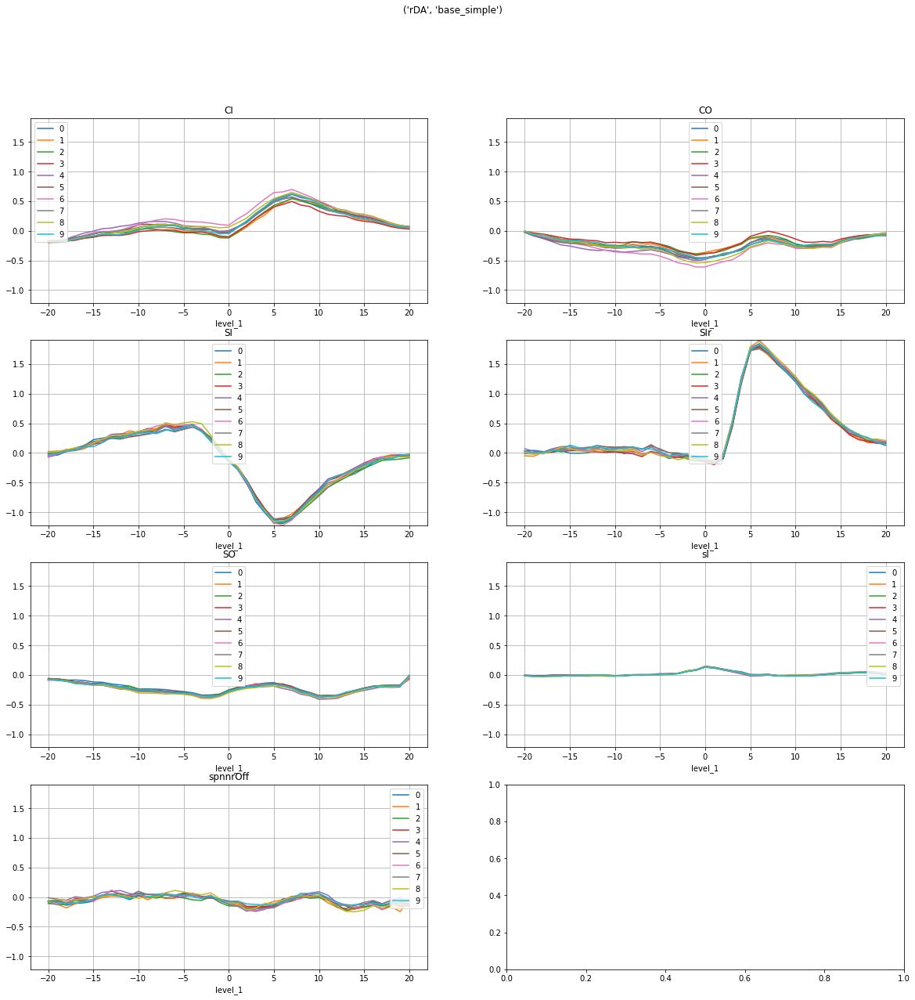

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.187955   
                                                   /rDA_2_4_base_words_run_num__1 -0.203398   
                                                   /rDA_2_4_base_words_run_num__2 -0.173175   
                                                   /rDA_2_4_base_words_run_num__3 -0.163729   
                                                   /rDA_2_4_base_words_run_num__4 -0.160401   
                                                   /rDA_2_4_base_words_run_num__5 -0.175633   
                                                   /rDA_2_4_base_words_run_num__6 -0.154400   
                                                   /rDA_2_4_base_words_run_num__7 -0.183682   
                                                   /rDA_2_4_base_words_run_num__8 -0.184265   
                                                   /rDA_2_4_base_words_run_num__9 -0.182767   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.188576   
                                                   /rDA_2_4_base_words_run_num__1 -0.190442   
                                                   /rDA_2_4_base_words_run_num__2 -0.163437   
                                                   /rDA_2_4_base_words_run_num__3 -0.171015   
                                                   /rDA_2_4_base_words_run_num__4 -0.172163   
                                                   /rDA_2_4_base_words_run_num__5 -0.177206   
                                                   /rDA_2_4_base_words_run_num__6 -0.178004   
                                                   /rDA_2_4_base_words_run_num__7 -0.171214   
                                                   /rDA_2_4_base_words_run_num__8 -0.196197   
                                                   /rDA_2_4_base_words_run_num__9 -0.182846   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.173637   
                                                   /rDA_2_4_base_words_run_num__1 -0.176531   
                                                   /rDA_2_4_base_words_run_num__2 -0.144229   
                                                   /rDA_2_4_base_words_run_num__3 -0.169270   
                                                   /rDA_2_4_base_words_run_num__4 -0.135309   
                                                   /rDA_2_4_base_words_run_num__5 -0.155701   
                                                   /rDA_2_4_base_words_run_num__6 -0.163814   
                                                   /rDA_2_4_base_words_run_num__7 -0.146517   
                                                   /rDA_2_4_base_words_run_num__8 -0.173083   
                                                   /rDA_2_4_base_words_run_num__9 -0.163371   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.144856   
 

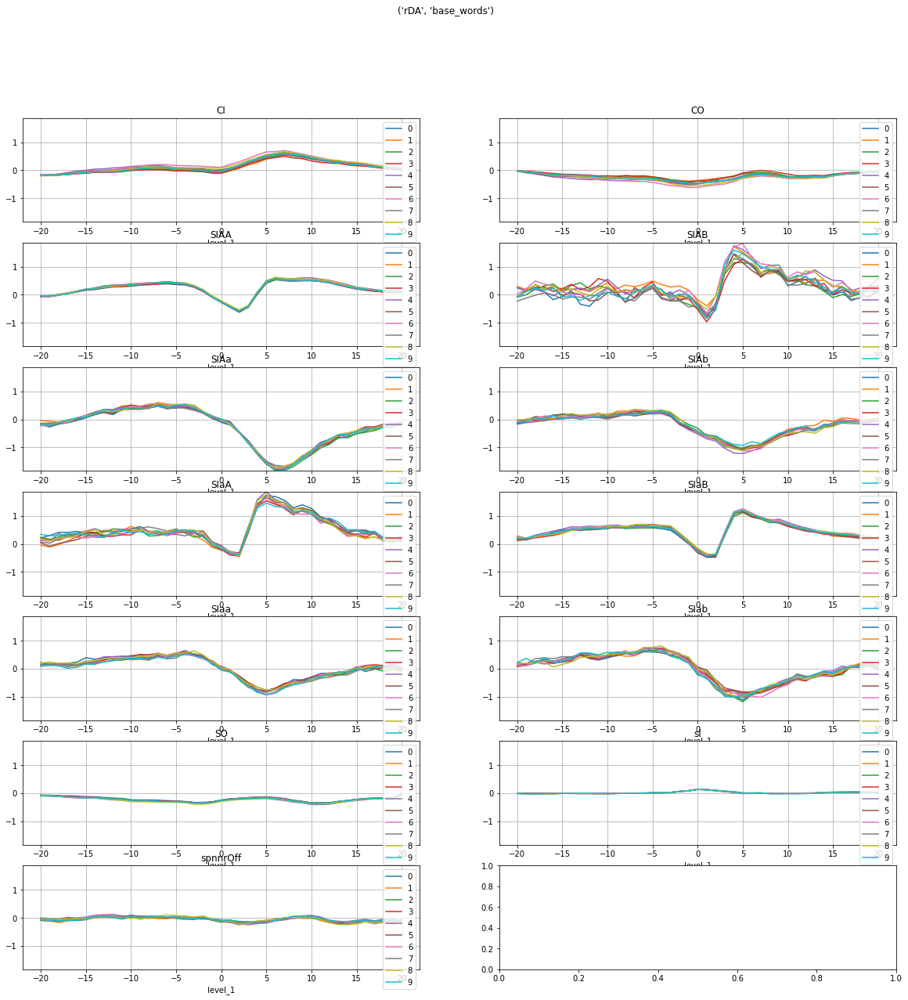

fig_folder ('Figure_5_g5', 'f5*-ft')
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\Figure_5_g5\all\f5*-ft\coefs\*_best_coeffs.h5


gDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.009871   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.007783   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.008329   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.007328   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.007799   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.008212   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.008640   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.009505   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.008042   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.009922   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.003873   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.004361   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.003964   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.004627   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.003794   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.002581   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.003672   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.004332   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.003507   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.004830   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_0_gDA_to_gACH_run_num__0  0.005662   
                                                   /gACH_0_0_gDA_to_gACH_run_num__1  0.004447   
                                                   /gACH_0_0_gDA_to_gACH_run_num__2  0.005217   
                                                   /gACH_0_0_gDA_to_gACH_run_num__3  0.003977   
                                                   /gACH_0_0_gDA_to_gACH_run_num__4  0.003687   
                                                   /gACH_0_0_gDA_to_gACH_run_num__5  0.004695   
                                                   /gACH_0_0_gDA_to_gACH_run_num__6  0.004779   
                                                   /gACH_0_0_gDA_to_gACH_run_num__7  0.005030   
                                                   /gACH_0_0_gDA_to_gACH_run_num__8  0.004114   
                                                   /gACH_0_0_gDA_to_gACH_run_num__9  0.004374   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

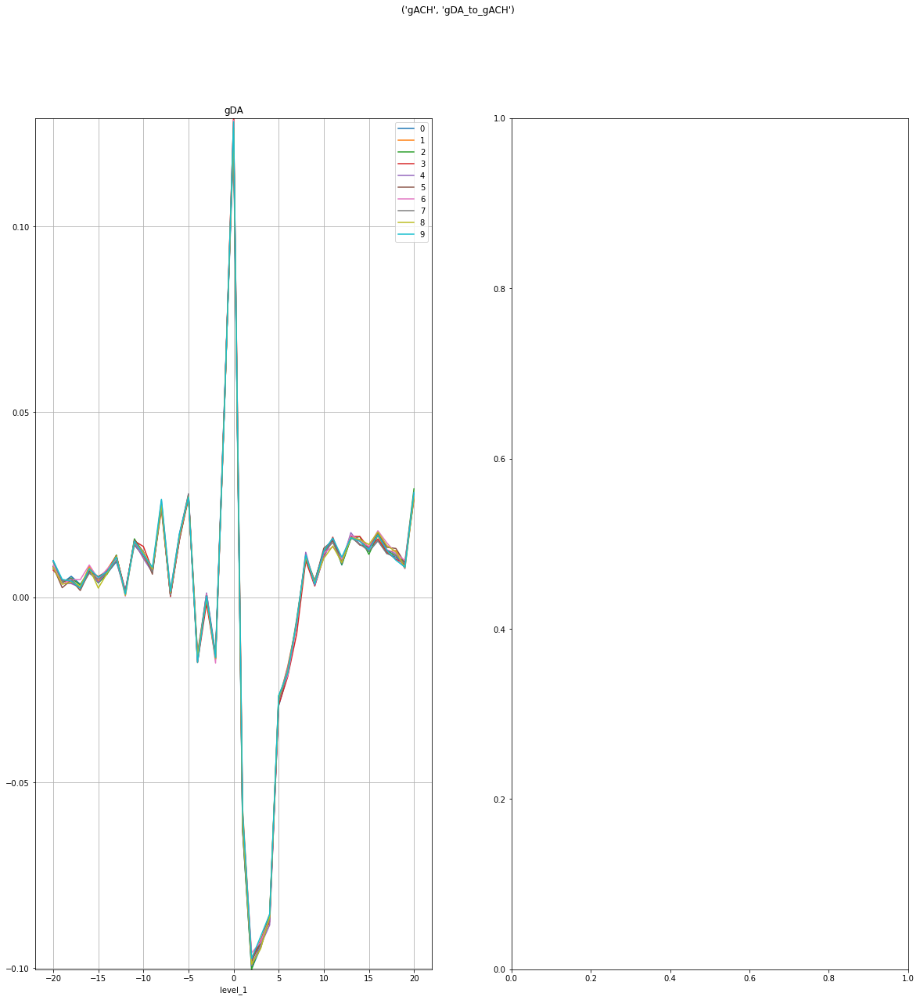

rDA  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.019116   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.019269   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.020643   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.018029   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.019427   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.018771   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.019665   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.019354   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.017169   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.019288   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.010157   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.010564   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.012085   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.009545   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.010796   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.010372   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.011330   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.011072   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.009428   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.009860   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_1_rDA_to_gACH_run_num__0  0.008532   
                                                   /gACH_0_1_rDA_to_gACH_run_num__1  0.007605   
                                                   /gACH_0_1_rDA_to_gACH_run_num__2  0.007356   
                                                   /gACH_0_1_rDA_to_gACH_run_num__3  0.007138   
                                                   /gACH_0_1_rDA_to_gACH_run_num__4  0.007119   
                                                   /gACH_0_1_rDA_to_gACH_run_num__5  0.006760   
                                                   /gACH_0_1_rDA_to_gACH_run_num__6  0.007644   
                                                   /gACH_0_1_rDA_to_gACH_run_num__7  0.008446   
                                                   /gACH_0_1_rDA_to_gACH_run_num__8  0.007660   
                                                   /gACH_0_1_rDA_to_gACH_run_num__9  0.007107   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh

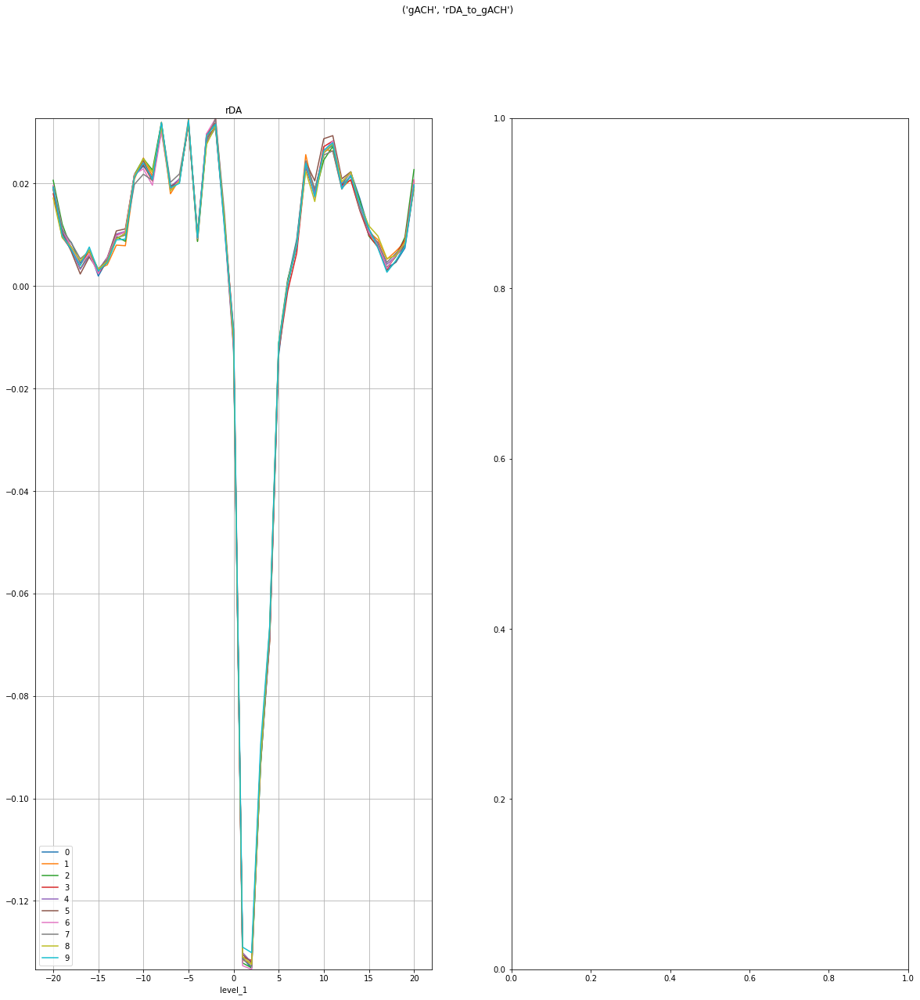

gDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.012467   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.011229   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.012475   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.010601   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.011042   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.011750   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.012636   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.013114   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8  0.012469   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9  0.013017   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.005022   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.005025   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.005082   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.005474   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.004600   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.003810   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.004679   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.005175   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__8  0.004104   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__9  0.005110   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_2_base_simple_gDA_to_gACH_run_num__0  0.007911   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__1  0.006582   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__2  0.008406   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__3  0.006776   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__4  0.006358   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__5  0.006881   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__6  0.007771   
                                                   /gACH_0_2_base_simple_gDA_to_gACH_run_num__7  0.007591   
                                                   /gACH_0_2_base_s

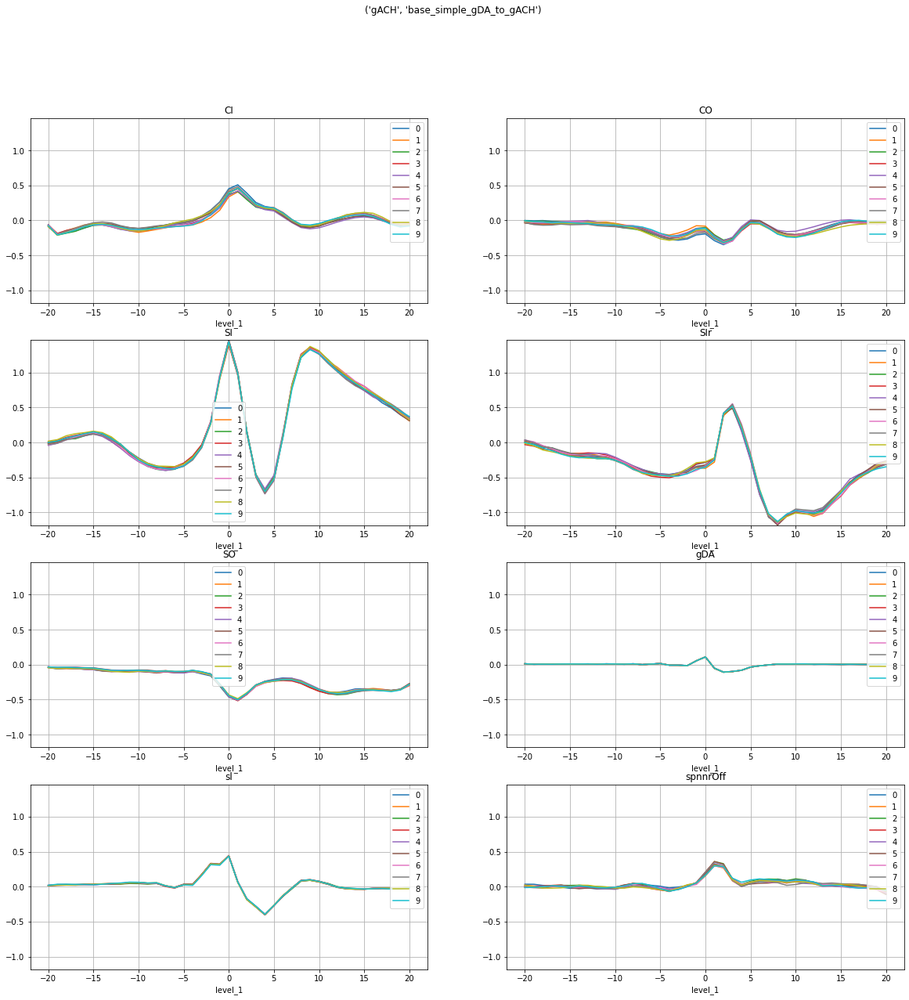

rDA  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.014133   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.014536   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__2  0.016539   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__3  0.013655   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__4  0.013733   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__5  0.014217   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__6  0.015316   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__7  0.014839   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__8  0.013097   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__9  0.014137   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_3_base_words_gDA_to_gACH_run_num__0       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__1       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__2       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__3       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__4       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__5       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__6       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__7       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__8       NaN   
                                                   /gACH_0_3_base_words_gDA_to_gACH_run_num__9       NaN   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__0  0.008659   
                                                   /gACH_0_5_base_words_gDA_to_gACH_run_num__1  0.009111

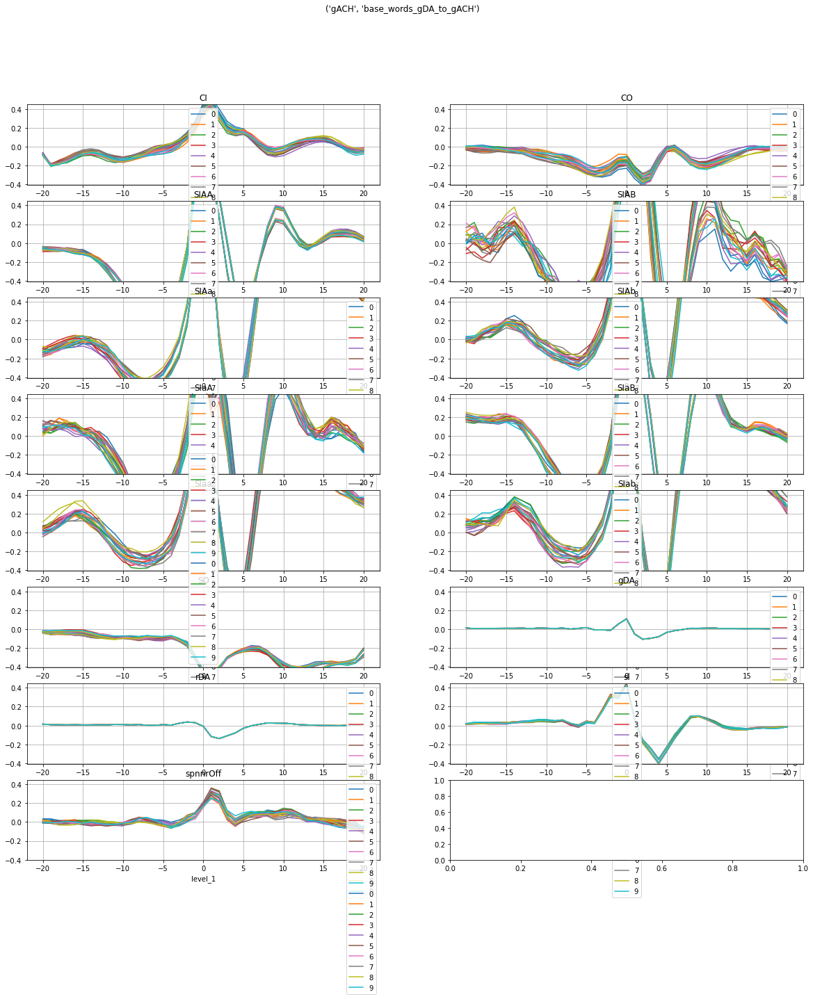

rDA  \
                                                                                                      -20   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.015424   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.015721   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.017733   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.014941   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.014930   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.015276   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.016616   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.015840   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.014456   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.015251   

                                                                                                           \
                                                                                                      -19   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.009351   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.009758   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.011428   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.008894   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.010092   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.009459   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.010892   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.009989   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__8  0.009353   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__9  0.008990   

                                                                                                           \
                                                                                                      -18   
fn                                                 key                                                      
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_4_base_simple_rDA_to_gACH_run_num__0  0.009766   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__1  0.008417   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__2  0.008992   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__3  0.008560   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__4  0.008492   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__5  0.008154   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__6  0.009323   
                                                   /gACH_0_4_base_simple_rDA_to_gACH_run_num__7  0.009627   
                                                   /gACH_0_4_base_s

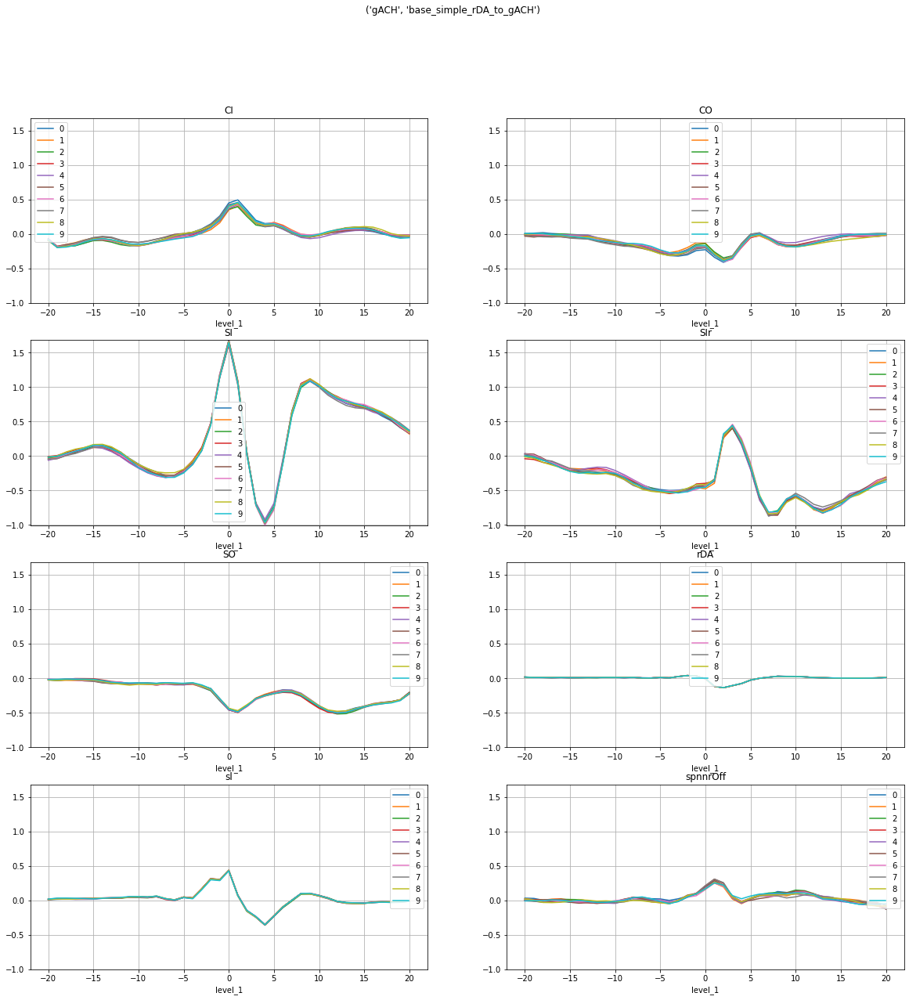

CI  \
                                                                                          -20   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.050008   
                                                   /gACH_0_6_base_simple_run_num__1 -0.062598   
                                                   /gACH_0_6_base_simple_run_num__2 -0.064621   
                                                   /gACH_0_6_base_simple_run_num__3 -0.050953   
                                                   /gACH_0_6_base_simple_run_num__4 -0.066813   
                                                   /gACH_0_6_base_simple_run_num__5 -0.071570   
                                                   /gACH_0_6_base_simple_run_num__6 -0.064588   
                                                   /gACH_0_6_base_simple_run_num__7 -0.076738   
                                                   /gACH_0_6_base_simple_run_num__8 -0.075419   
                                                   /gACH_0_6_base_simple_run_num__9 -0.065768   

                                                                                               \
                                                                                          -19   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.191680   
                                                   /gACH_0_6_base_simple_run_num__1 -0.178193   
                                                   /gACH_0_6_base_simple_run_num__2 -0.196061   
                                                   /gACH_0_6_base_simple_run_num__3 -0.175052   
                                                   /gACH_0_6_base_simple_run_num__4 -0.186547   
                                                   /gACH_0_6_base_simple_run_num__5 -0.175581   
                                                   /gACH_0_6_base_simple_run_num__6 -0.195695   
                                                   /gACH_0_6_base_simple_run_num__7 -0.188553   
                                                   /gACH_0_6_base_simple_run_num__8 -0.195363   
                                                   /gACH_0_6_base_simple_run_num__9 -0.198134   

                                                                                               \
                                                                                          -18   
fn                                                 key                                          
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_6_base_simple_run_num__0 -0.176069   
                                                   /gACH_0_6_base_simple_run_num__1 -0.141979   
                                                   /gACH_0_6_base_simple_run_num__2 -0.176368   
                                                   /gACH_0_6_base_simple_run_num__3 -0.139453   
                                                   /gACH_0_6_base_simple_run_num__4 -0.167576   
                                                   /gACH_0_6_base_simple_run_num__5 -0.141992   
                                                   /gACH_0_6_base_simple_run_num__6 -0.172320   
                                                   /gACH_0_6_base_simple_run_num__7 -0.149768   
                                                   /gACH_0_6_base_simple_run_num__8 -0.171295   
                                                   /gACH_0_6_base_simple_run_num__9 -0.181063   

                                                                                               \
                                                                                          -17   
fn                                                 key                                          
C:\Users\Josh\

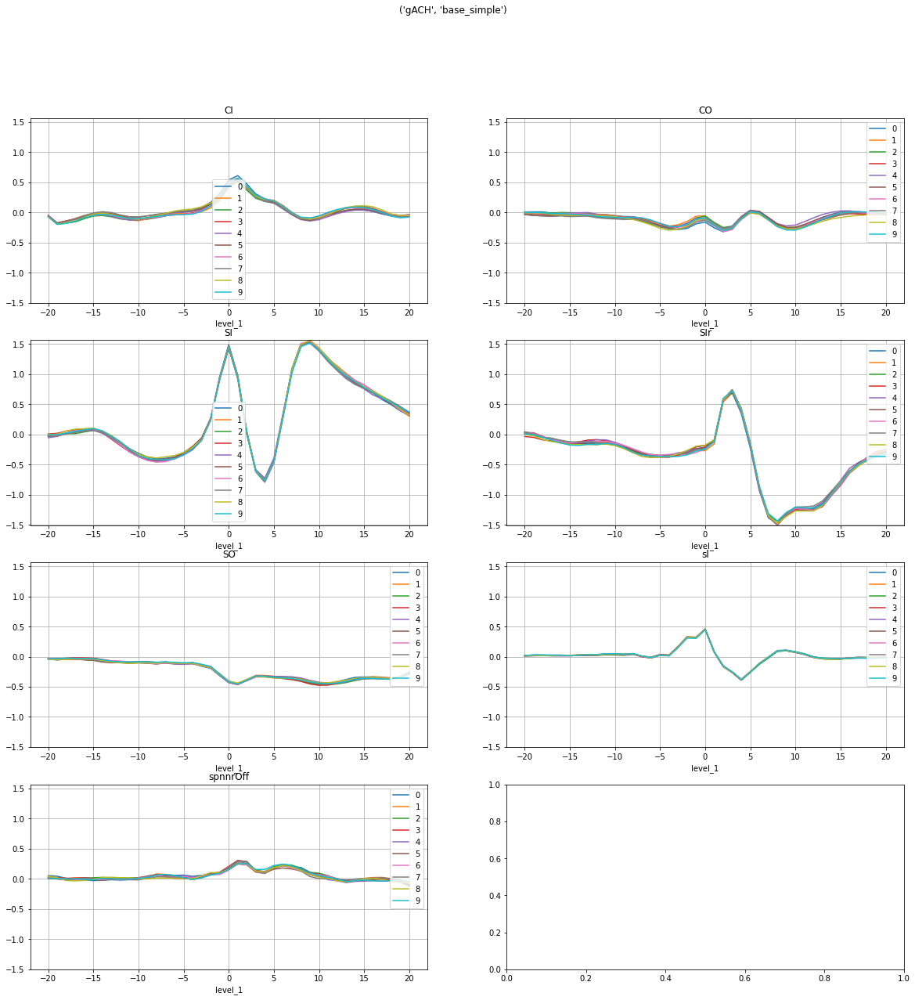

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.053689   
                                                   /gACH_0_7_base_words_run_num__1 -0.065188   
                                                   /gACH_0_7_base_words_run_num__2 -0.066757   
                                                   /gACH_0_7_base_words_run_num__3 -0.053121   
                                                   /gACH_0_7_base_words_run_num__4 -0.069572   
                                                   /gACH_0_7_base_words_run_num__5 -0.074395   
                                                   /gACH_0_7_base_words_run_num__6 -0.067549   
                                                   /gACH_0_7_base_words_run_num__7 -0.079538   
                                                   /gACH_0_7_base_words_run_num__8 -0.077855   
                                                   /gACH_0_7_base_words_run_num__9 -0.068023   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.192099   
                                                   /gACH_0_7_base_words_run_num__1 -0.178836   
                                                   /gACH_0_7_base_words_run_num__2 -0.196350   
                                                   /gACH_0_7_base_words_run_num__3 -0.176196   
                                                   /gACH_0_7_base_words_run_num__4 -0.187231   
                                                   /gACH_0_7_base_words_run_num__5 -0.175506   
                                                   /gACH_0_7_base_words_run_num__6 -0.196409   
                                                   /gACH_0_7_base_words_run_num__7 -0.190288   
                                                   /gACH_0_7_base_words_run_num__8 -0.195931   
                                                   /gACH_0_7_base_words_run_num__9 -0.199301   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gACH_0_7_base_words_run_num__0 -0.175685   
                                                   /gACH_0_7_base_words_run_num__1 -0.142617   
                                                   /gACH_0_7_base_words_run_num__2 -0.176475   
                                                   /gACH_0_7_base_words_run_num__3 -0.140814   
                                                   /gACH_0_7_base_words_run_num__4 -0.167594   
                                                   /gACH_0_7_base_words_run_num__5 -0.140753   
                                                   /gACH_0_7_base_words_run_num__6 -0.172769   
                                                   /gACH_0_7_base_words_run_num__7 -0.151854   
                                                   /gACH_0_7_base_words_run_num__8 -0.171661   
                                                   /gACH_0_7_base_words_run_num__9 -0.182095   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gAC

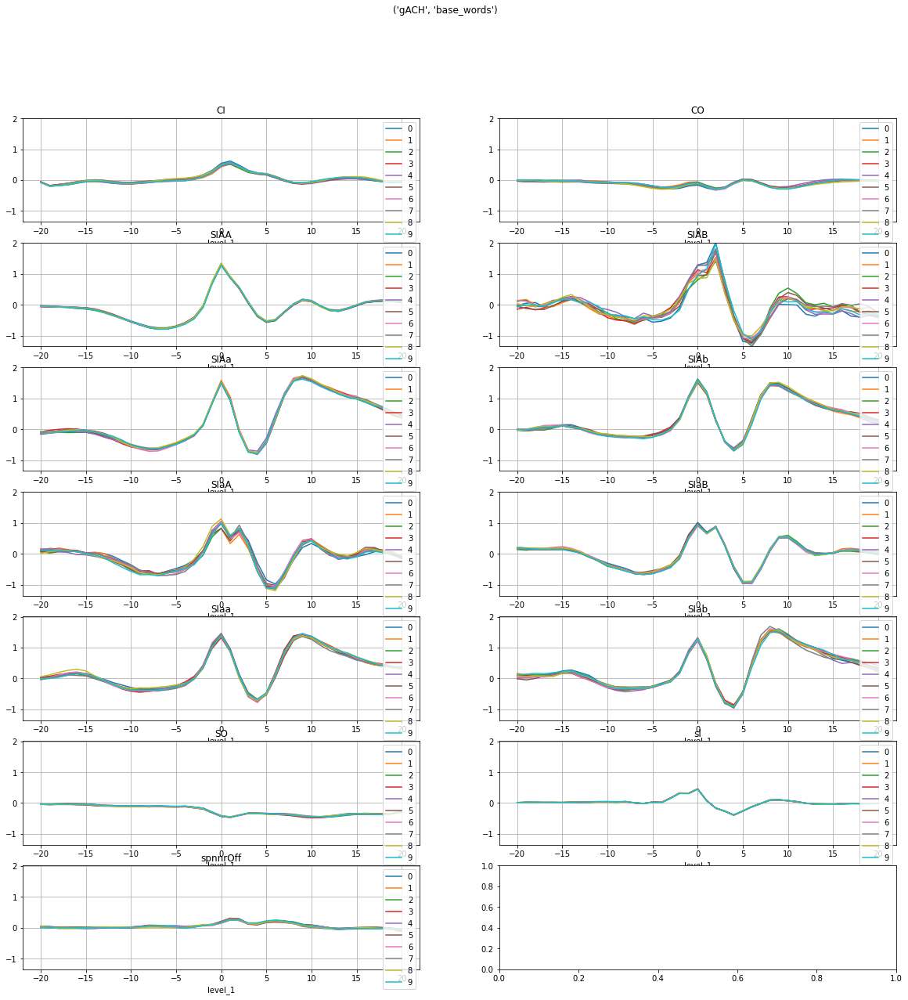

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.043061   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.040041   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.040978   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.040732   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.041208   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.038715   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.041561   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.039088   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.040759   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.040321   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.001712   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1 -0.000408   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.001819   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.001799   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.000478   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.002240   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.001082   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.003435   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.002745   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.000683   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_0_gACH_to_gDA_run_num__0  0.007809   
                                                   /gDA_1_0_gACH_to_gDA_run_num__1  0.010094   
                                                   /gDA_1_0_gACH_to_gDA_run_num__2  0.008568   
                                                   /gDA_1_0_gACH_to_gDA_run_num__3  0.011589   
                                                   /gDA_1_0_gACH_to_gDA_run_num__4  0.011099   
                                                   /gDA_1_0_gACH_to_gDA_run_num__5  0.009333   
                                                   /gDA_1_0_gACH_to_gDA_run_num__6  0.010788   
                                                   /gDA_1_0_gACH_to_gDA_run_num__7  0.009865   
                                                   /gDA_1_0_gACH_to_gDA_run_num__8  0.008433   
                                                   /gDA_1_0_gACH_to_gDA_run_num__9  0.012586   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /g

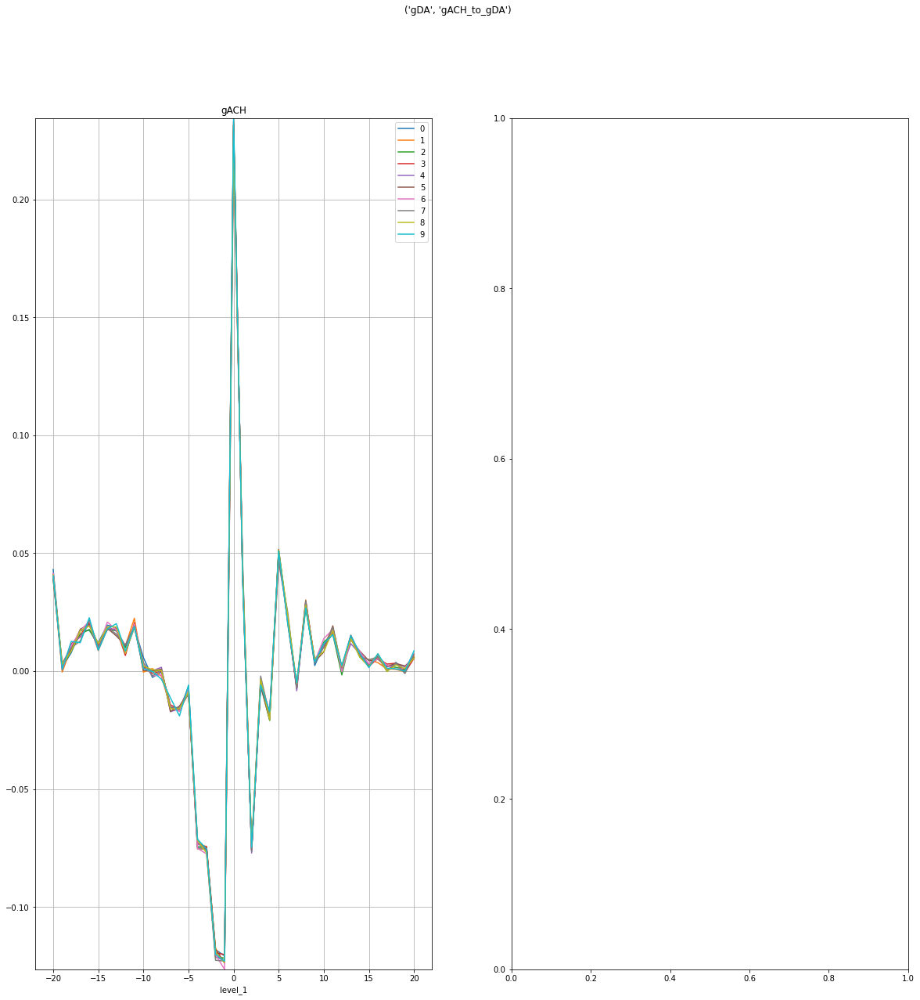

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.025526   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.022304   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.023466   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.022643   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.024566   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.021034   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.023744   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.022070   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.022590   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9  0.023465   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0 -0.002440   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1 -0.005571   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2 -0.002831   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3 -0.002141   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4 -0.004334   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5 -0.002153   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6 -0.003249   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7 -0.000441   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8 -0.001539   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__9 -0.003756   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_1_base_simple_gACH_to_gDA_run_num__0  0.002219   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__1  0.004886   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__2  0.003490   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__3  0.005695   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__4  0.006653   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__5  0.003674   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__6  0.005727   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__7  0.004606   
                                                   /gDA_1_1_base_simple_gACH_to_gDA_run_num__8  0.0026

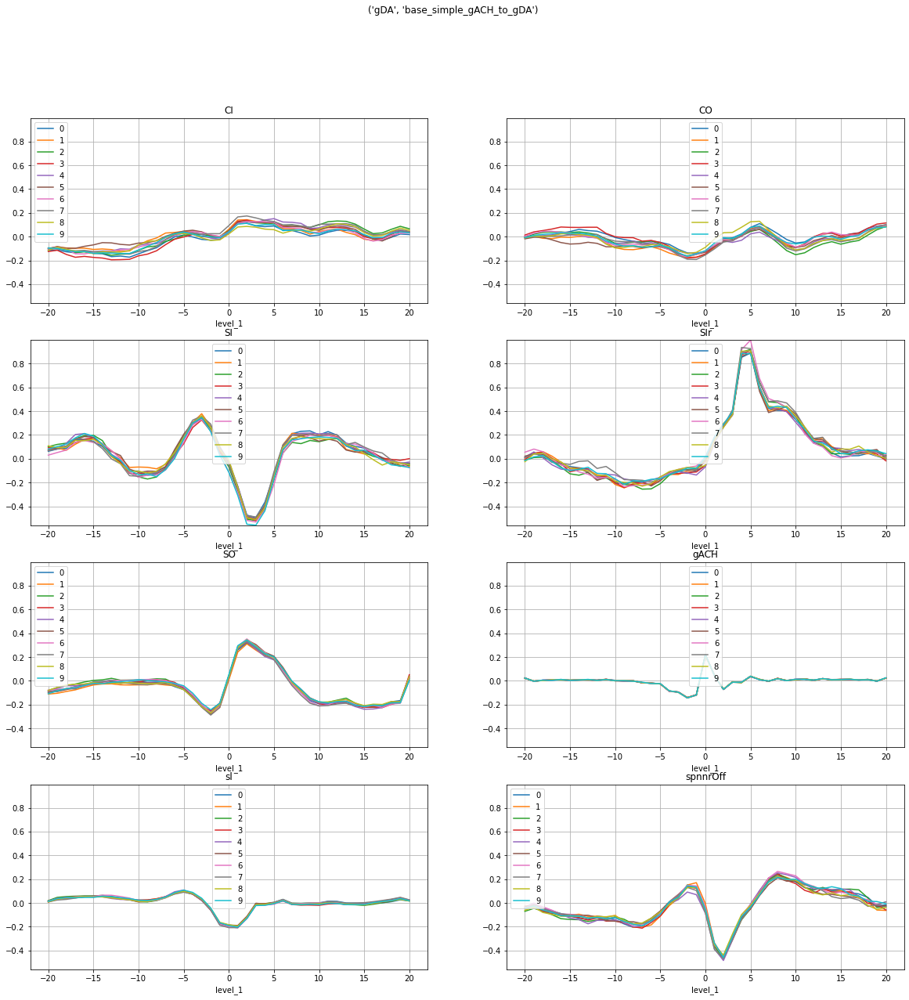

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.026072   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.022891   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.023901   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.023273   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.025065   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.021561   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.024168   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.022594   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.023197   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9  0.023951   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0 -0.002183   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1 -0.005389   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2 -0.002536   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3 -0.002062   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4 -0.004186   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5 -0.002170   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6 -0.003181   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7 -0.000302   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8 -0.001523   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__9 -0.003524   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_2_base_words_gACH_to_gDA_run_num__0  0.002513   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__1  0.004964   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__2  0.003738   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__3  0.005862   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__4  0.006681   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__5  0.003782   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__6  0.005977   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__7  0.004735   
                                                   /gDA_1_2_base_words_gACH_to_gDA_run_num__8  0.002822   
                               

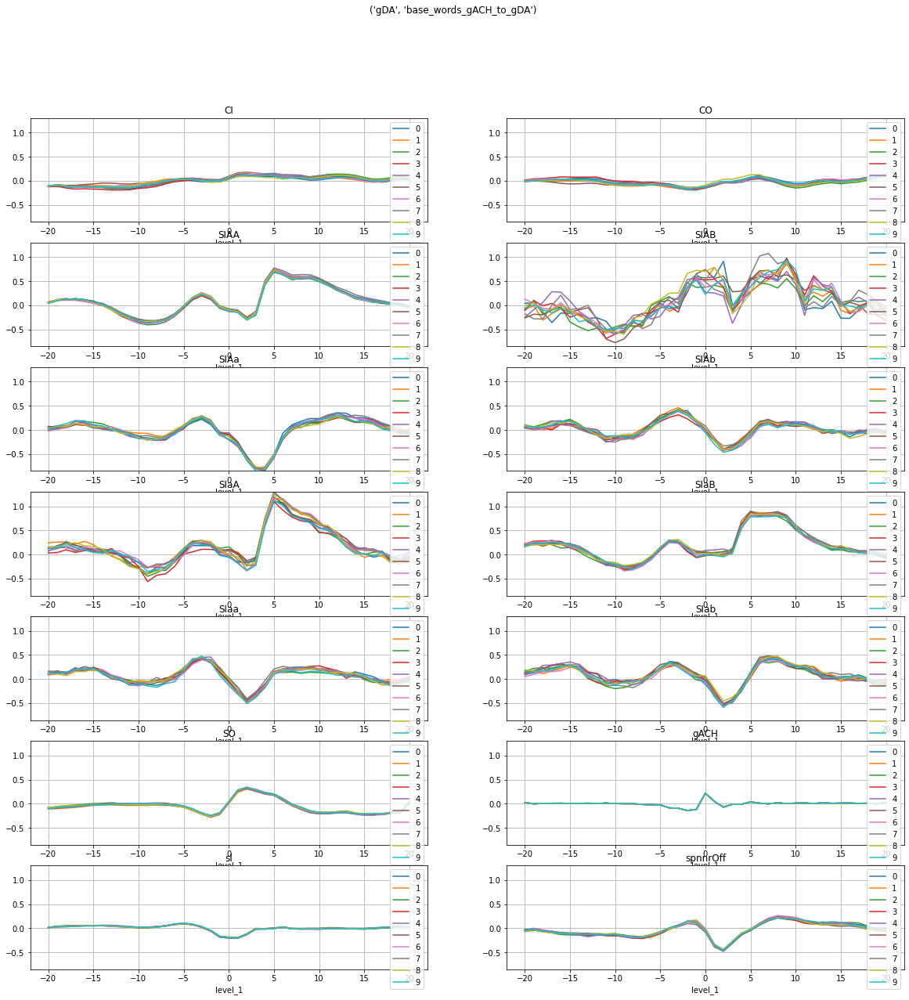

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.093104   
                                                   /gDA_1_3_base_simple_run_num__1 -0.085463   
                                                   /gDA_1_3_base_simple_run_num__2 -0.067561   
                                                   /gDA_1_3_base_simple_run_num__3 -0.103885   
                                                   /gDA_1_3_base_simple_run_num__4 -0.090808   
                                                   /gDA_1_3_base_simple_run_num__5 -0.080728   
                                                   /gDA_1_3_base_simple_run_num__6 -0.072951   
                                                   /gDA_1_3_base_simple_run_num__7 -0.069501   
                                                   /gDA_1_3_base_simple_run_num__8 -0.091111   
                                                   /gDA_1_3_base_simple_run_num__9 -0.069549   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.119488   
                                                   /gDA_1_3_base_simple_run_num__1 -0.099268   
                                                   /gDA_1_3_base_simple_run_num__2 -0.096015   
                                                   /gDA_1_3_base_simple_run_num__3 -0.116661   
                                                   /gDA_1_3_base_simple_run_num__4 -0.106225   
                                                   /gDA_1_3_base_simple_run_num__5 -0.086174   
                                                   /gDA_1_3_base_simple_run_num__6 -0.098649   
                                                   /gDA_1_3_base_simple_run_num__7 -0.104234   
                                                   /gDA_1_3_base_simple_run_num__8 -0.088954   
                                                   /gDA_1_3_base_simple_run_num__9 -0.099264   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_3_base_simple_run_num__0 -0.137798   
                                                   /gDA_1_3_base_simple_run_num__1 -0.114643   
                                                   /gDA_1_3_base_simple_run_num__2 -0.118593   
                                                   /gDA_1_3_base_simple_run_num__3 -0.151389   
                                                   /gDA_1_3_base_simple_run_num__4 -0.124809   
                                                   /gDA_1_3_base_simple_run_num__5 -0.099085   
                                                   /gDA_1_3_base_simple_run_num__6 -0.121992   
                                                   /gDA_1_3_base_simple_run_num__7 -0.124231   
                                                   /gDA_1_3_base_simple_run_num__8 -0.109810   
                                                   /gDA_1_3_base_simple_run_num__9 -0.118481   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA

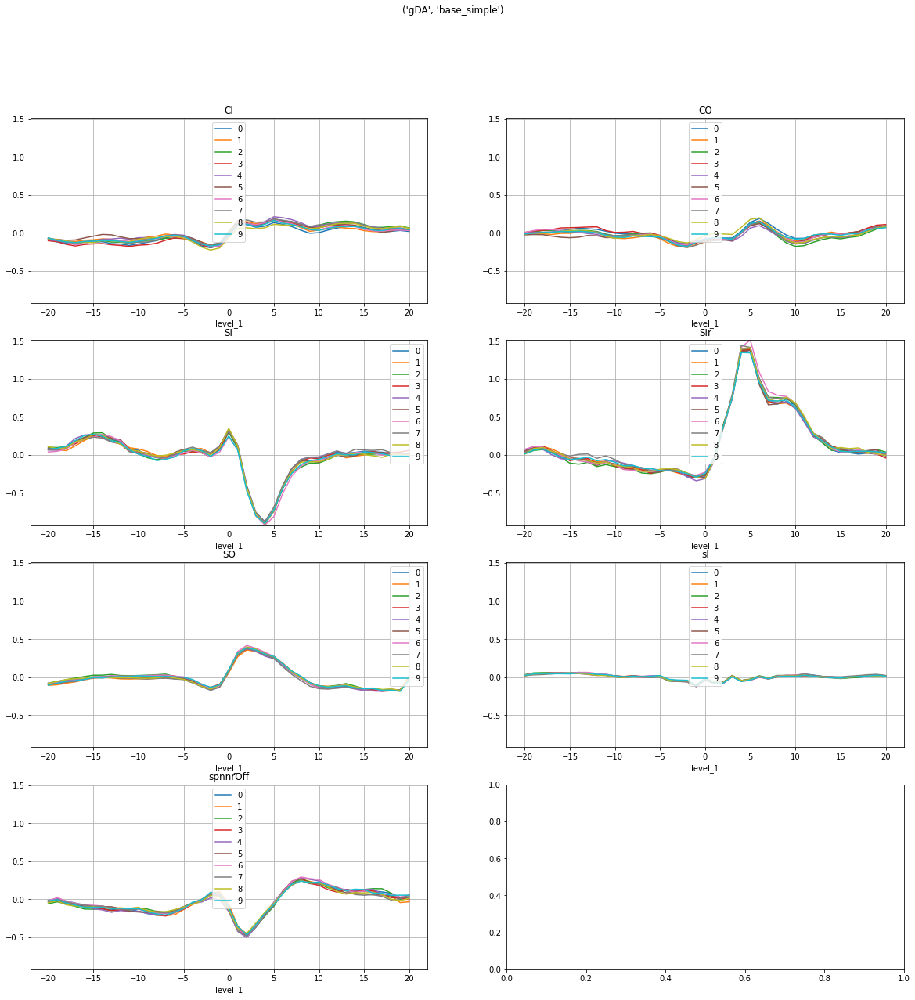

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.094704   
                                                   /gDA_1_4_base_words_run_num__1 -0.086751   
                                                   /gDA_1_4_base_words_run_num__2 -0.068650   
                                                   /gDA_1_4_base_words_run_num__3 -0.105059   
                                                   /gDA_1_4_base_words_run_num__4 -0.091049   
                                                   /gDA_1_4_base_words_run_num__5 -0.081663   
                                                   /gDA_1_4_base_words_run_num__6 -0.074867   
                                                   /gDA_1_4_base_words_run_num__7 -0.070442   
                                                   /gDA_1_4_base_words_run_num__8 -0.092732   
                                                   /gDA_1_4_base_words_run_num__9 -0.070407   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.119525   
                                                   /gDA_1_4_base_words_run_num__1 -0.099398   
                                                   /gDA_1_4_base_words_run_num__2 -0.096378   
                                                   /gDA_1_4_base_words_run_num__3 -0.117277   
                                                   /gDA_1_4_base_words_run_num__4 -0.105117   
                                                   /gDA_1_4_base_words_run_num__5 -0.085072   
                                                   /gDA_1_4_base_words_run_num__6 -0.099174   
                                                   /gDA_1_4_base_words_run_num__7 -0.104112   
                                                   /gDA_1_4_base_words_run_num__8 -0.089689   
                                                   /gDA_1_4_base_words_run_num__9 -0.098964   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.136846   
                                                   /gDA_1_4_base_words_run_num__1 -0.113627   
                                                   /gDA_1_4_base_words_run_num__2 -0.118012   
                                                   /gDA_1_4_base_words_run_num__3 -0.151450   
                                                   /gDA_1_4_base_words_run_num__4 -0.122794   
                                                   /gDA_1_4_base_words_run_num__5 -0.096529   
                                                   /gDA_1_4_base_words_run_num__6 -0.121447   
                                                   /gDA_1_4_base_words_run_num__7 -0.122972   
                                                   /gDA_1_4_base_words_run_num__8 -0.109756   
                                                   /gDA_1_4_base_words_run_num__9 -0.117311   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /gDA_1_4_base_words_run_num__0 -0.144573   
 

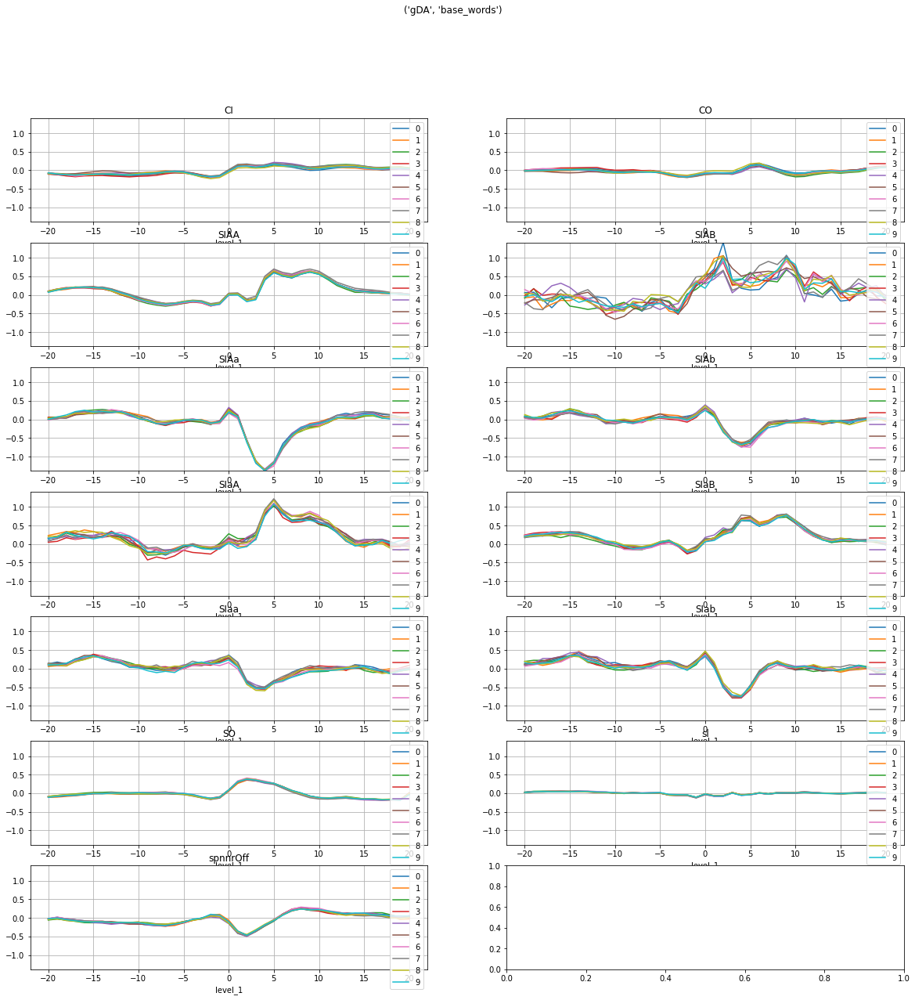

gACH  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.042611   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.039932   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.041057   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.041780   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.041508   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.040291   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.041367   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.039739   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.041011   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.040467   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0 -0.002497   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.001137   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2 -0.000067   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3 -0.002975   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4 -0.002417   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.000245   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6 -0.001471   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7 -0.000580   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8 -0.003084   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9 -0.000376   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_0_gACH_to_rDA_run_num__0  0.014147   
                                                   /rDA_2_0_gACH_to_rDA_run_num__1  0.011739   
                                                   /rDA_2_0_gACH_to_rDA_run_num__2  0.013559   
                                                   /rDA_2_0_gACH_to_rDA_run_num__3  0.014695   
                                                   /rDA_2_0_gACH_to_rDA_run_num__4  0.014101   
                                                   /rDA_2_0_gACH_to_rDA_run_num__5  0.012701   
                                                   /rDA_2_0_gACH_to_rDA_run_num__6  0.013956   
                                                   /rDA_2_0_gACH_to_rDA_run_num__7  0.012606   
                                                   /rDA_2_0_gACH_to_rDA_run_num__8  0.014986   
                                                   /rDA_2_0_gACH_to_rDA_run_num__9  0.013045   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /r

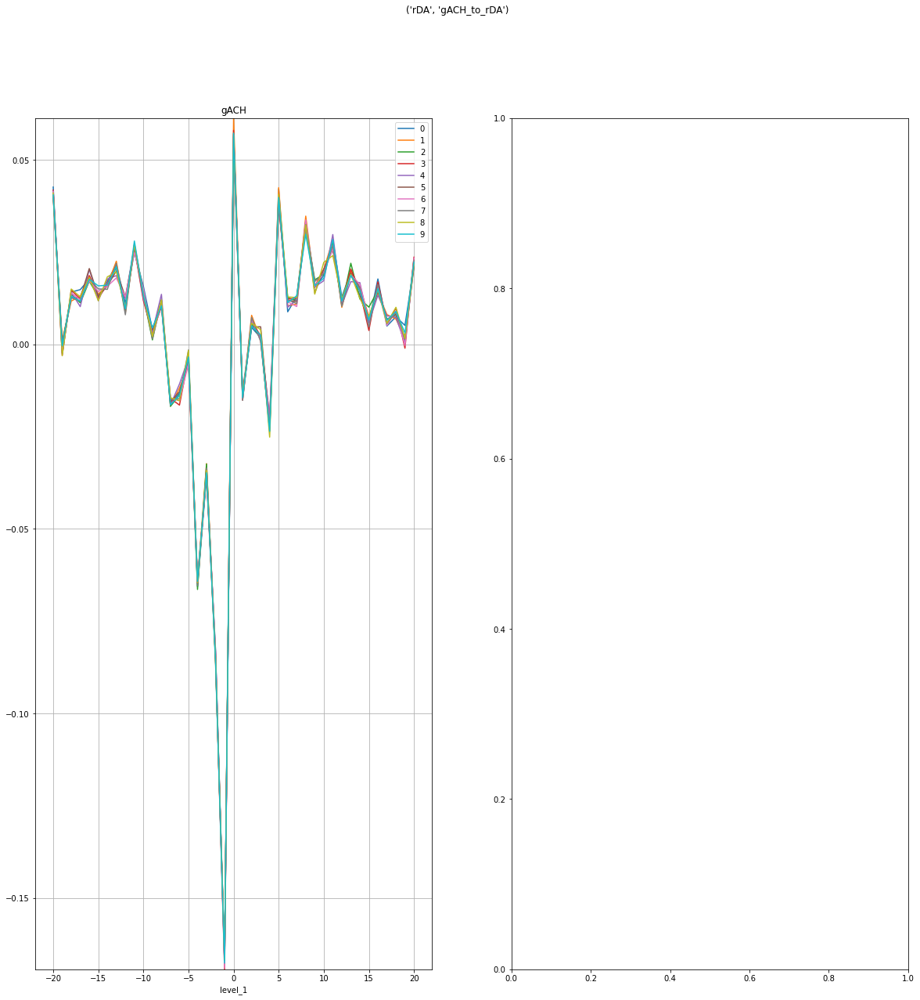

gACH  \
                                                                                                     -20   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.024179   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.021681   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.023605   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.023860   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.023547   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.021259   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.022409   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.021915   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.022307   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9  0.021732   

                                                                                                          \
                                                                                                     -19   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0 -0.003427   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.000079   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2 -0.001135   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3 -0.004738   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4 -0.003306   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5 -0.001390   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6 -0.001730   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7 -0.002073   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8 -0.003979   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__9 -0.000888   

                                                                                                          \
                                                                                                     -18   
fn                                                 key                                                     
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_1_base_simple_gACH_to_rDA_run_num__0  0.009360   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__1  0.006287   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__2  0.008225   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__3  0.009254   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__4  0.007164   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__5  0.007054   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__6  0.008176   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__7  0.007738   
                                                   /rDA_2_1_base_simple_gACH_to_rDA_run_num__8  0.0090

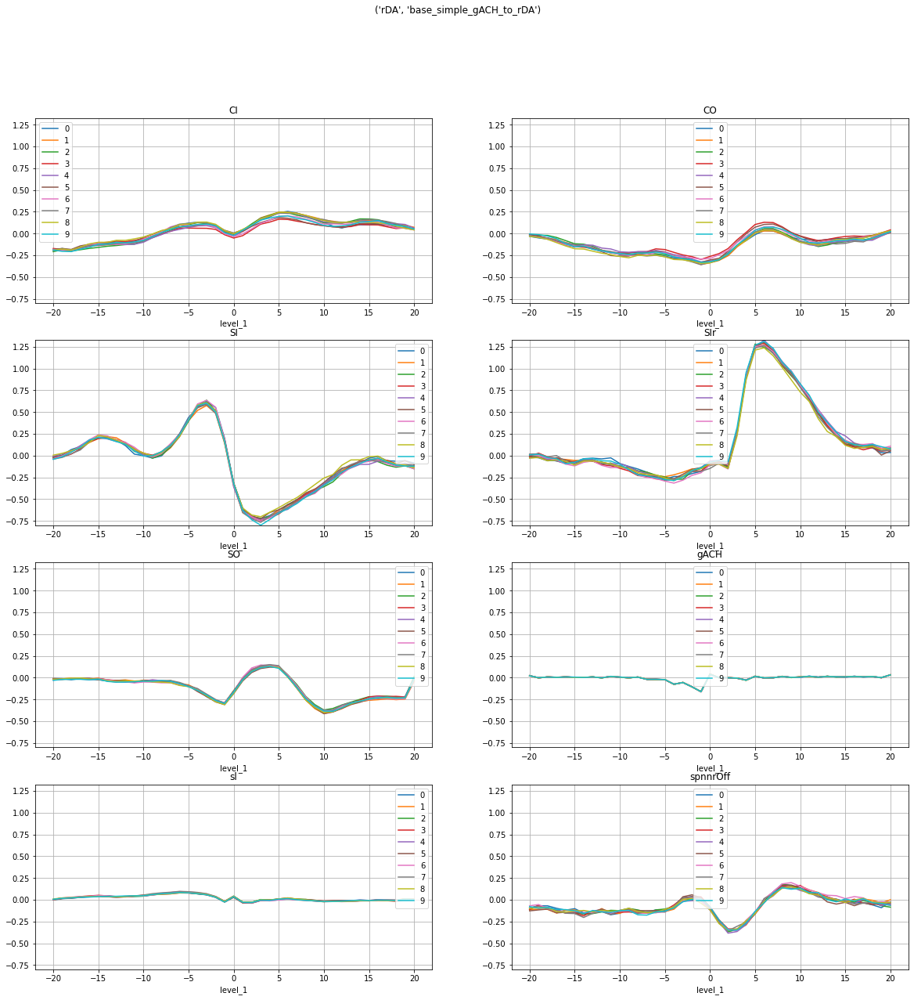

gACH  \
                                                                                                    -20   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.024527   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.022464   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.024337   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.024479   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.024145   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.021903   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.023150   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.022752   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.022770   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9  0.022629   

                                                                                                         \
                                                                                                    -19   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0 -0.003084   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.000384   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2 -0.000915   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3 -0.004501   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4 -0.003124   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5 -0.001057   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6 -0.001569   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7 -0.001862   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8 -0.003731   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__9 -0.000653   

                                                                                                         \
                                                                                                    -18   
fn                                                 key                                                    
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_2_base_words_gACH_to_rDA_run_num__0  0.009635   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__1  0.006627   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__2  0.008600   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__3  0.009541   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__4  0.007490   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__5  0.007381   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__6  0.008599   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__7  0.008047   
                                                   /rDA_2_2_base_words_gACH_to_rDA_run_num__8  0.009478   
                               

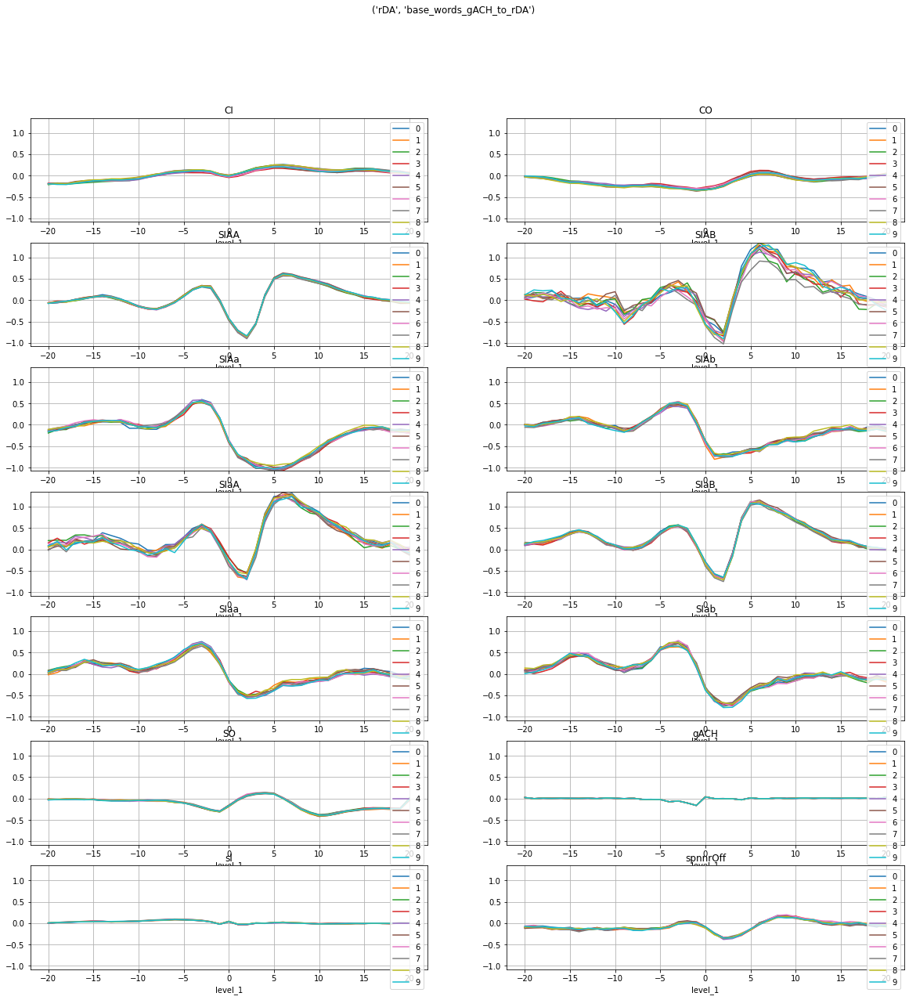

CI  \
                                                                                         -20   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.162781   
                                                   /rDA_2_3_base_simple_run_num__1 -0.154277   
                                                   /rDA_2_3_base_simple_run_num__2 -0.177847   
                                                   /rDA_2_3_base_simple_run_num__3 -0.139396   
                                                   /rDA_2_3_base_simple_run_num__4 -0.156862   
                                                   /rDA_2_3_base_simple_run_num__5 -0.154123   
                                                   /rDA_2_3_base_simple_run_num__6 -0.145753   
                                                   /rDA_2_3_base_simple_run_num__7 -0.162920   
                                                   /rDA_2_3_base_simple_run_num__8 -0.160813   
                                                   /rDA_2_3_base_simple_run_num__9 -0.160227   

                                                                                              \
                                                                                         -19   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.148856   
                                                   /rDA_2_3_base_simple_run_num__1 -0.168689   
                                                   /rDA_2_3_base_simple_run_num__2 -0.167972   
                                                   /rDA_2_3_base_simple_run_num__3 -0.153008   
                                                   /rDA_2_3_base_simple_run_num__4 -0.163689   
                                                   /rDA_2_3_base_simple_run_num__5 -0.146816   
                                                   /rDA_2_3_base_simple_run_num__6 -0.164857   
                                                   /rDA_2_3_base_simple_run_num__7 -0.157808   
                                                   /rDA_2_3_base_simple_run_num__8 -0.155316   
                                                   /rDA_2_3_base_simple_run_num__9 -0.184559   

                                                                                              \
                                                                                         -18   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_3_base_simple_run_num__0 -0.179334   
                                                   /rDA_2_3_base_simple_run_num__1 -0.184668   
                                                   /rDA_2_3_base_simple_run_num__2 -0.190406   
                                                   /rDA_2_3_base_simple_run_num__3 -0.162403   
                                                   /rDA_2_3_base_simple_run_num__4 -0.177956   
                                                   /rDA_2_3_base_simple_run_num__5 -0.162955   
                                                   /rDA_2_3_base_simple_run_num__6 -0.171400   
                                                   /rDA_2_3_base_simple_run_num__7 -0.170299   
                                                   /rDA_2_3_base_simple_run_num__8 -0.173856   
                                                   /rDA_2_3_base_simple_run_num__9 -0.198087   

                                                                                              \
                                                                                         -17   
fn                                                 key                                         
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA

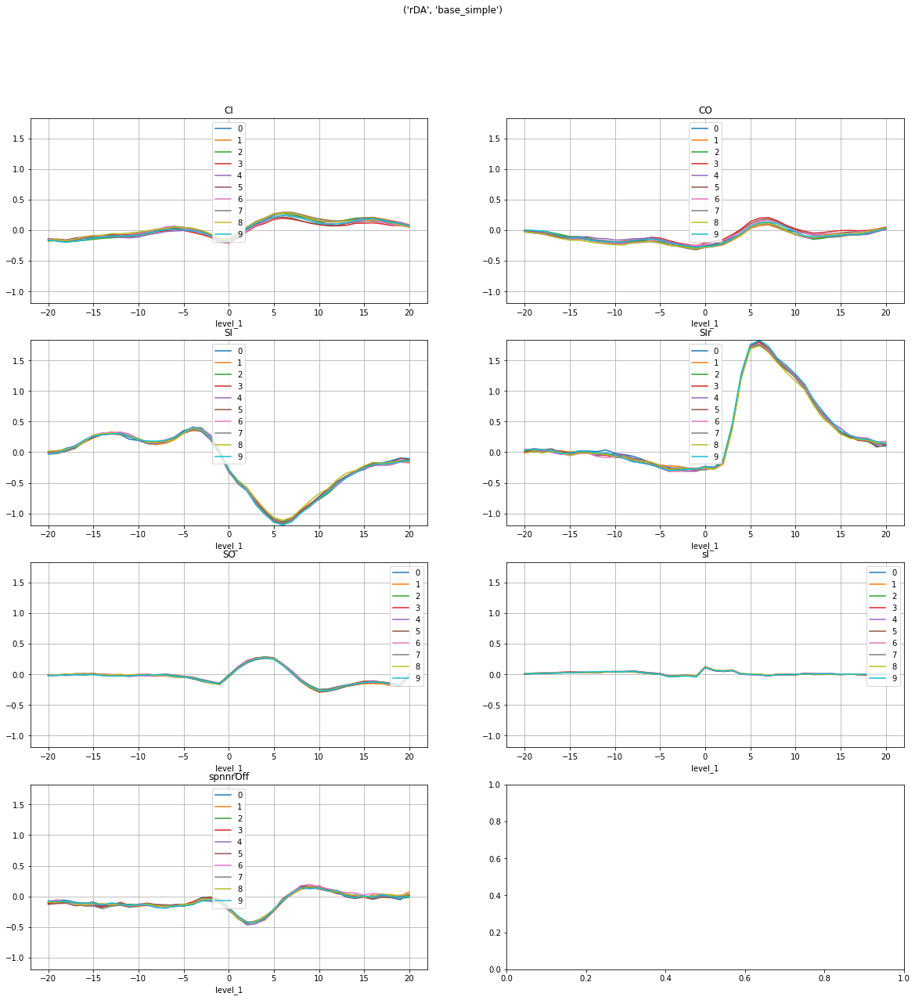

CI  \
                                                                                        -20   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.163295   
                                                   /rDA_2_4_base_words_run_num__1 -0.155391   
                                                   /rDA_2_4_base_words_run_num__2 -0.178735   
                                                   /rDA_2_4_base_words_run_num__3 -0.140106   
                                                   /rDA_2_4_base_words_run_num__4 -0.156945   
                                                   /rDA_2_4_base_words_run_num__5 -0.154792   
                                                   /rDA_2_4_base_words_run_num__6 -0.147117   
                                                   /rDA_2_4_base_words_run_num__7 -0.161975   
                                                   /rDA_2_4_base_words_run_num__8 -0.162519   
                                                   /rDA_2_4_base_words_run_num__9 -0.160842   

                                                                                             \
                                                                                        -19   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.146402   
                                                   /rDA_2_4_base_words_run_num__1 -0.167039   
                                                   /rDA_2_4_base_words_run_num__2 -0.166690   
                                                   /rDA_2_4_base_words_run_num__3 -0.151892   
                                                   /rDA_2_4_base_words_run_num__4 -0.162273   
                                                   /rDA_2_4_base_words_run_num__5 -0.143958   
                                                   /rDA_2_4_base_words_run_num__6 -0.164344   
                                                   /rDA_2_4_base_words_run_num__7 -0.153168   
                                                   /rDA_2_4_base_words_run_num__8 -0.154516   
                                                   /rDA_2_4_base_words_run_num__9 -0.183700   

                                                                                             \
                                                                                        -18   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.175599   
                                                   /rDA_2_4_base_words_run_num__1 -0.181777   
                                                   /rDA_2_4_base_words_run_num__2 -0.188308   
                                                   /rDA_2_4_base_words_run_num__3 -0.160612   
                                                   /rDA_2_4_base_words_run_num__4 -0.175391   
                                                   /rDA_2_4_base_words_run_num__5 -0.158191   
                                                   /rDA_2_4_base_words_run_num__6 -0.170306   
                                                   /rDA_2_4_base_words_run_num__7 -0.162778   
                                                   /rDA_2_4_base_words_run_num__8 -0.172023   
                                                   /rDA_2_4_base_words_run_num__9 -0.196419   

                                                                                             \
                                                                                        -17   
fn                                                 key                                        
C:\Users\Josh\Documents\GitHub\sabatinilab-glm\... /rDA_2_4_base_words_run_num__0 -0.146991   
 

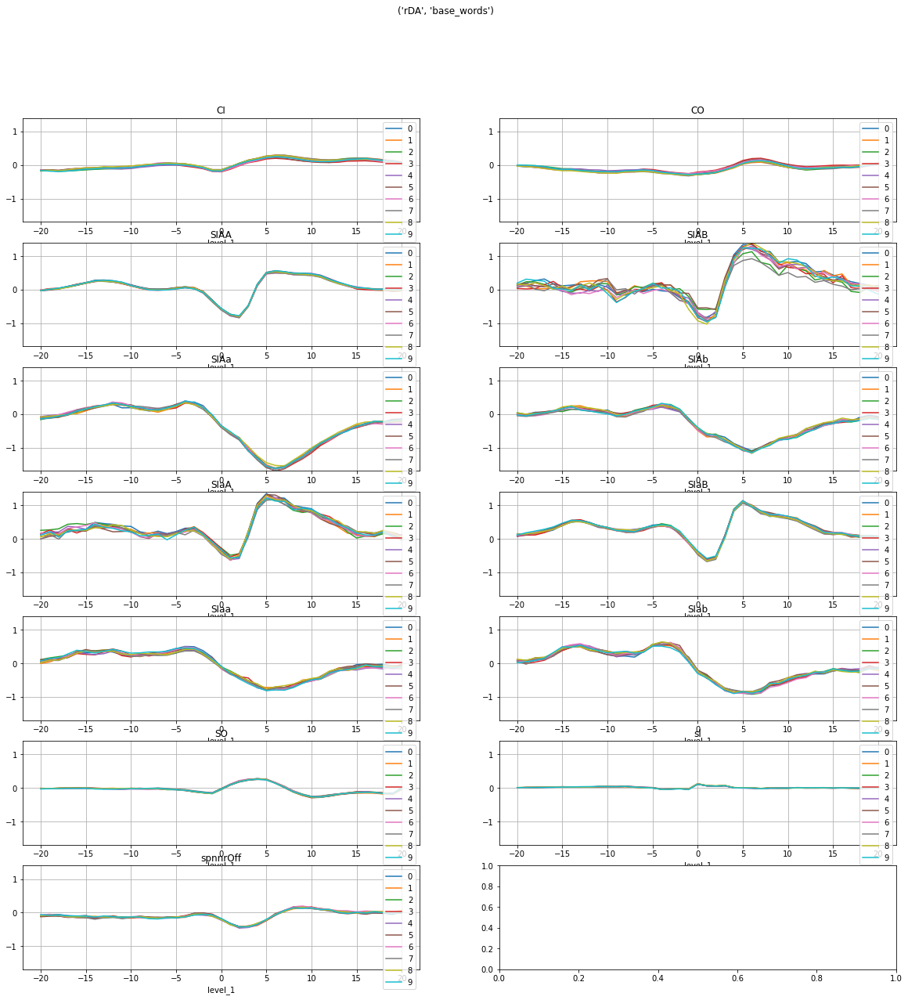

In [81]:
h5_lst = defaultdict(list)
run_id_dct = defaultdict(list)

# base_location = Path(r'/Users/josh/Documents/Harvard/GLM/sabatinilab-glm/sglm/outputs')
base_location = Path(r'C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs')

fig_folder_lst = [('Figure_1_2', 'f1*-ft'),
                  ('Figure_3',   'f3*-ft'),
                  ('Figure_4_g1',   'f4*-ft'),
                  ('Figure_4_g2',   'f4*-ft'),
                  ('Figure_5_g1',   'f5*-ft'),
                  ('Figure_5_g2',   'f5*-ft'),
                  ('Figure_5_g5',   'f5*-ft'),
                 ]

for fig_folder in fig_folder_lst:
    print('fig_folder', fig_folder)
    
    load_folder = base_location / Path(fig_folder[0])
    # load_folder = base_location / Path(r'tmp')
    h5_beta_locations = str((load_folder / Path('all') / Path(fig_folder[1]) / Path(r'coefs\*_best_coeffs.h5')).resolve())
    
    print(h5_beta_locations)
    


#     base_location = Path(r'C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs')

#     load_folder = base_location / Path(r'Figure_1_2')
#     h5_beta_locations = str((load_folder / Path(r'all\f1*-ft\coefs\*_best_coeffs.h5')).resolve())
#     # load_folder = base_location / Path(r'Figure_3')
#     # h5_beta_locations = str((load_folder / Path(r'all\f3*-ft\coefs\*_best_coeffs.h5')).resolve())
#     # load_folder = base_location / Path(r'Figure_4_g1')
#     # h5_beta_locations = str((load_folder / Path(r'all\f4*-ft\coefs\*_best_coeffs.h5')).resolve())
#     # load_folder = base_location / Path(r'Figure_4_g2')
#     # h5_beta_locations = str((load_folder / Path(r'all\f4*-ft\coefs\*_best_coeffs.h5')).resolve())
#     # load_folder = base_location / Path(r'Figure_5_g1')
#     # h5_beta_locations = str((load_folder / Path(r'all\f5*-ft\coefs\*_best_coeffs.h5')).resolve())
#     # load_folder = base_location / Path(r'Figure_5_g2')
#     # h5_beta_locations = str((load_folder / Path(r'all\f5*-ft\coefs\*_best_coeffs.h5')).resolve())

#     out_folder = base_location / Path(r'final_outputs')

#     # h5_beta_locations = Path('/Users/josh/Dropbox (HMS)/jz/Tetanus/1194_1195_1214_1258_1259_2_best_coeffs.h5')
#     out_loc = str((out_folder).resolve())
#     h5_beta_locations = glob.glob(h5_beta_locations)


    out_folder = base_location / Path(r'final_outputs')

    out_loc = str((out_folder).resolve())
    h5_beta_locations = glob.glob(h5_beta_locations)


    h5_lst = defaultdict(list)
    for h5_coef_fn in h5_beta_locations:
        h5f = pd.HDFStore(h5_coef_fn)
        h5fk = h5f.keys()
        for key in h5fk:
#             print(key)
            resp = key.split('_')[0].replace('/', '')
            model_version = '_'.join(key.split('_')[3:]).split('_run_num')[0]
    #         print(resp, model_version)
            h5_df = pd.read_hdf(h5f, key).reset_index()
            h5_df['fn'] = h5_coef_fn
            h5_df['key'] = key
            h5_df = h5_df.set_index(['fn','key'])


            h5_df = h5_df.sort_values('channel_name')
            h5_df['channel'] = h5_df['channel_name'].str.split('_').apply(lambda x: x[0])
            h5_df['run_num'] = h5_df['channel_name'].str.split('_').apply(lambda x: x[-1])

            h5_lst[(resp, model_version)].append(h5_df)
    #         h5_lst.append(h5_df)
    # concat = pd.concat(h5_lst, axis=0)

    fh.create_folder_if_not_exists(out_loc)



    a = None
    b = None

    h5_dfs = dict(h5_lst)
    for key in h5_dfs:
        run_major = '='.join(key)

        cont = True
        for runmajor in used_run_majors:
            if runmajor in run_major:
                cont = False
        if cont:
            continue

        val = h5_dfs[key]
        concat = pd.concat(val)

        all_kernels = []
        for base_key in base_keys:
            all_kernels += dfh.get_kernel_from_basename(base_key, list(concat.columns))


        gb_columns = ['mouse_id', 'channel', 'name']
        ak_unagg = concat.reset_index().set_index(['mouse_id', 'channel', 'name', 'run_num'])[all_kernels]

        ak_unagg.to_csv(str((Path(out_loc) / f'{load_folder.parts[-1]}-kernels_raw-{run_major}.csv').resolve()))

        kernels = ak_unagg.groupby(gb_columns).agg([np.mean, np.size, np.std])
        kernels = kernels.swaplevel(axis=1)

        ak = concat[all_kernels].copy()
        new_cols = [(dfh.shorten_col_name(_.split('_')[0]), int(_.split('_')[1])) for _ in ak.columns]



        ak.columns = pd.MultiIndex.from_tuples(new_cols)
        
        
        display(ak)
#         fig,ax=plt.subplots(1,1,figsize=(10,10))
        pak = ak.droplevel(0).T
        pak.columns = [_.split('_')[-1] for _ in pak.columns]
        
        gpak = pak.reset_index().set_index('level_1').groupby('level_0')
        fig, axes = plt.subplots(int(np.ceil(len(gpak)/2)),2,figsize=(20,20))
        fig.suptitle(key)
        mn_y, mx_y = np.inf, -np.inf
        for ig, (kg, grp) in enumerate(gpak):
            if len(axes.shape) == 2:
                ax = axes[ig//2, ig%2]
            else:
                ax = axes[ig]
            
            grp = grp.drop('level_0', axis=1)
            mn_y = mn_y if mn_y < np.min(grp.values) else np.min(grp.values)
            mx_y = mx_y if mx_y > np.max(grp.values) else np.max(grp.values)
            
            
            grp.plot(ax=ax)
            ax.set_title(kg)
            ax.grid(True)
#             if ig == len(gpak)-1:
#                 ax.legend()
        
        for ig in range(len(gpak)):
            if len(axes.shape) == 2:
                ax = axes[ig//2, ig%2]
            else:
                ax = axes[ig]
            ax.set_ylim(mn_y, mx_y)
        plt.show()
#         break
#     break

In [67]:

mn_y = mn_y if mn_y < np.min(grp.values) else np.min(grp.values)
mn_y = mx_y if mx_y > np.max(grp.values) else np.max(grp.values)

mn_y, np.min(grp.values), mx_y, np.max(grp.values)

for ig, (kg, grp) in enumerate(gpak):
    print(ig, kg, grp)

np.min(grp.drop('level_0', axis=1).values)

(0.7059572381234125, -0.29695120433629646, -inf, 0.7059572381234125)

In [ ]:
fig_str_lst = ['Figure_1_2', 'Figure_3', 'Figure_4_g1', 'Figure_4_g2', 'Figure_5_g1', 'Figure_5_g2', 'Figure_5_g5']
y_col_lst = ['gACH', 'gDA', 'rDA']
modl_lst_base = ['base_simple', 'base_words']

modl_btw_chls = ['gDA_to_gACH', 'rDA_to_gACH', 'gACH_to_gDA', 'gACH_to_rDA']
modl_btw_chls_smpl = [f'base_simple_{_}' for _ in modl_btw_chls]
modl_btw_chls_wrds = [f'base_words_{_}' for _ in modl_btw_chls]

# dr_in = Path(r'/Users/josh/Downloads/final_outputs')
# dr_out = Path(r'/Users/josh/Desktop/output_fig_folder')

dr_in = Path(r'C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\final_outputs')
dr_out = Path(r'C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\final_outputs_krn_fig_folder')

fh.create_folder_if_not_exists(str(dr_out.resolve()))

for fig_str in fig_str_lst:
    for y_col in y_col_lst:
        
        if fig_str == 'Figure_3':
            modl_lst = modl_btw_chls + modl_lst_base + modl_btw_chls_smpl + modl_btw_chls_wrds
        else:
            modl_lst = modl_lst_base
        
        fig_lst = []

        max_y = -np.inf
        min_y = np.inf

        for im, modl in enumerate(modl_lst):
            file_name = f'{fig_str}-kernels-{y_col}={modl}.csv'
            file_loc = str((dr_in / file_name).resolve())
            try:
                rdf = pd.read_csv(file_loc, index_col=0)
            except Exception as e:
                print(e)
                continue
#             display(rdf)
#             print(list(rdf.columns))

            has_col_lst = (list(set([_.split('_')[0] for _ in rdf.columns])))
            base_alignment_lst_use = [_ for _ in base_alignment_lst if _ in has_col_lst]
#             print(base_alignment_lst)

            fig, axes = plt.subplots(int(np.ceil(len(base_alignment_lst_use)/2)), 2, figsize=(10,20))
            fig_name = f'{fig_str}-{y_col}-{str(im).zfill(2)}-{modl}'
            
            fig_lst.append((fig, axes, fig_name))
            
            fig.suptitle(f'{fig_name}')
            fig.set_facecolor('w')
            
            for iba, base_alignment in enumerate(base_alignment_lst_use):
                ax = axes[iba//2, iba%2]
                
                if f'{base_alignment}_mean' not in rdf.columns:
                    rdf[f'{base_alignment}_mean'] = np.nan
                    rdf[f'{base_alignment}_std'] = np.nan
                    rdf[f'{base_alignment}_size'] = np.nan
                
                rdf[f'{base_alignment}_lb'] = rdf[f'{base_alignment}_mean'] - 1.96*rdf[f'{base_alignment}_std']/np.sqrt(rdf[f'{base_alignment}_size'])
                rdf[f'{base_alignment}_ub'] = rdf[f'{base_alignment}_mean'] + 1.96*rdf[f'{base_alignment}_std']/np.sqrt(rdf[f'{base_alignment}_size'])
                
                tmp_mx_y = rdf[f'{base_alignment}_ub'].max()
                tmp_mn_y = rdf[f'{base_alignment}_lb'].min()
                max_y, min_y, _, _ = update_max_min(max_y, min_y, tmp_mx_y, tmp_mn_y)

                ax.plot(rdf.index, rdf[f'{base_alignment}_mean'], label='True - mean')
                ax.fill_between(rdf.index, rdf[f'{base_alignment}_lb'], rdf[f'{base_alignment}_ub'], alpha=0.2, label='True - CI')

                ax.set_title(base_alignment)
                ax.grid(True)
                ax.legend()
#             break
#         break
#     break
        for fig, axes, fig_name in fig_lst:
            for ax in axes.reshape(-1):
                ax.set_ylim(min_y-0.05, max_y+0.05)
            
            fig.show()
#             fig.savefig(str((dr_out / (fig_name + '.png')).resolve()))
#             break
        break
    break
#             display(rdf)

In [7]:
# run_id_dct[y_col]

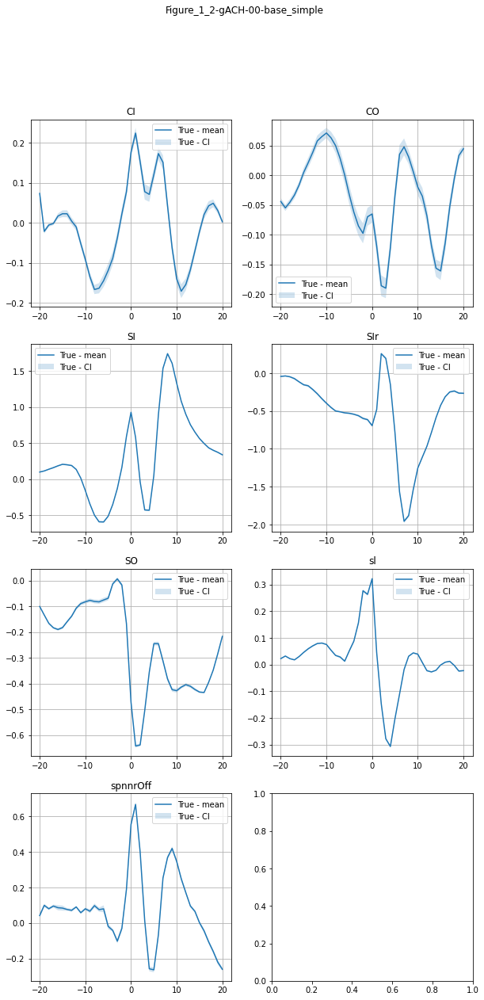

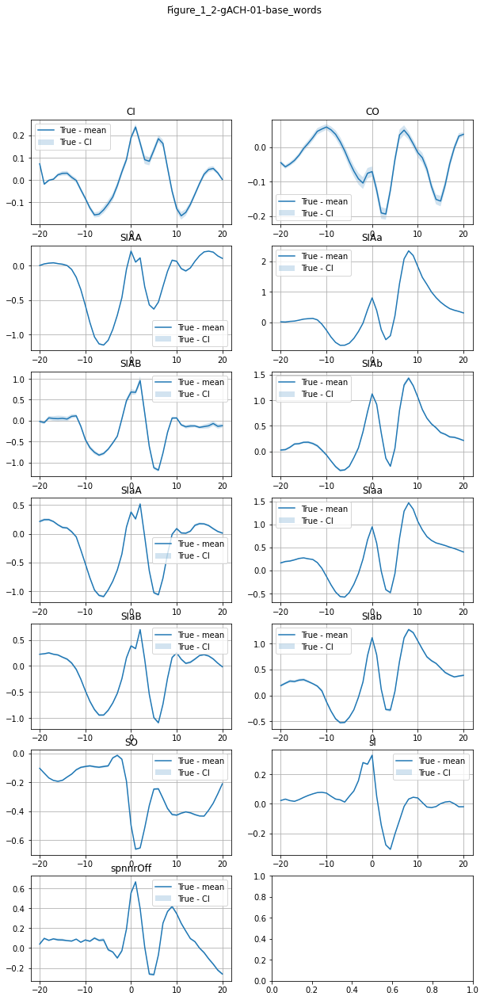

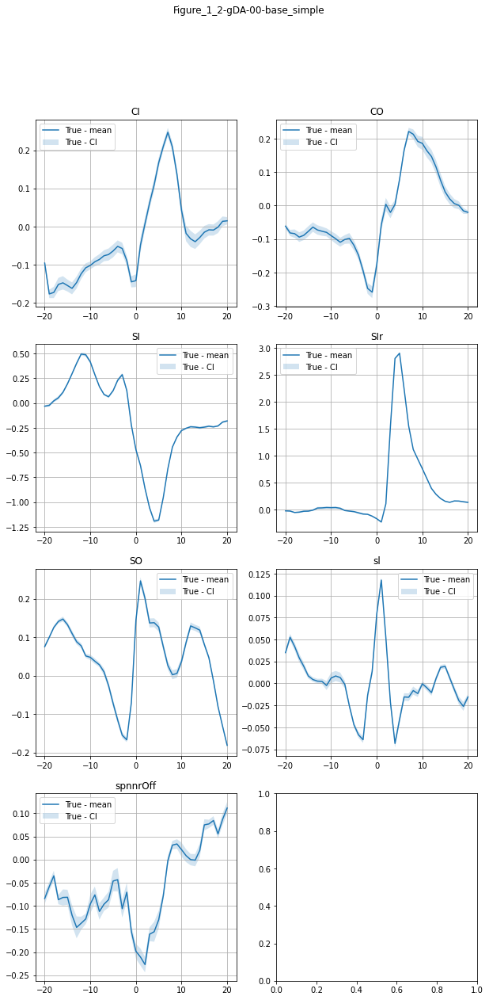

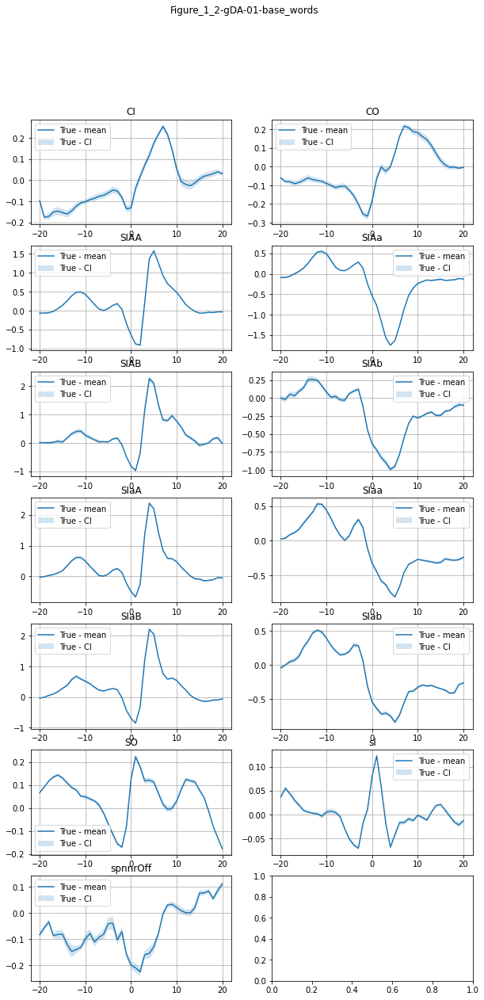

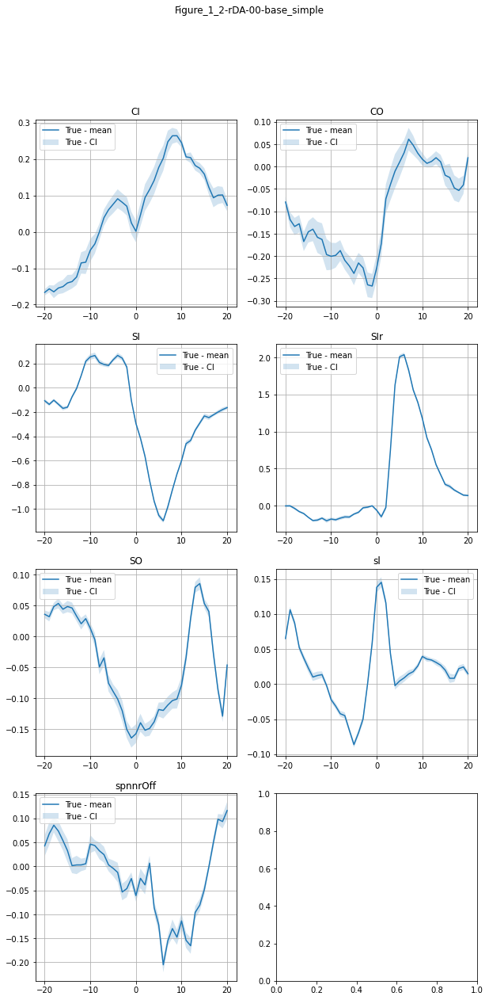

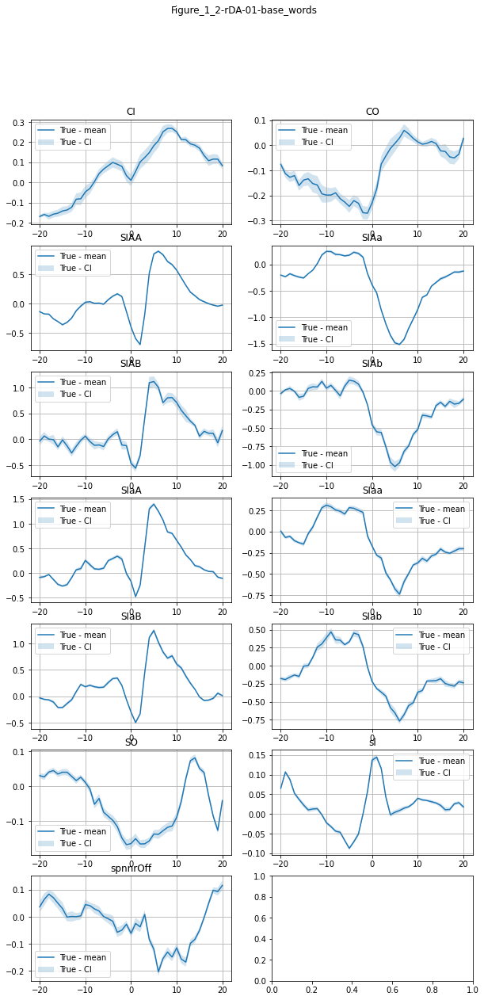

In [10]:
fig_str_lst = ['Figure_1_2']
y_col_lst = ['gACH', 'gDA', 'rDA']
modl_lst_base = ['base_simple', 'base_words']


# dr_in = Path(r'/Users/josh/Downloads/final_outputs')
# dr_out = Path(r'/Users/josh/Desktop/output_fig_folder')

dr_in = Path(r'C:\Users\Josh\Documents\GitHub\sabatinilab-glm\sglm\outputs\final_outputs')
dr_out = None


for fig_str in fig_str_lst:
    for y_col in y_col_lst:
        
        if fig_str == 'Figure_3':
            modl_lst = modl_btw_chls + modl_lst_base + modl_btw_chls_smpl + modl_btw_chls_wrds
        else:
            modl_lst = modl_lst_base
        
        fig_lst = []

        max_y = -np.inf
        min_y = np.inf

        for im, modl in enumerate(modl_lst):
            file_name = f'{fig_str}-kernels-{y_col}={modl}.csv'
            file_loc = str((dr_in / file_name).resolve())
            try:
                rdf = pd.read_csv(file_loc, index_col=0)
            except Exception as e:
                print(e)
                continue
#             display(rdf)
#             print(list(rdf.columns))

            has_col_lst = (list(set([_.split('_')[0] for _ in rdf.columns])))
            base_alignment_lst_use = [_ for _ in base_alignment_lst if _ in has_col_lst]
#             print(base_alignment_lst)

            fig, axes = plt.subplots(int(np.ceil(len(base_alignment_lst_use)/2)), 2, figsize=(10,20))
            fig_name = f'{fig_str}-{y_col}-{str(im).zfill(2)}-{modl}'
            
            fig_lst.append((fig, axes, fig_name))
            
            fig.suptitle(f'{fig_name}')
            fig.set_facecolor('w')
            
            for iba, base_alignment in enumerate(base_alignment_lst_use):
                ax = axes[iba//2, iba%2]
                
                if f'{base_alignment}_mean' not in rdf.columns:
                    rdf[f'{base_alignment}_mean'] = np.nan
                    rdf[f'{base_alignment}_std'] = np.nan
                    rdf[f'{base_alignment}_size'] = np.nan
                
                rdf[f'{base_alignment}_lb'] = rdf[f'{base_alignment}_mean'] - 1.96*rdf[f'{base_alignment}_std']/np.sqrt(rdf[f'{base_alignment}_size'])
                rdf[f'{base_alignment}_ub'] = rdf[f'{base_alignment}_mean'] + 1.96*rdf[f'{base_alignment}_std']/np.sqrt(rdf[f'{base_alignment}_size'])
                
                tmp_mx_y = rdf[f'{base_alignment}_ub'].max()
                tmp_mn_y = rdf[f'{base_alignment}_lb'].min()
                max_y, min_y, _, _ = update_max_min(max_y, min_y, tmp_mx_y, tmp_mn_y)

                ax.plot(rdf.index, rdf[f'{base_alignment}_mean'], label='True - mean')
                ax.fill_between(rdf.index, rdf[f'{base_alignment}_lb'], rdf[f'{base_alignment}_ub'], alpha=0.2, label='True - CI')

                ax.set_title(base_alignment)
                ax.grid(True)
                ax.legend()